# Single cell sequencing pipeline example (with Kallisto matrix agregation) USING UMIs

This notebook is a cleaner version of the reading of single cell sequencing data.

It includes reading from fastq files using Kalistro (for that the mouse index of genes is required).

We use Scanpy for quality control filtering of data and for basic analysis (such as dimensionality reduction and plotting).

Adata file format is used as a variable for all the notebook. 

We add information from other .txt files that were provided by SciLife lab regarding the real or kept cell barcodes and the mapping from the barcodes to the position in the well.

We use the information of the position in the well to define which cells were correponding to mock or different stimuli experiments, as well as to include the level of red and green fluorecence of those cells (from CAMPARI).

In [1]:
# This is  used to time the running of the notebook
import time
start_time = time.time()

In [2]:
%%time
!pip install -U loompy
!pip install --quiet matplotlib scikit-learn numpy scipy
!pip3 install --quiet leidenalg
!pip install --quiet louvain scanpy
# install kb
!pip install --quiet kb-python 

CPU times: user 89.9 ms, sys: 41.1 ms, total: 131 ms
Wall time: 9.33 s


In [3]:
### For comparing your sequencing with the already known genome you need to download the apropiate gene atlas
### Use kallisto to download mouse index here

!kb ref -d mouse -i index.idx -g t2g.txt

[2023-08-09 11:07:29,307]    INFO [download] Skipping download because some files already exist. Use the --overwrite flag to overwrite.


In [ ]:
###SAMPLE1

# This step runs `kb` to pseudoalign the reads, and then generate the cells x gene matrix in h5ad format.
### genrealal structure:
# index.idx and t2g.txt are files that were downloaded on the previous cell. They refer to the gene atlas
# -x is the input to the sequencing technique that was use. Kallisto supports multiple sequencing techniques
# (check kb --list for more information)
# SMARTSEQ3 is the method we used for this sequencing
# (this sequencing format requires 4 files to be processed togehter, to put all of them as inputs)
# --h4ad is the desired output format. If loom file is prefered, just changed it there. 
!kb count -i index.idx -g t2g.txt -x SMARTSEQ3 -o sample1 --h5ad\
/home/melma31/Documents/single_cell_sequencing/data/sample1/P28203_5007_S7_I1_001.fastq.gz \
/home/melma31/Documents/single_cell_sequencing/data/sample1/P28203_5007_S7_I2_001.fastq.gz \
/home/melma31/Documents/single_cell_sequencing/data/sample1/P28203_5007_S7_R1_001.fastq.gz \
/home/melma31/Documents/single_cell_sequencing/data/sample1/P28203_5007_S7_R2_001.fastq.gz 


In [4]:
###SAMPLE2
!kb count -i index.idx -g t2g.txt -x SMARTSEQ3 -o sample2 --h5ad\
/home/melma31/Documents/single_cell_sequencing/data/sample2/P28605_8001_S1_I1_001.fastq.gz \
/home/melma31/Documents/single_cell_sequencing/data/sample2/P28605_8001_S1_I2_001.fastq.gz \
/home/melma31/Documents/single_cell_sequencing/data/sample2/P28605_8001_S1_R1_001.fastq.gz \
/home/melma31/Documents/single_cell_sequencing/data/sample2/P28605_8001_S1_R2_001.fastq.gz 

[2023-08-09 11:07:34,654]    INFO [count_smartseq3] Using index index.idx to generate BUS file to sample2 from
[2023-08-09 11:07:34,654]    INFO [count_smartseq3]         /home/melma31/Documents/single_cell_sequencing/data/sample2/P28605_8001_S1_I1_001.fastq.gz
[2023-08-09 11:07:34,654]    INFO [count_smartseq3]         /home/melma31/Documents/single_cell_sequencing/data/sample2/P28605_8001_S1_I2_001.fastq.gz
[2023-08-09 11:07:34,654]    INFO [count_smartseq3]         /home/melma31/Documents/single_cell_sequencing/data/sample2/P28605_8001_S1_R1_001.fastq.gz
[2023-08-09 11:07:34,654]    INFO [count_smartseq3]         /home/melma31/Documents/single_cell_sequencing/data/sample2/P28605_8001_S1_R2_001.fastq.gz
[2023-08-09 11:21:07,523]    INFO [count_smartseq3] Sorting BUS file sample2/output.bus to sample2/tmp/output.s.bus
[2023-08-09 11:21:51,608]    INFO [count_smartseq3] Whitelist not provided
[2023-08-09 11:21:51,608]    INFO [count_smartseq3] Generating whitelist sample2/whitelist.txt

In [5]:
###SAMPLE3
!kb count -i index.idx -g t2g.txt -x SMARTSEQ3 -o sample3 --h5ad\
/home/melma31/Documents/single_cell_sequencing/data/sample3/P29058_6012_S12_I1_001.fastq.gz \
/home/melma31/Documents/single_cell_sequencing/data/sample3/P29058_6012_S12_I2_001.fastq.gz \
/home/melma31/Documents/single_cell_sequencing/data/sample3/P29058_6012_S12_R1_001.fastq.gz \
/home/melma31/Documents/single_cell_sequencing/data/sample3/P29058_6012_S12_R2_001.fastq.gz 

[2023-08-09 11:26:57,871]    INFO [count_smartseq3] Using index index.idx to generate BUS file to sample3 from
[2023-08-09 11:26:57,871]    INFO [count_smartseq3]         /home/melma31/Documents/single_cell_sequencing/data/sample3/P29058_6012_S12_I1_001.fastq.gz
[2023-08-09 11:26:57,871]    INFO [count_smartseq3]         /home/melma31/Documents/single_cell_sequencing/data/sample3/P29058_6012_S12_I2_001.fastq.gz
[2023-08-09 11:26:57,871]    INFO [count_smartseq3]         /home/melma31/Documents/single_cell_sequencing/data/sample3/P29058_6012_S12_R1_001.fastq.gz
[2023-08-09 11:26:57,871]    INFO [count_smartseq3]         /home/melma31/Documents/single_cell_sequencing/data/sample3/P29058_6012_S12_R2_001.fastq.gz
[2023-08-09 11:36:28,145]    INFO [count_smartseq3] Sorting BUS file sample3/output.bus to sample3/tmp/output.s.bus
[2023-08-09 11:36:51,491]    INFO [count_smartseq3] Whitelist not provided
[2023-08-09 11:36:51,491]    INFO [count_smartseq3] Generating whitelist sample3/whitelist

In [6]:
!pip install --quiet anndata

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata as ad
from sklearn.decomposition import TruncatedSVD
import matplotlib
import matplotlib.pyplot as plt
import os 
#doublet detection
import scrublet as scr
#batch correction (not installed by default in the docker container, install via command line: pip install scanorama bbknn)
import scanorama as scan
#external modules
import scanpy.external as sce
#pretty plotting
import seaborn as sns

In [2]:
# load the unfiltered matrix and define all paths for storing data
figure_path = '/home/melma31/Documents/single_cell_sequencing/figures/'
results_file_sample1 = '/home/melma31/Documents/single_cell_sequencing/src/sample1/counts_unfiltered_umi/adata.h5ad'  # the file that will store the analysis results
results_file_sample2 = '/home/melma31/Documents/single_cell_sequencing/src/sample2/counts_unfiltered_umi/adata.h5ad'  # the file that will store the analysis results
results_file_sample3 = '/home/melma31/Documents/single_cell_sequencing/src/sample3/counts_unfiltered_umi/adata.h5ad'  # the file that will store the analysis results

#txt file with kept cells
cell_barcode_file_sample1 = '/home/melma31/Documents/single_cell_sequencing/SS3_22_291/zUMIs_output/SS3_22_291kept_barcodes.txt'
cell_barcode_file_sample2 = '/home/melma31/Documents/single_cell_sequencing/SS3_23_049/zUMIs_output/SS3_23_049kept_barcodes.txt'
cell_barcode_file_sample3 = '/home/melma31/Documents/single_cell_sequencing/SS3_23_127/zUMIs_output/SS3_23_127kept_barcodes.txt'

cell_barcode_file_new_sample1 = '/home/melma31/Documents/single_cell_sequencing/src/sample1/counts_unfiltered_umi/cells_x_genes.barcodes.txt'
cell_barcode_file_new_sample2 = '/home/melma31/Documents/single_cell_sequencing/src/sample2/counts_unfiltered_umi/cells_x_genes.barcodes.txt'
cell_barcode_file_new_sample3 = '/home/melma31/Documents/single_cell_sequencing/src/sample3/counts_unfiltered_umi/cells_x_genes.barcodes.txt'

#txt file with well barcodes. the text contains the cell code corresponding to each position in the well
well_barcode_sample1 = '/home/melma31/Documents/single_cell_sequencing/SS3_22_291/zUMIs_output/stats/SS3_22_291.well_barcodes.txt'
well_barcode_sample2 = '/home/melma31/Documents/single_cell_sequencing/SS3_23_049/zUMIs_output/stats/SS3_23_049.well_barcodes.txt'
well_barcode_sample3 = '/home/melma31/Documents/single_cell_sequencing/SS3_23_127/zUMIs_output/stats/SS3_23_127.well_barcodes.txt'

### load raw adata file using adata libraty
sample1 = ad.read_h5ad(results_file_sample1)
sample2 = ad.read_h5ad(results_file_sample2)
sample3 = ad.read_h5ad(results_file_sample3)

In [3]:
###upload excel with red and green flourecence from campari
florecence_1_file_path = '/home/melma31/Documents/single_cell_sequencing/data/well_1_data_base.csv'
florecence_2_file_path = '/home/melma31/Documents/single_cell_sequencing/data/well_2_data_base.csv'
florecence_3_file_path = '/home/melma31/Documents/single_cell_sequencing/data/well_3_data_base.csv'

flourecence1 = pd.read_csv(florecence_1_file_path)
flourecence2 = pd.read_csv(florecence_2_file_path)
flourecence3 = pd.read_csv(florecence_3_file_path)

In [4]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80)

2023-09-01 11:19:21.211756: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-01 11:19:21.344234: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-09-01 11:19:21.344251: I tensorflow/compiler/xla/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2023-09-01 11:19:21.855822: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2023-

scanpy==1.9.2 anndata==0.8.0 umap==0.5.3 numpy==1.23.5 scipy==1.9.2 pandas==1.3.5 scikit-learn==1.2.1 statsmodels==0.13.5 python-igraph==0.10.3 louvain==0.8.0 pynndescent==0.5.8


In [5]:
df_1_sample1 = pd.read_csv(cell_barcode_file_sample1, delimiter = "\,")
df_2_sample1 = pd.read_csv(cell_barcode_file_new_sample1)

df_1_sample2 = pd.read_csv(cell_barcode_file_sample2, delimiter = "\,")
df_2_sample2 = pd.read_csv(cell_barcode_file_new_sample2)

df_1_sample3 = pd.read_csv(cell_barcode_file_sample3, delimiter = "\,")
df_2_sample3 = pd.read_csv(cell_barcode_file_new_sample3)

/home/melma31/mambaforge/lib/python3.10/site-packages/pandas/util/_decorators.py:311: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  return func(*args, **kwargs)


In [6]:
barcode_list_sample1 = list(df_1_sample1['XC'])
#well_df = pd.read_csv(well_barcode)
well_df_sample1 = pd.read_csv(well_barcode_sample1, delimiter = "\t")
mergedRes1 = pd.merge(well_df_sample1 , flourecence1, on ='well_id')


barcode_list_sample2 = list(df_1_sample2['XC'])
#well_df = pd.read_csv(well_barcode)
well_df_sample2 = pd.read_csv(well_barcode_sample2, delimiter = "\t")
mergedRes2 = pd.merge(well_df_sample2 , flourecence2, on ='well_id')


barcode_list_sample3 = list(df_1_sample3['XC'])
#well_df = pd.read_csv(well_barcode)
well_df_sample3 = pd.read_csv(well_barcode_sample3, delimiter = "\t")
mergedRes3 = pd.merge(well_df_sample3 , flourecence3, on ='well_id')

In [7]:
#print(barcode_list)
kept_cells1 = np.zeros((len(df_1_sample1),))
well_id1 = np.zeros((len(df_1_sample1),))

red_f1 = np.zeros((len(df_1_sample1),))
green_f1 = np.zeros((len(df_1_sample1),))
stimulus_1 = np.zeros((len(df_1_sample1),))

index_vector = np.zeros((len(df_1_sample1),))
count = 0
counter = 0
for i in range(len(df_2_sample1)):
    x = df_2_sample1.iloc[i]['Barcodes']
    if x in barcode_list_sample1:
        index = barcode_list_sample1.index(x)
        index_vector[count] = index
        if len(np.where(np.isnan(mergedRes1['stimulus'].where(mergedRes1['bc_set'] == x))==False)):
            counter+=1
            position = np.where(np.isnan(mergedRes1['stimulus'].where(mergedRes1['bc_set'] == x))==False)[0][0]
            stimulus_1[index] = mergedRes1['stimulus'].where(mergedRes1['bc_set'] == x)[position]
            red_f1[index] = mergedRes1['red_f'].where(mergedRes1['bc_set'] == x)[position]
            green_f1[index] = mergedRes1['green_f'].where(mergedRes1['bc_set'] == x)[position]
            kept_cells1[index] = int(i)
            well_id1[index] = 1
            count +=1
#kept_cells = np.unique(kept_cells)
count = len(df_1_sample1)

red_f2 = np.zeros((len(df_1_sample2),))
green_f2 = np.zeros((len(df_1_sample2),))
stimulus_2 = np.zeros((len(df_1_sample2),))

count = 0
kept_cells2 = np.zeros((len(df_1_sample2),))
well_id2 = np.zeros((len(df_1_sample2),))
#print(barcode_list)
for i in range(len(df_2_sample2)):
    x = df_2_sample2.iloc[i]['Barcodes']
    if x in barcode_list_sample2:
        index = barcode_list_sample2.index(x)
        if len(np.where(np.isnan(mergedRes2['stimulus'].where(mergedRes2['bc_set'] == x))==False)):
            position =  np.where(np.isnan(mergedRes2['stimulus'].where(mergedRes2['bc_set'] == x))==False)[0][0]
            stimulus_2[index] = mergedRes2['stimulus'].where(mergedRes2['bc_set'] == x)[position]
            red_f2[index] = mergedRes2['red_f'].where(mergedRes2['bc_set'] == x)[position]
            green_f2[index] = mergedRes2['green_f'].where(mergedRes2['bc_set'] == x)[position]
            kept_cells2[index] = int(i)
            well_id2[index] = 2
            count +=1

#print(barcode_list)
kept_cells3 = np.zeros((len(df_1_sample3),))
well_id3 = np.zeros((len(df_1_sample3),))

red_f3 = np.zeros((len(df_1_sample3),))
green_f3 = np.zeros((len(df_1_sample3),))
stimulus_3 = np.zeros((len(df_1_sample3),))

index_vector = np.zeros((len(df_1_sample3),))
count = 0
counter = 0
for i in range(len(df_2_sample3)):
    x = df_2_sample3.iloc[i]['Barcodes']
    if x in barcode_list_sample3:
        index = barcode_list_sample3.index(x)
        index_vector[count] = index
        if len(np.where(np.isnan(mergedRes3['stimulus'].where(mergedRes3['bc_set'] == x))==False)):
            counter+=1
            position = np.where(np.isnan(mergedRes3['stimulus'].where(mergedRes3['bc_set'] == x))==False)[0][0]
            stimulus_3[index] = mergedRes3['stimulus'].where(mergedRes3['bc_set'] == x)[position]
            red_f3[index] = mergedRes3['red_f'].where(mergedRes3['bc_set'] == x)[position]
            green_f3[index] = mergedRes3['green_f'].where(mergedRes3['bc_set'] == x)[position]
            kept_cells3[index] = int(i)
            well_id3[index] = 1
            count +=1
#kept_cells = np.unique(kept_cells)
count = len(df_1_sample3)
            
print(count)

384


In [8]:
adata1 = sample1[kept_cells1.astype(int),:]
adata2 = sample2[kept_cells2.astype(int),:]
adata3 = sample3[kept_cells3.astype(int),:]

adata1.obs['stimulus'] = stimulus_1 
adata1.obs['red'] = red_f1
adata1.obs['green'] = green_f1
adata1.obs['well_id'] = well_id1

adata2.obs['stimulus'] = stimulus_2
adata2.obs['red'] = red_f2
adata2.obs['green'] = green_f2
adata2.obs['well_id'] = well_id2


adata3.obs['stimulus'] = stimulus_3
adata3.obs['red'] = red_f3
adata3.obs['green'] = green_f3
adata3.obs['well_id'] = well_id3


/tmp/ipykernel_51747/2172029185.py:5: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata1.obs['stimulus'] = stimulus_1
/home/melma31/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_51747/2172029185.py:10: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata2.obs['stimulus'] = stimulus_2
/tmp/ipykernel_51747/2172029185.py:16: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata3.obs['stimulus'] = stimulus_3


In [9]:
print(adata1.shape)
print(adata2.shape)
print(adata3.shape)

(384, 55421)
(384, 55421)
(384, 55421)


In [10]:

adata_1 = adata1.concatenate(adata2, join='outer', batch_categories=['sample1', 'sample2'], index_unique='-')
adata = adata_1.concatenate(adata3, join='outer', batch_categories=['sample12', 'sample3'], index_unique='-')

print(adata.X.shape)
#print('Total number of observations: {:d}'.format(adata.n_obs))
#adata.obs['n_counts'] = np.sum(adata.X, axis=1)
#adata

/home/melma31/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


(1152, 55421)


In [11]:
# Quality control - calculate QC covariates
adata.obs['n_counts'] = adata.X.sum(axis = 1)
x =  adata.X.sum(axis = 1)
adata.obs['log_counts'] = np.log(x)
adata.obs['n_genes'] = (adata.X > 0).sum(axis = 1)

In [12]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`

In [13]:
mt_gene_mask = np.flatnonzero([gene.startswith('mt-') for gene in adata.var_names])
# the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
y = np.sum(adata[:, mt_gene_mask].X, axis=1).A1.reshape(-1,)
z = np.array(adata.obs['n_counts']).reshape(-1,)
print(y.shape)
print(z.shape)
adata.obs['mt_frac'] = y/z

(1152,)
(1152,)


normalizing counts per cell
    finished (0:00:00)


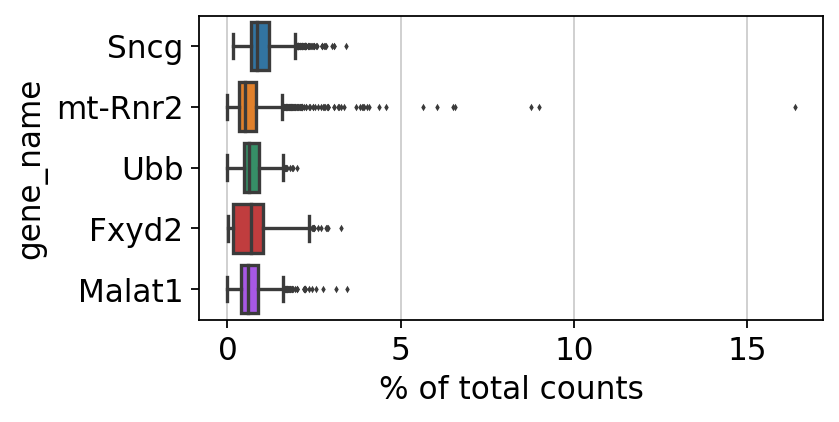

In [14]:
adata.var["gene_id"] = adata.var.index.values

t2g = pd.read_csv("t2g.txt", header=None, names=["tid", "gene_id", "gene_name"], sep="\t")
t2g.index = t2g.gene_id
t2g = t2g.loc[~t2g.index.duplicated(keep='first')]

adata.var["gene_name"] = adata.var.gene_id.map(t2g["gene_name"])
adata.var.index = adata.var["gene_name"]

sc.pl.highest_expr_genes(adata, n_top=5)

adata.var["mt"] = adata.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)

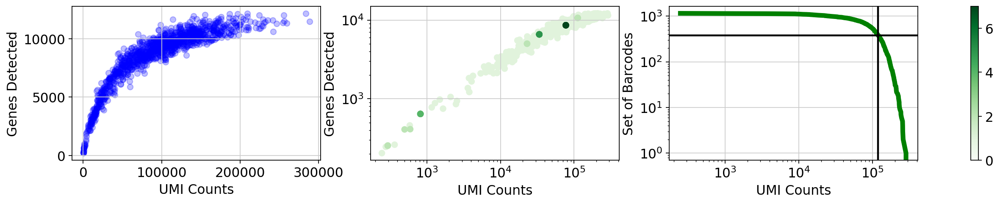

In [15]:
#Create a plot showing genes detected as a function of UMI counts.
fig, ax = plt.subplots(1,3)
x = np.asarray(adata.X.sum(axis=1))[:,0]
y = np.asarray(np.sum(adata.X>0, axis=1))[:,0]
ax[0].scatter(x, y, color="b", alpha=0.25)
ax[0].set_ylabel("Genes Detected")
ax[0].set_xlabel("UMI Counts")
#ax.set_xscale('log')
#ax.set_yscale('log')

#histogram definition
bins = [1500, 1500] # number of bins
# histogram the data
hh, locx, locy = np.histogram2d(x, y, bins=bins)
# Sort the points by density, so that the densest points are plotted last
z = np.array([hh[np.argmax(a<=locx[1:]),np.argmax(b<=locy[1:])] for a,b in zip(x,y)])
idx = z.argsort()
x2, y2, z2 = x[idx], y[idx], z[idx]

s = ax[1].scatter(x2, y2, c=z2, cmap='Greens')  
fig.colorbar(s, ax=ax)

ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].set_xlabel("UMI Counts")
ax[1].set_ylabel("Genes Detected")


expected_num_cells =  380#@param {type:"integer"}
knee = np.sort((np.array(adata.X.sum(axis=1))).flatten())[::-1]

ax[2].loglog(knee, range(len(knee)), linewidth=5, color="g")
ax[2].axvline(x=knee[expected_num_cells], linewidth=2, color="k")
ax[2].axhline(y=expected_num_cells, linewidth=2, color="k")

ax[2].set_xlabel("UMI Counts")
ax[2].set_ylabel("Set of Barcodes")

#plt.grid(True, which="both")

fig.set_size_inches([20,3])
plt.show()
fig.savefig(figure_path + 'QC_UMI_genes_counts.png')

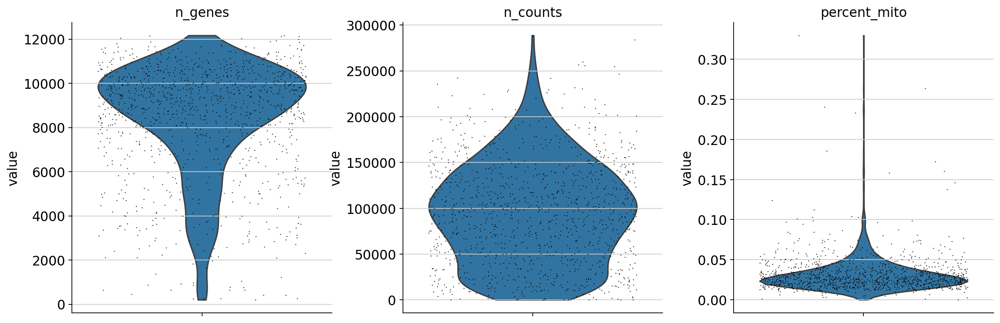

In [16]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`
### check for mitochandrial mRNA
mito_genes = adata.var_names.str.startswith('mt-')
# for each cell compute fraction of counts in mito genes vs. all genes
# the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
adata.obs['percent_mito'] = np.sum(
    adata[:, mito_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1
# add the total counts per cell as observations-annotation to adata
adata.obs['n_counts'] = adata.X.sum(axis=1).A1
sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'],
             jitter=0.4, multi_panel=True)

In [17]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata.n_obs))
#cell_subset = sc.pp.filter_cells(adata, min_counts = 1000)
#filter1 = kept_cells_stimuli[cell_subset[0]]
#red_filter1 = red_intensity[cell_subset[0]]
#green_filter1 = green_intensity[cell_subset[0]]
#well_id_filter1 = well_id[cell_subset[0]]
sc.pp.filter_cells(adata, min_counts = 1000)

Total number of cells: 1152
filtered out 12 cells that have less than 1000 counts


/home/melma31/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [18]:
print('Number of cells after min count filter: {:d}'.format(adata.n_obs))
#cell_subset = sc.pp.filter_cells(adata, min_genes = 1000,inplace=False)
#filter2 = filter1[cell_subset[0]]
#red_filter2 = red_filter1[cell_subset[0]]
#green_filter2 = green_filter1[cell_subset[0]]
#well_id_filter2 = well_id_filter1[cell_subset[0]]
sc.pp.filter_cells(adata, min_genes = 1000)

Number of cells after min count filter: 1140
filtered out 6 cells that have less than 1000 genes expressed


In [19]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))
# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata, min_cells=5)
#sc.pp.filter_genes(adata, min_counts=10)


Total number of genes: 55421
filtered out 29491 genes that are detected in less than 5 cells


In [20]:
adata.var['mt'] = adata.var_names.str.startswith('mt-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

print(adata.shape)


(1134, 25930)


In [21]:
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


In [33]:
import seaborn as sb

sb.set_context(context='poster')

In [34]:
sc.pp.highly_variable_genes(adata, flavor='cell_ranger', n_top_genes=2000)
print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata.var['highly_variable'])))

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)

 Number of highly variable genes: 2000


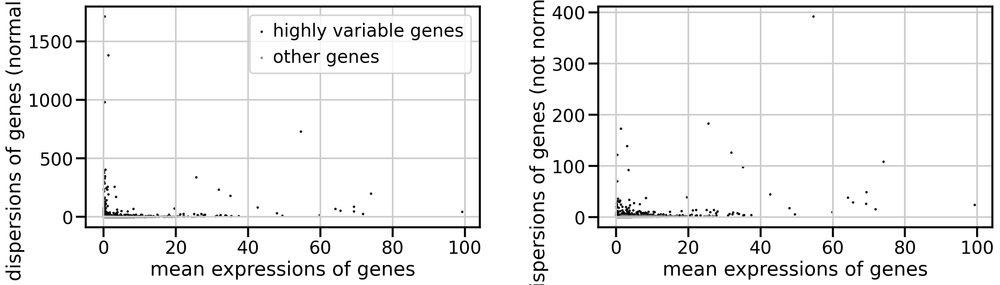

In [35]:
from matplotlib import rcParams

rcParams['figure.figsize']=(10,5)
sc.pl.highly_variable_genes(adata)

In [36]:
sc.pp.pca(adata, n_comps=20, use_highly_variable=False, svd_solver='arpack')


computing PCA
    with n_comps=20
    finished (0:00:05)


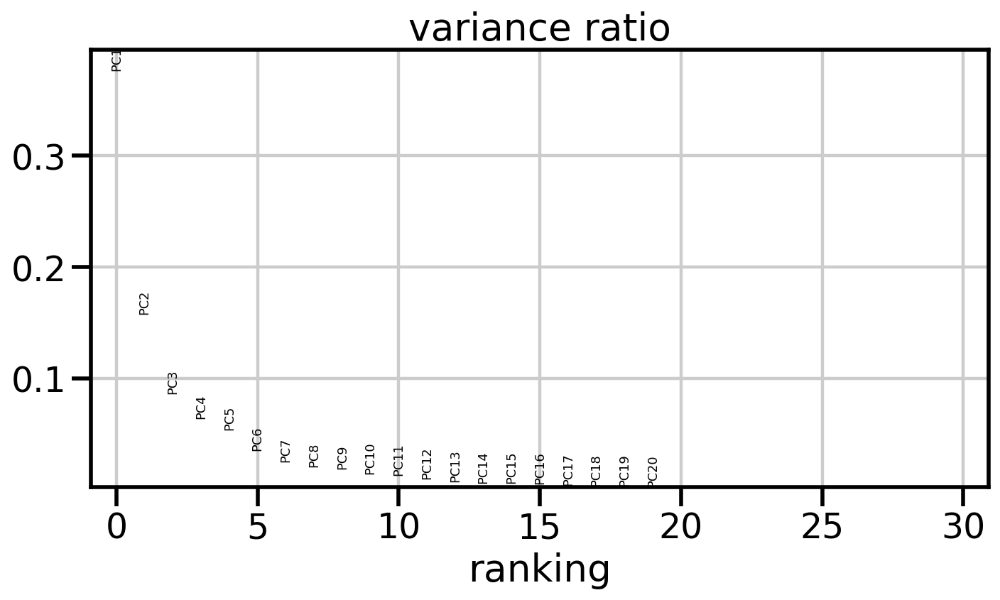

In [37]:
sc.pl.pca_variance_ratio(adata)


In [38]:
sc.pp.pca(adata, n_comps=24, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)
sc.tl.tsne(adata) #Note n_jobs works for MulticoreTSNE, but not regular implementation)
sc.tl.umap(adata)
sc.tl.diffmap(adata)
sc.tl.draw_graph(adata)

computing PCA
    on highly variable genes
    with n_comps=24
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 24
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing tSNE
    using 'X_pca' with n_pcs = 24
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.98645544 0.9697306  0.9653258  0.9570092  0.94972914
     0.9456646  0.94273657 0.9369673  0.92833227 0.9243748  0.9193742
     0.9038515  0.8987346  0.8861549 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.

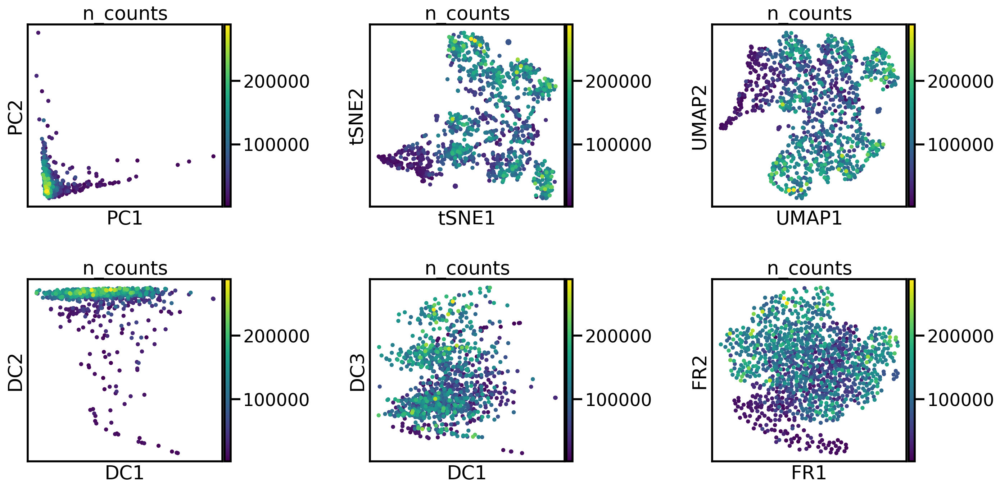

In [39]:
from matplotlib import rcParams


rcParams['figure.figsize']=(20,10)
fig_ind=np.arange(231, 237)
fig = plt.figure()
fig.subplots_adjust(hspace=0.4, wspace=0.6)

p10 = sc.pl.pca_scatter(adata, color='n_counts', ax=fig.add_subplot(fig_ind[0]), show=False)
p11 = sc.pl.tsne(adata, color='n_counts', ax=fig.add_subplot(fig_ind[1]), show=False)
p12 = sc.pl.umap(adata, color='n_counts', ax=fig.add_subplot(fig_ind[2]), show=False)
p13 = sc.pl.diffmap(adata, color='n_counts', components=['1,2'], ax=fig.add_subplot(fig_ind[3]),show=False)
p14 = sc.pl.diffmap(adata, color='n_counts', components=['1,3'], ax=fig.add_subplot(fig_ind[4]), show=False)
p15 = sc.pl.draw_graph(adata, color='n_counts', ax=fig.add_subplot(fig_ind[5]), show=False)

plt.show()

computing PCA
    on highly variable genes
    with n_comps=2
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 2
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 2
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


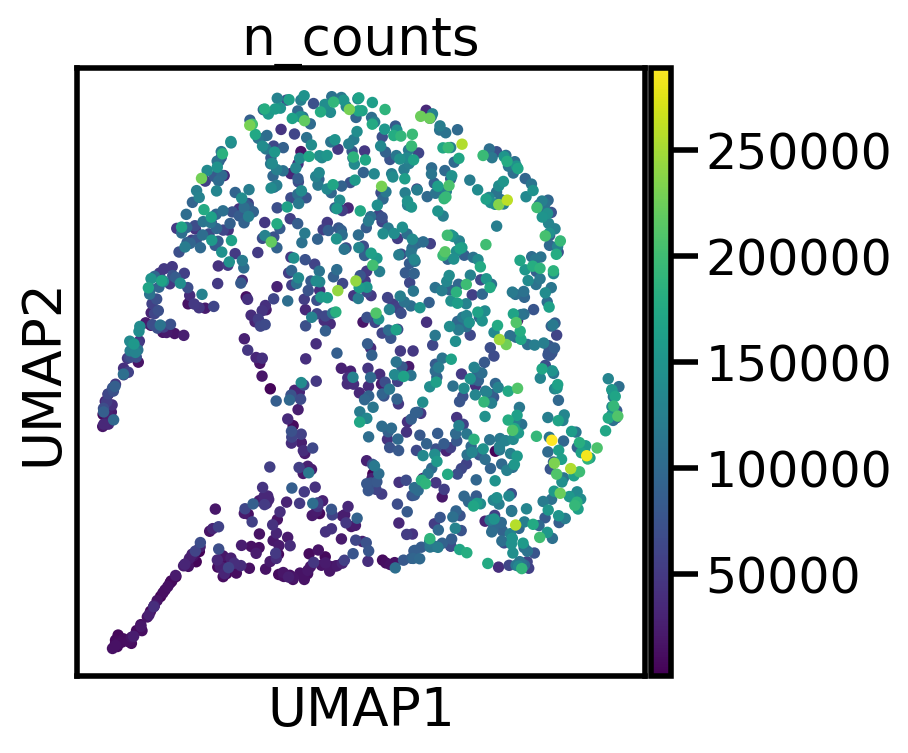

computing PCA
    on highly variable genes
    with n_comps=3
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 3
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 3
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


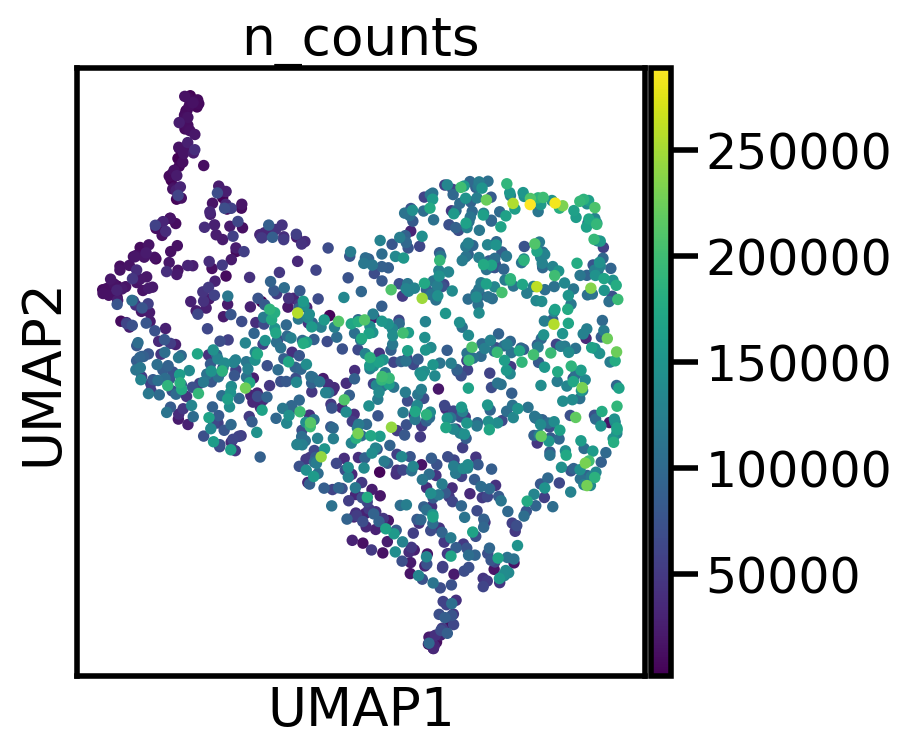

computing PCA
    on highly variable genes
    with n_comps=4
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 4
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 4
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


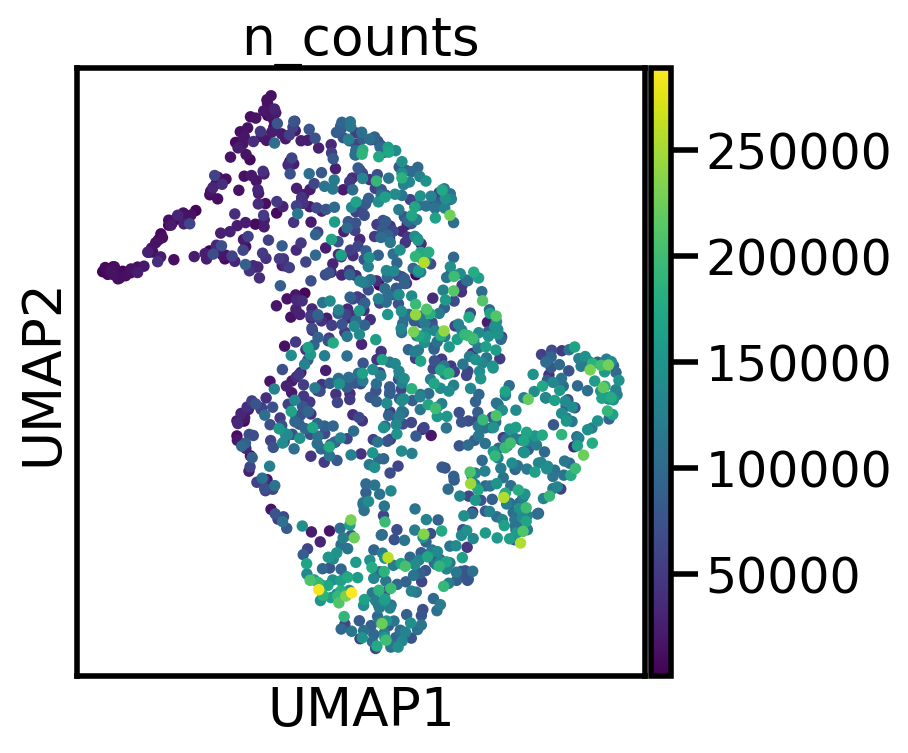

computing PCA
    on highly variable genes
    with n_comps=5
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 5
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 5
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


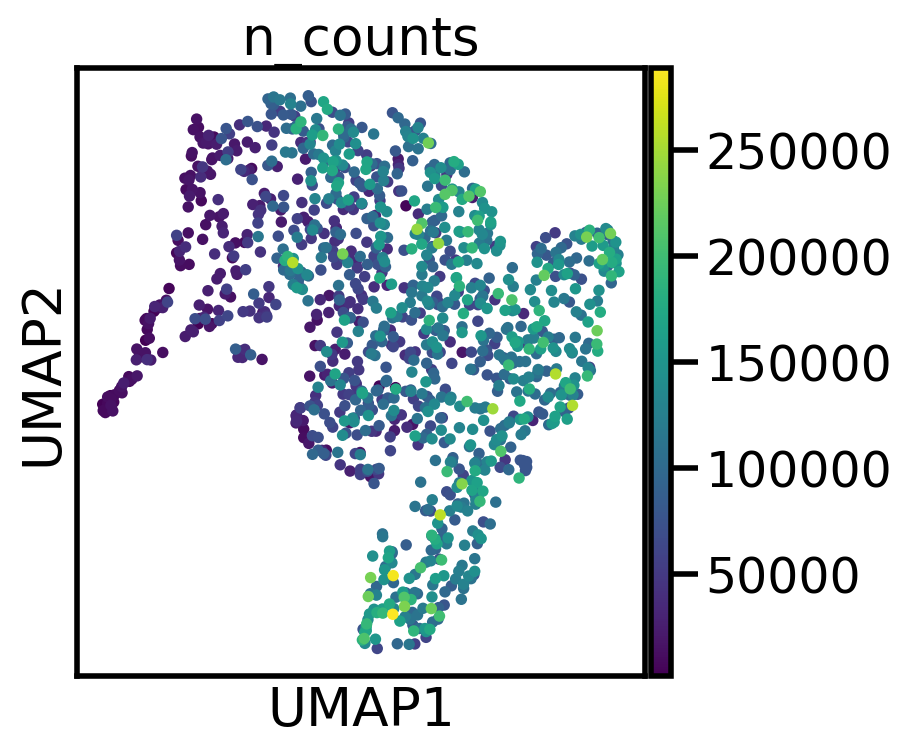

computing PCA
    on highly variable genes
    with n_comps=6
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 6
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 6
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


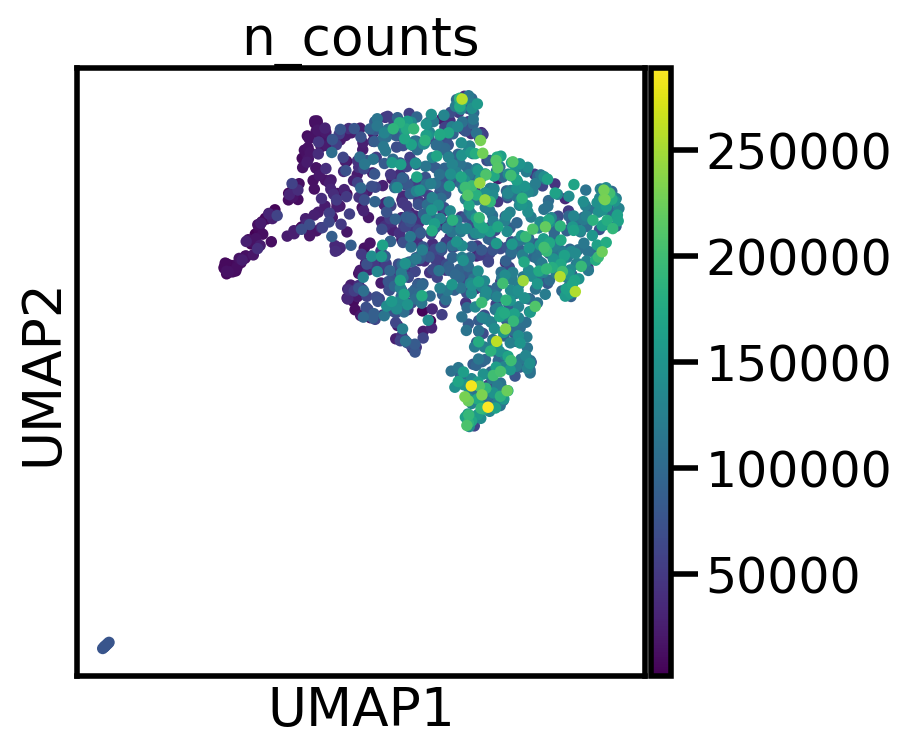

computing PCA
    on highly variable genes
    with n_comps=7
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 7
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 7
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


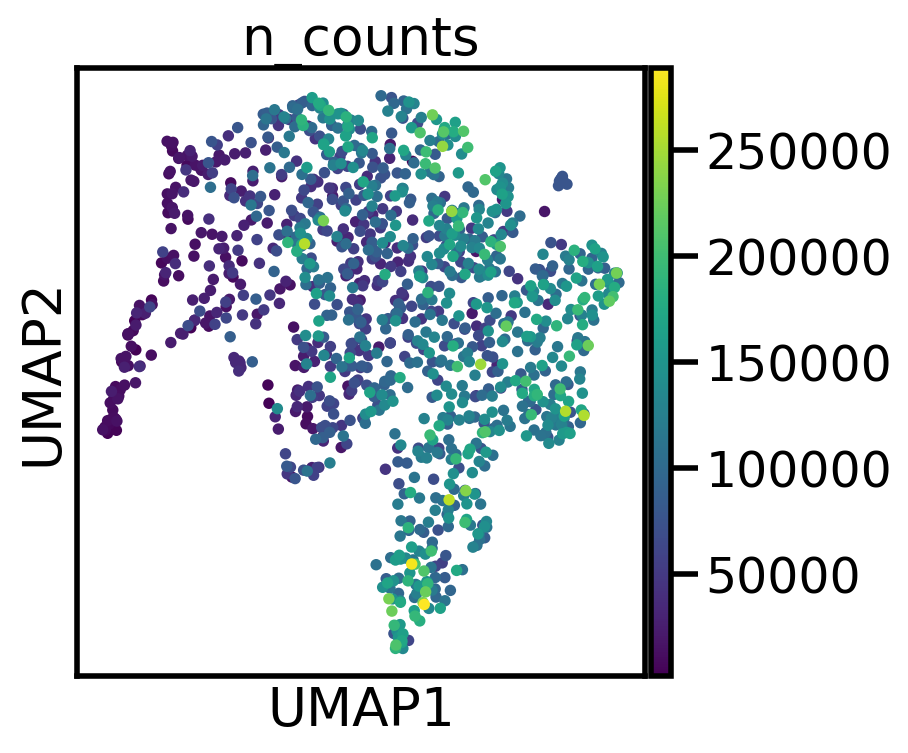

computing PCA
    on highly variable genes
    with n_comps=8
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 8
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 8
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


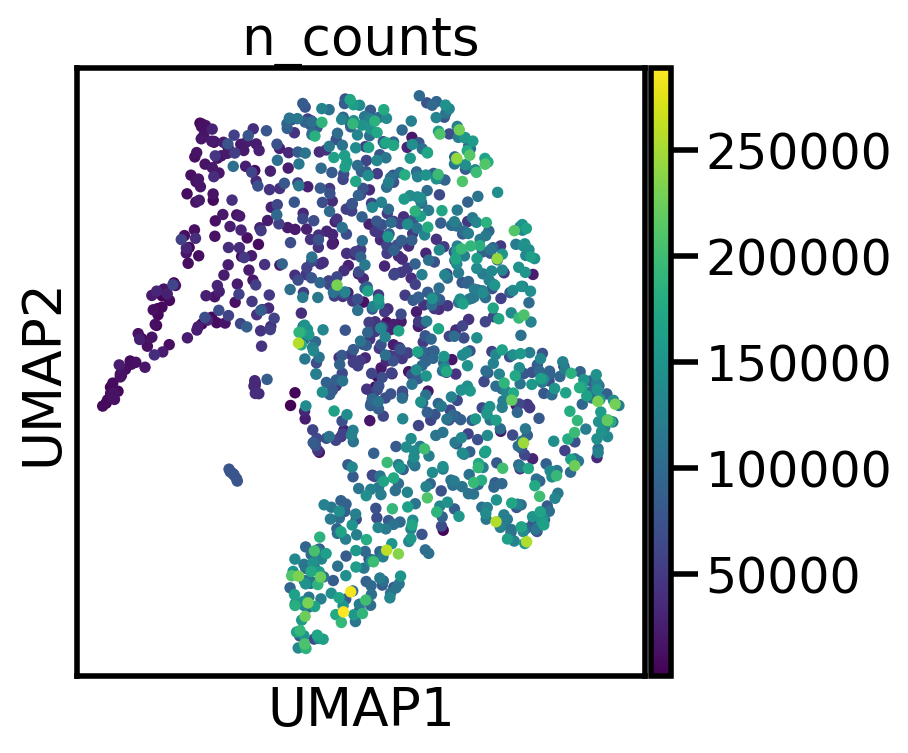

computing PCA
    on highly variable genes
    with n_comps=9
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 9
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 9
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


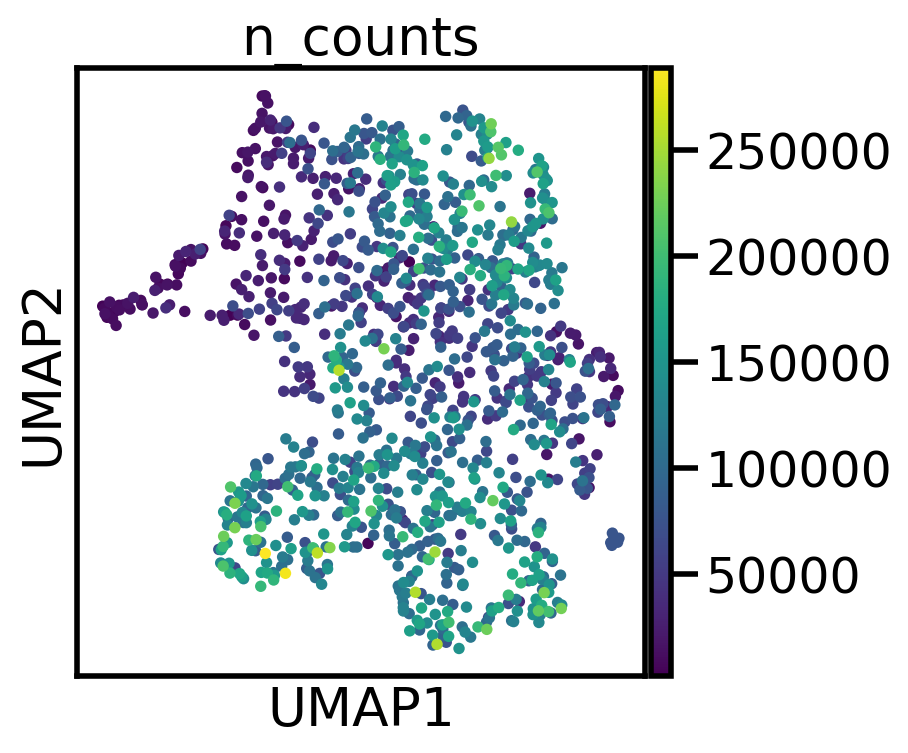

computing PCA
    on highly variable genes
    with n_comps=10
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 10
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


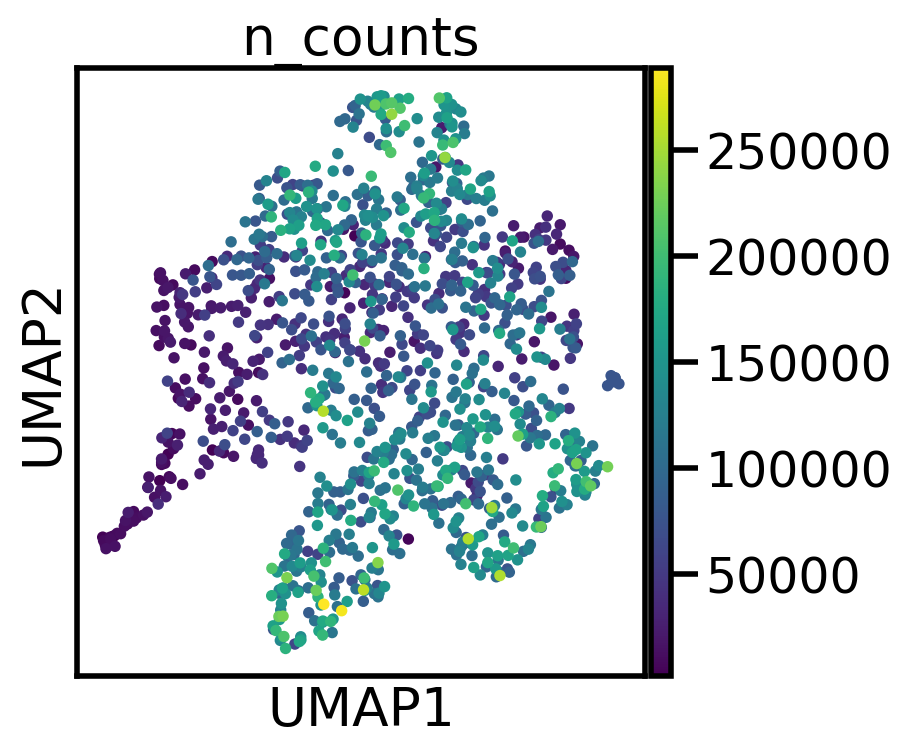

computing PCA
    on highly variable genes
    with n_comps=11
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 11
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 11
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


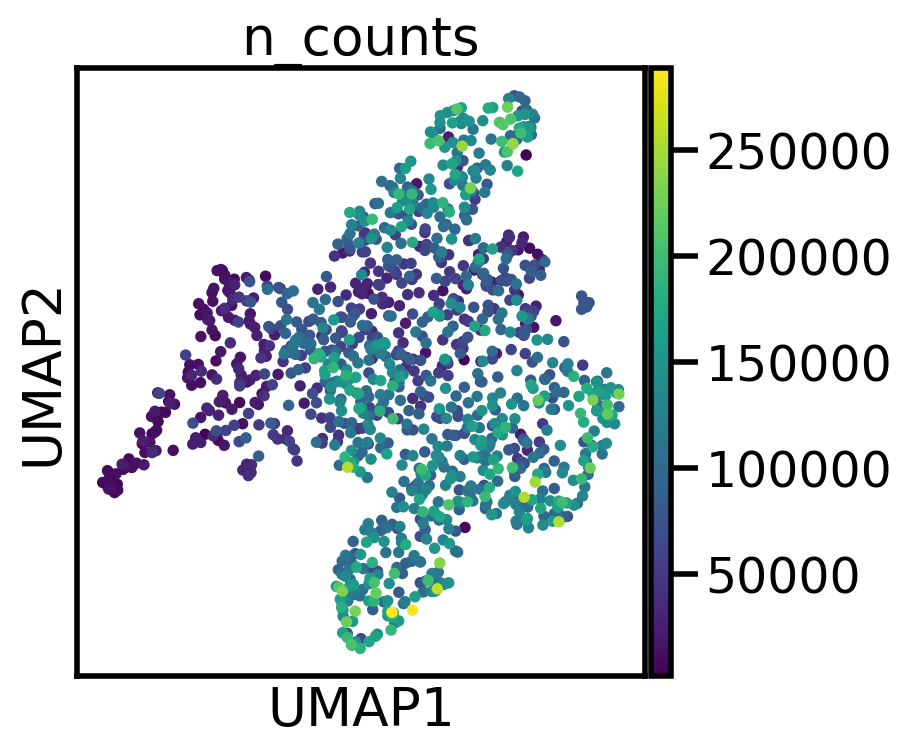

computing PCA
    on highly variable genes
    with n_comps=12
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 12
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 12
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


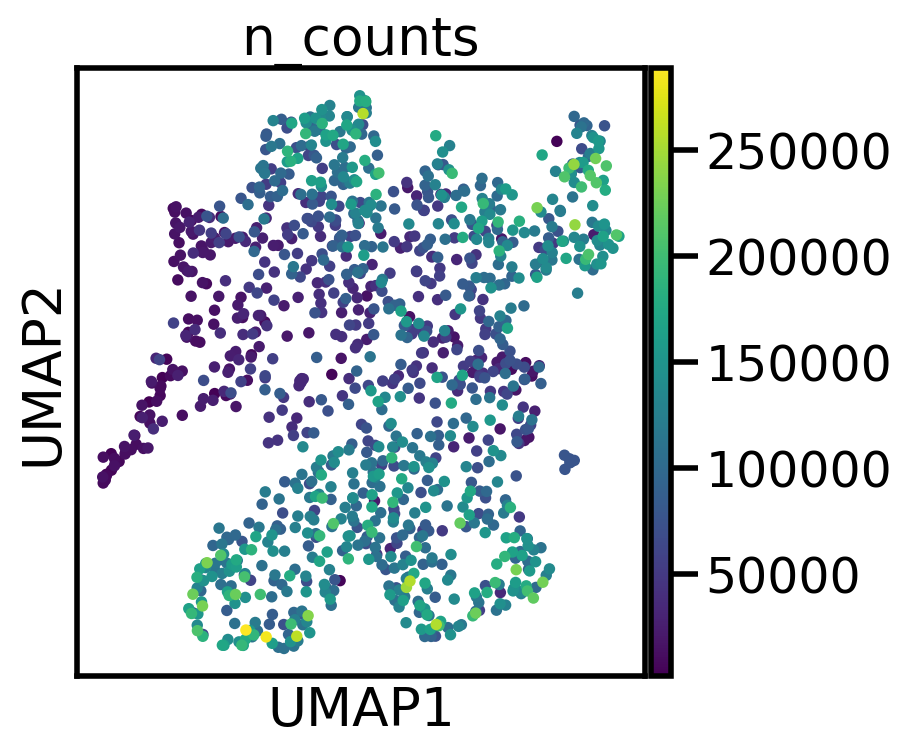

computing PCA
    on highly variable genes
    with n_comps=13
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 13
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 13
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


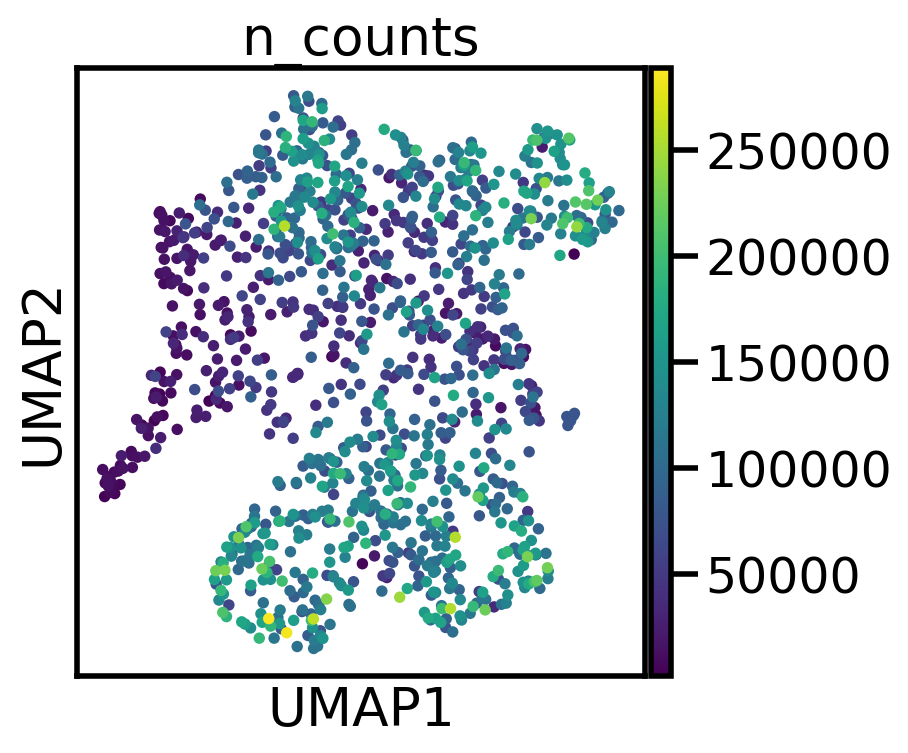

computing PCA
    on highly variable genes
    with n_comps=14
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 14
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 14
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


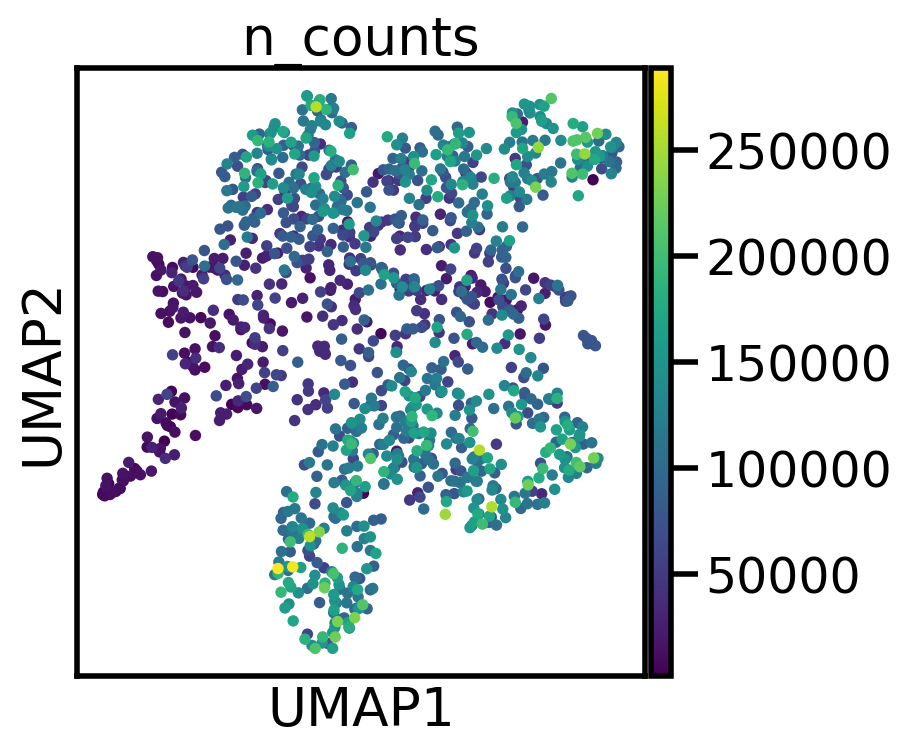

computing PCA
    on highly variable genes
    with n_comps=15
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 15
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


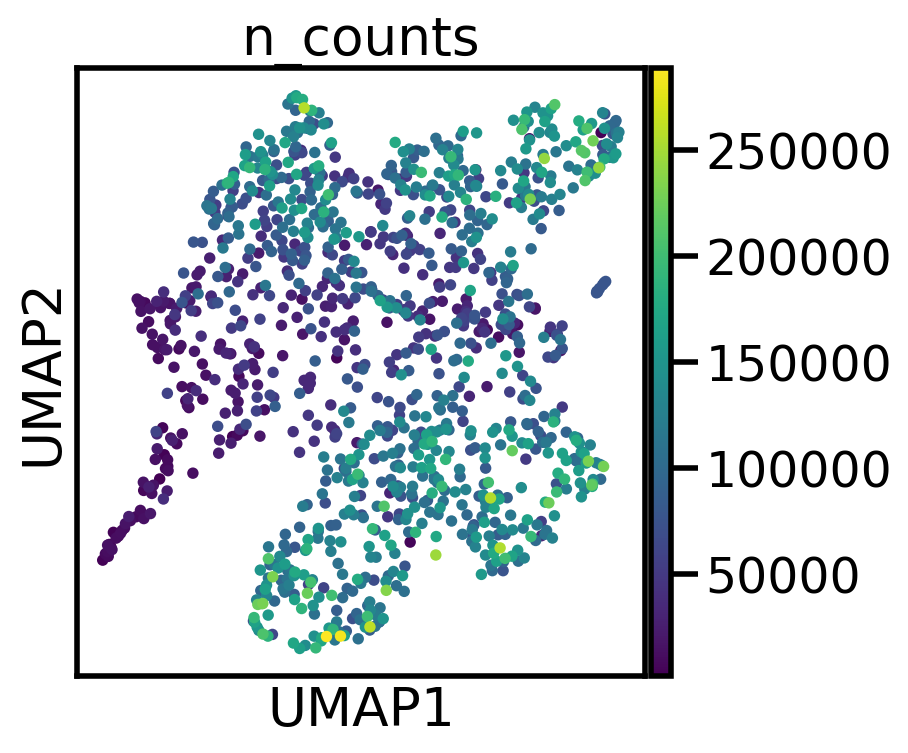

computing PCA
    on highly variable genes
    with n_comps=16
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 16
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 16
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


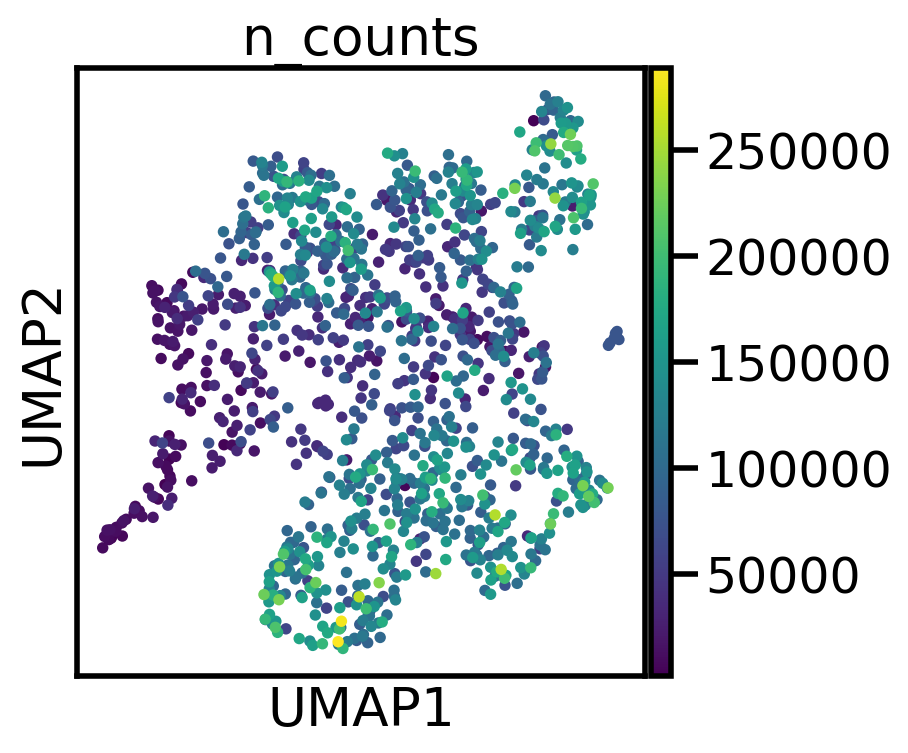

computing PCA
    on highly variable genes
    with n_comps=17
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 17
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 17
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


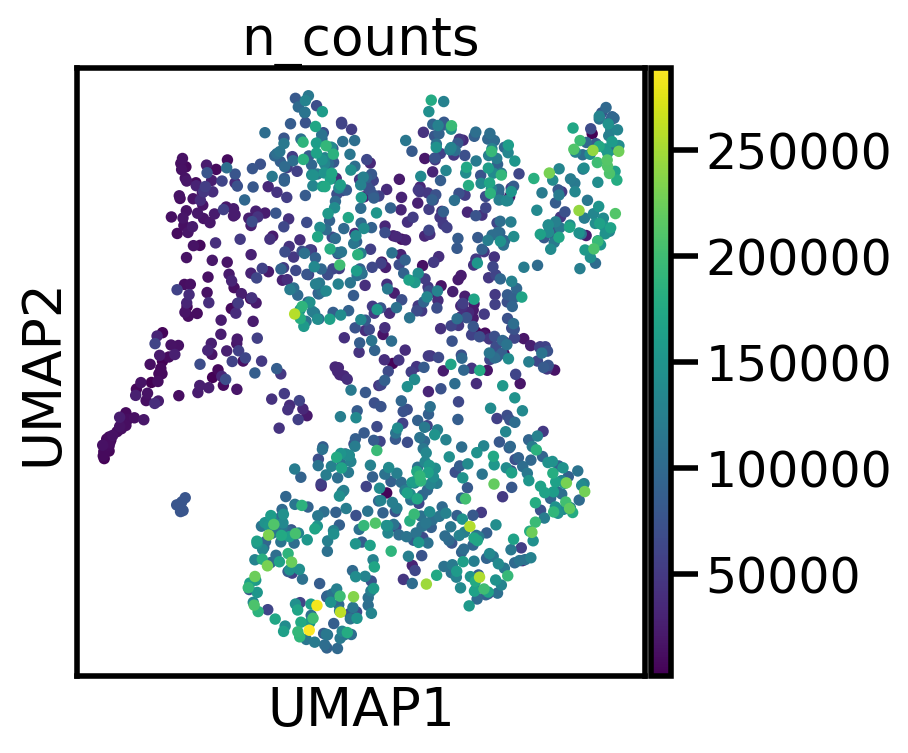

computing PCA
    on highly variable genes
    with n_comps=18
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 18
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 18
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


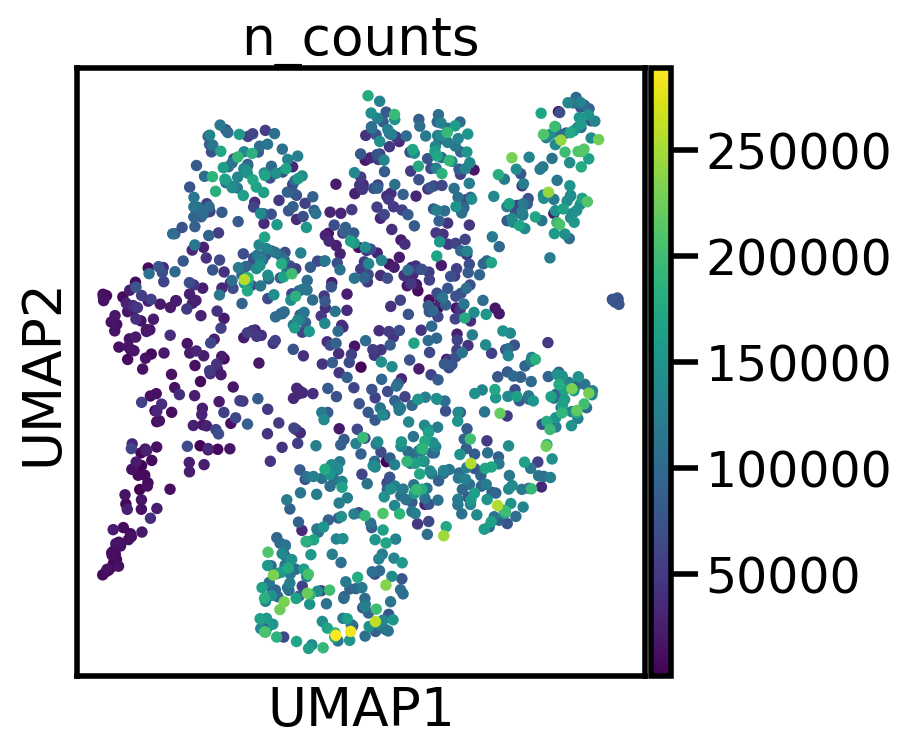

computing PCA
    on highly variable genes
    with n_comps=19
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 19
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 19
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


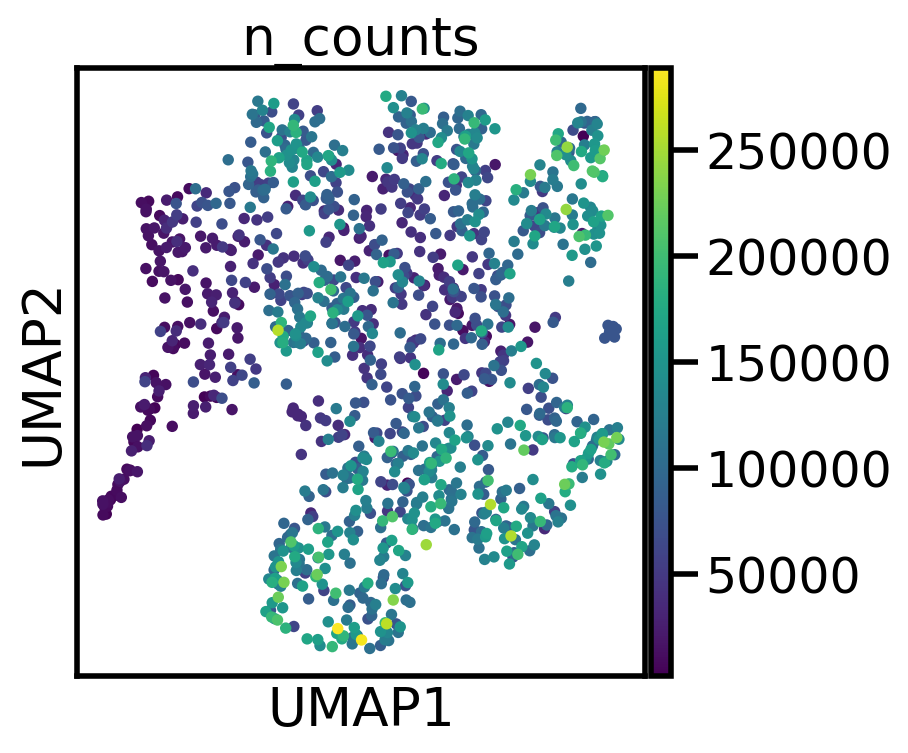

computing PCA
    on highly variable genes
    with n_comps=20
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 20
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


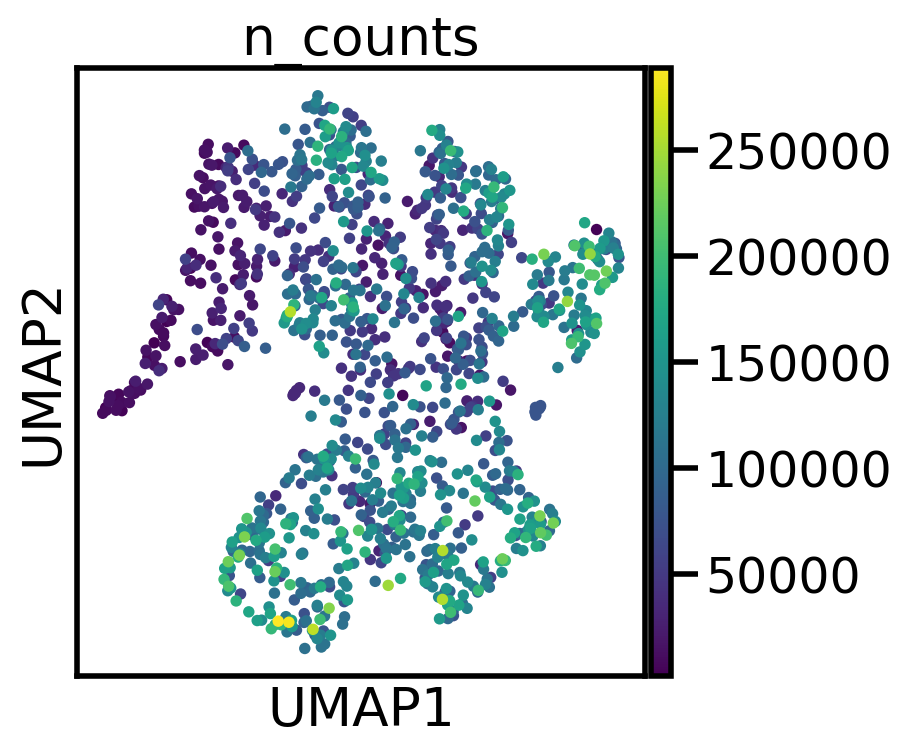

computing PCA
    on highly variable genes
    with n_comps=21
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 21
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 21
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


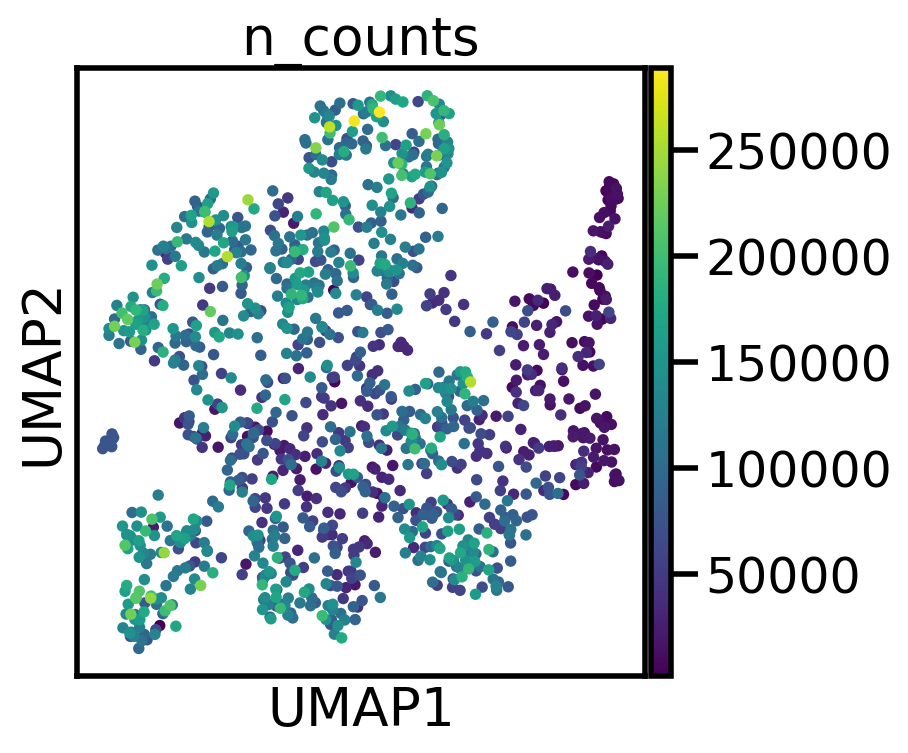

computing PCA
    on highly variable genes
    with n_comps=22
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 22
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 22
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


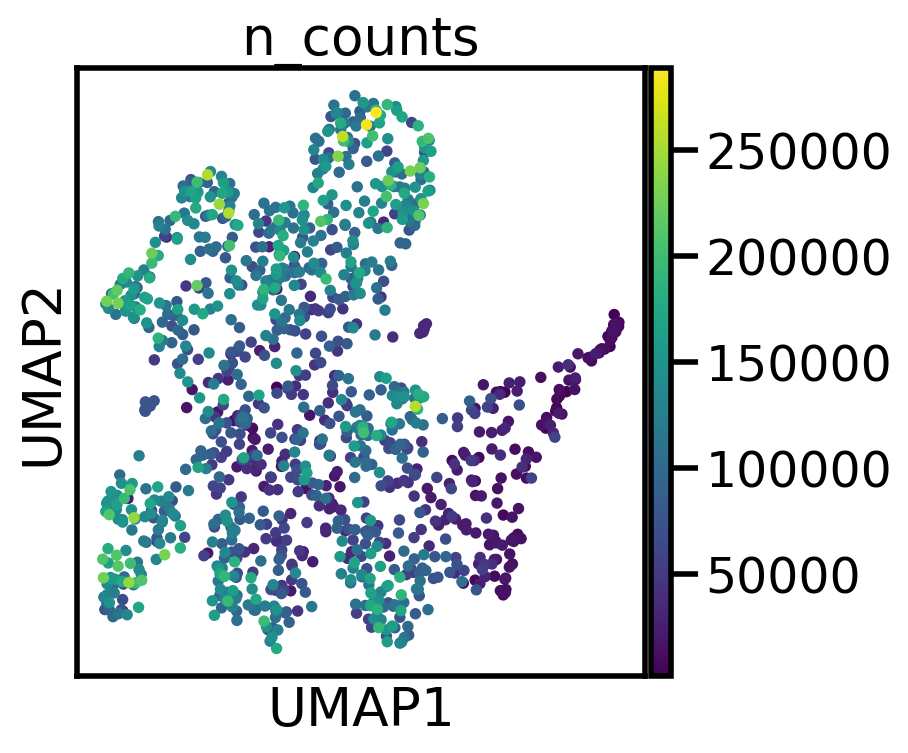

computing PCA
    on highly variable genes
    with n_comps=23
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 23
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 23
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


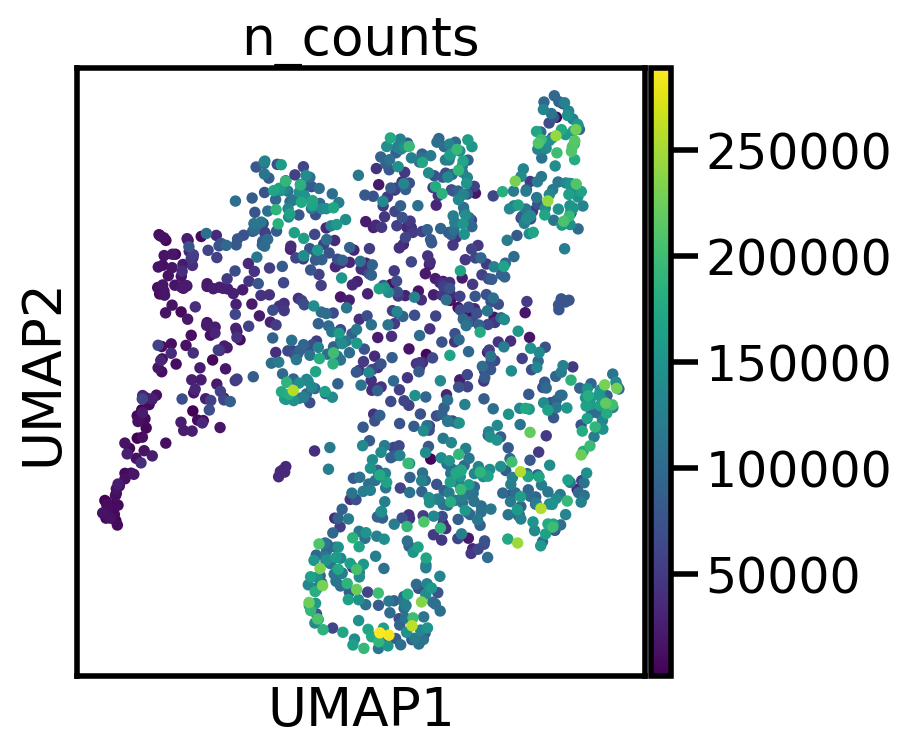

computing PCA
    on highly variable genes
    with n_comps=24
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 24
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 24
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


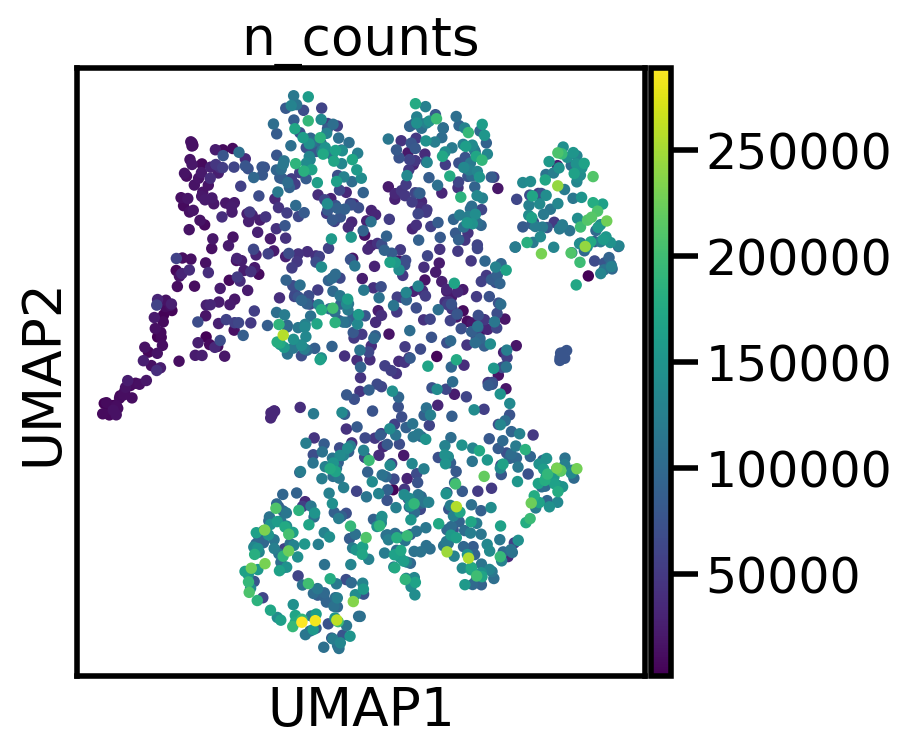

computing PCA
    on highly variable genes
    with n_comps=25
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 25
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 25
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


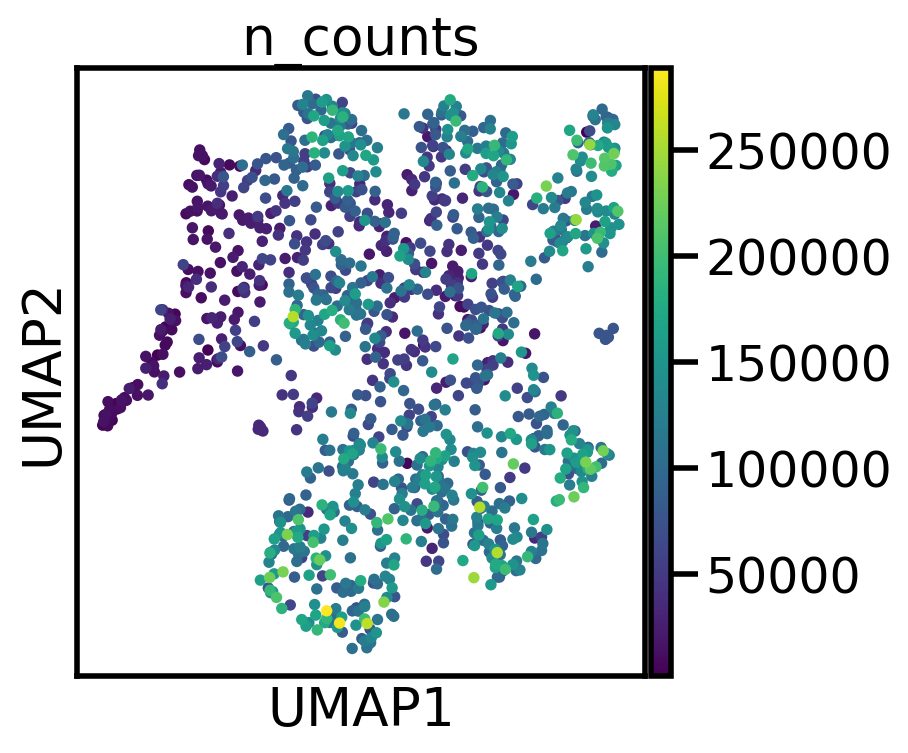

computing PCA
    on highly variable genes
    with n_comps=26
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 26
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 26
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


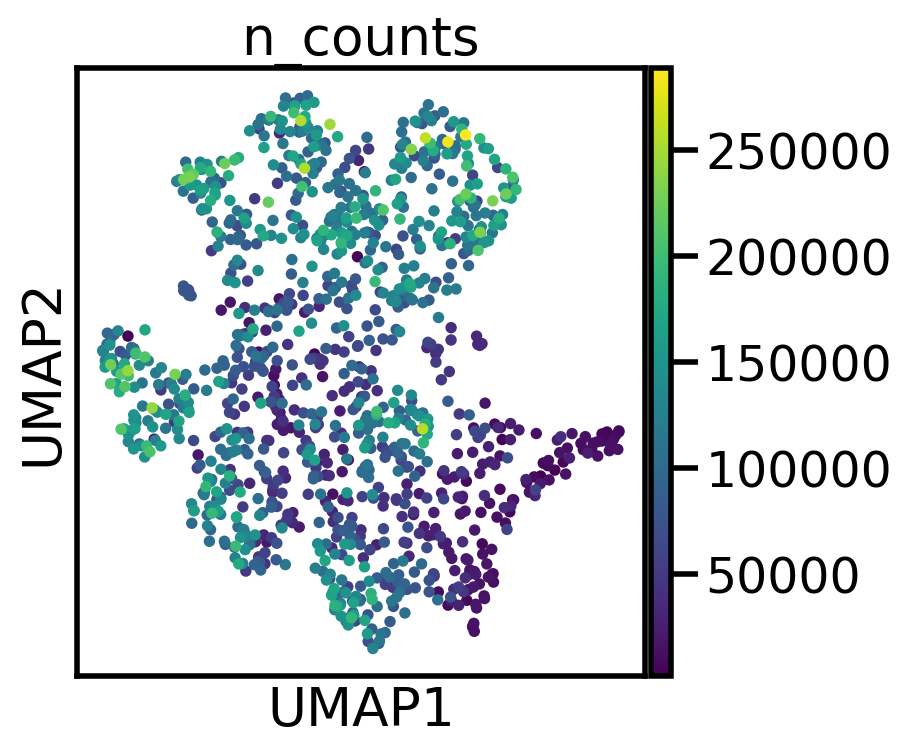

computing PCA
    on highly variable genes
    with n_comps=27
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 27
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 27
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


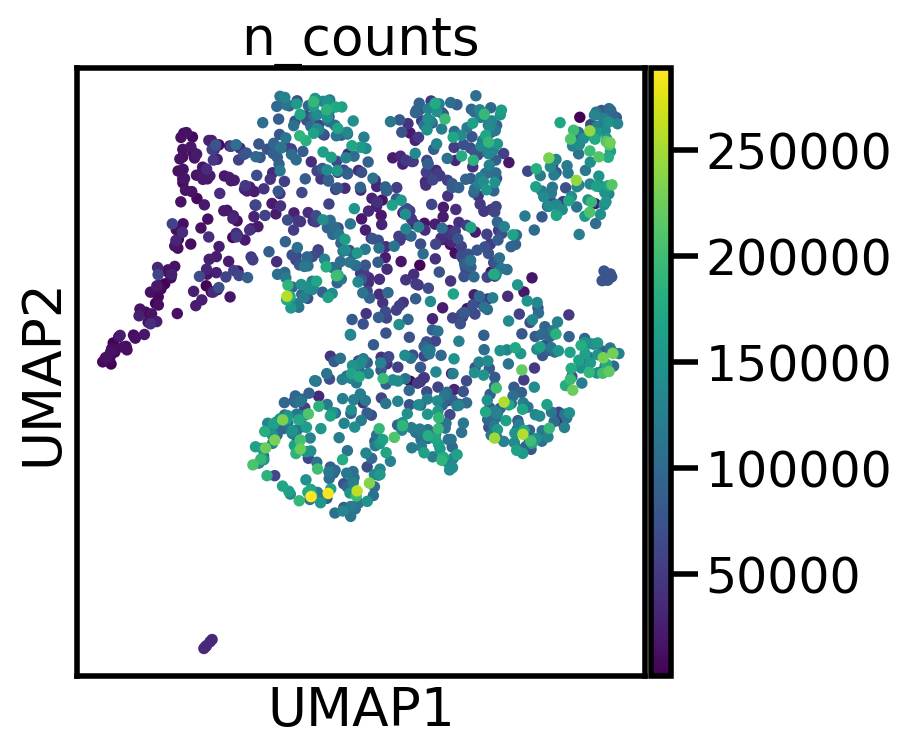

computing PCA
    on highly variable genes
    with n_comps=28
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 28
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 28
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


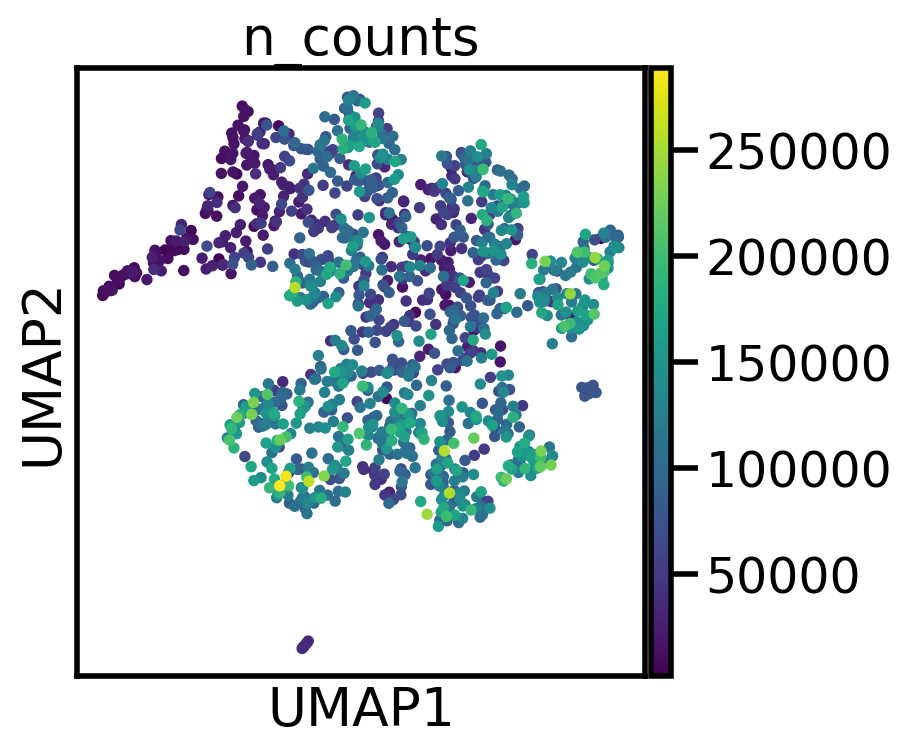

computing PCA
    on highly variable genes
    with n_comps=29
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 29
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 29
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


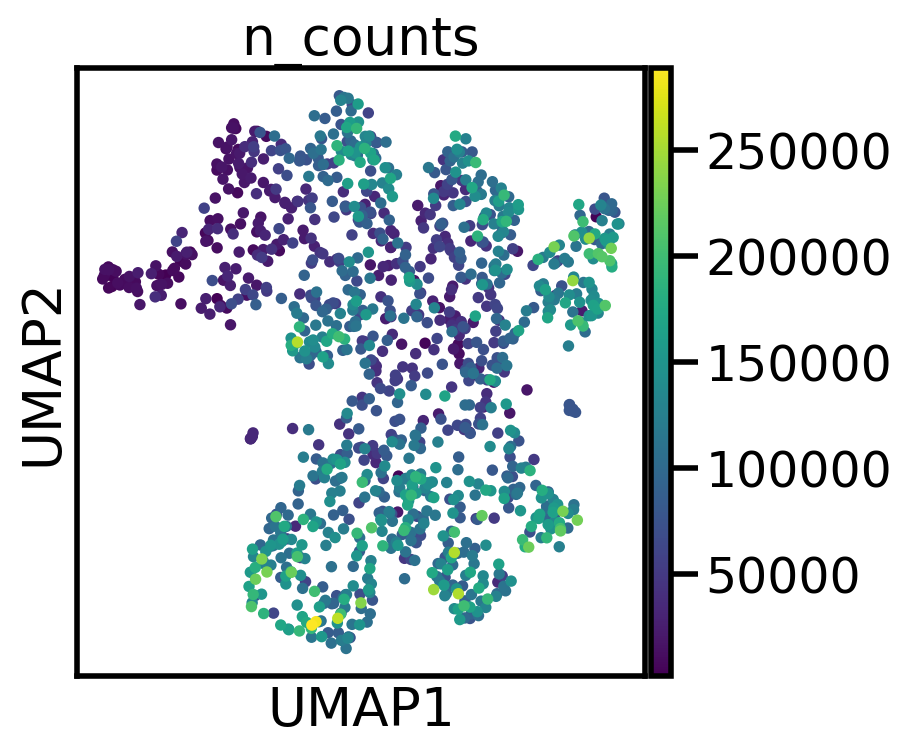

computing PCA
    on highly variable genes
    with n_comps=30
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 30
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


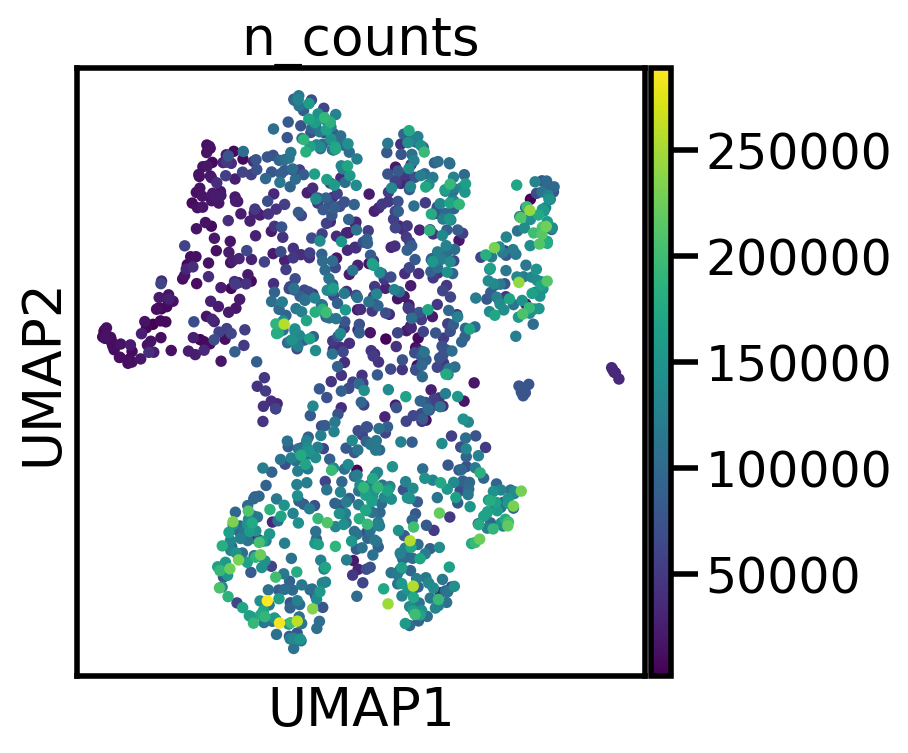

computing PCA
    on highly variable genes
    with n_comps=31
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 31
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 31
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


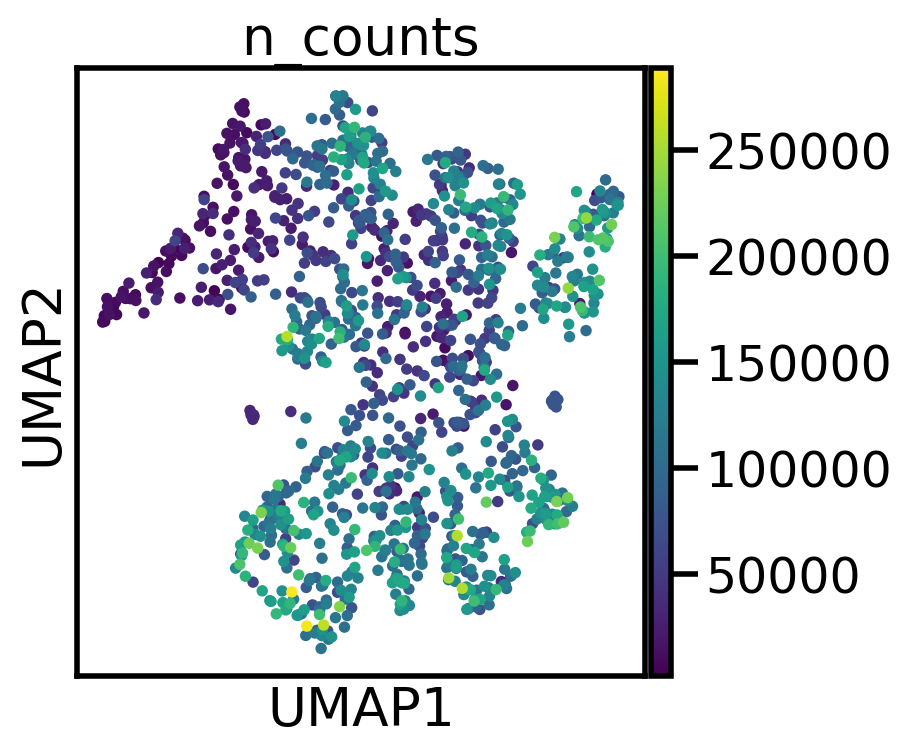

computing PCA
    on highly variable genes
    with n_comps=32
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 32
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 32
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


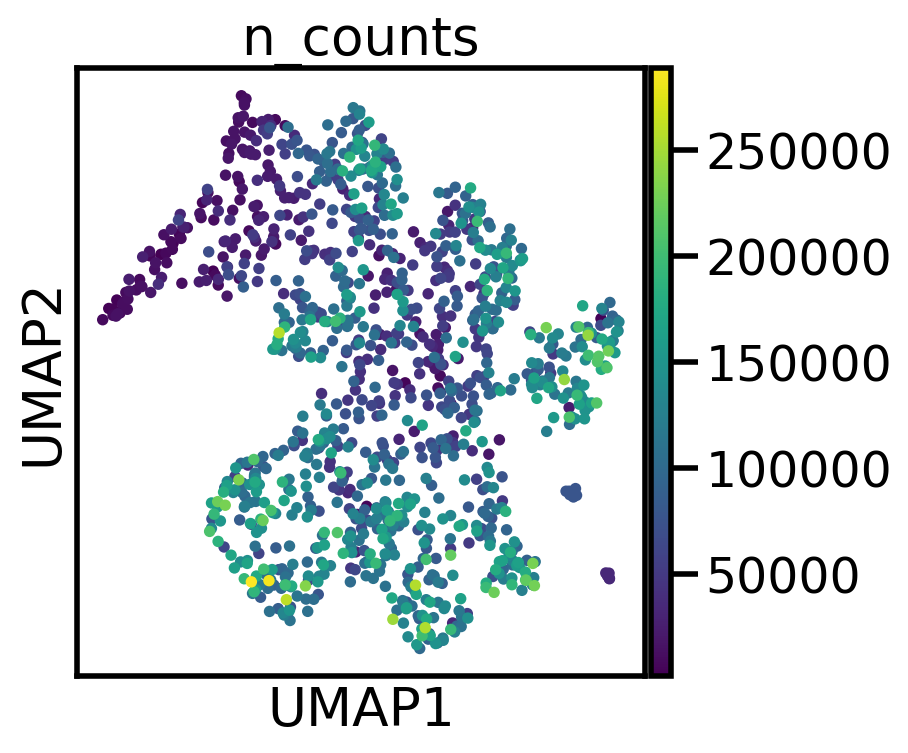

computing PCA
    on highly variable genes
    with n_comps=33
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 33
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 33
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


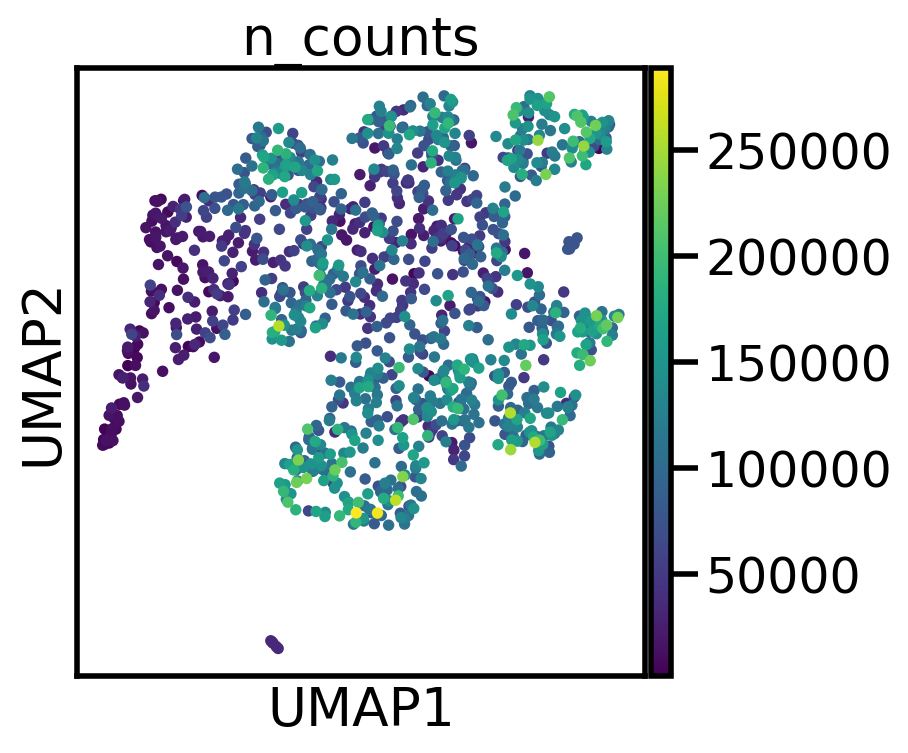

computing PCA
    on highly variable genes
    with n_comps=34
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 34
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 34
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


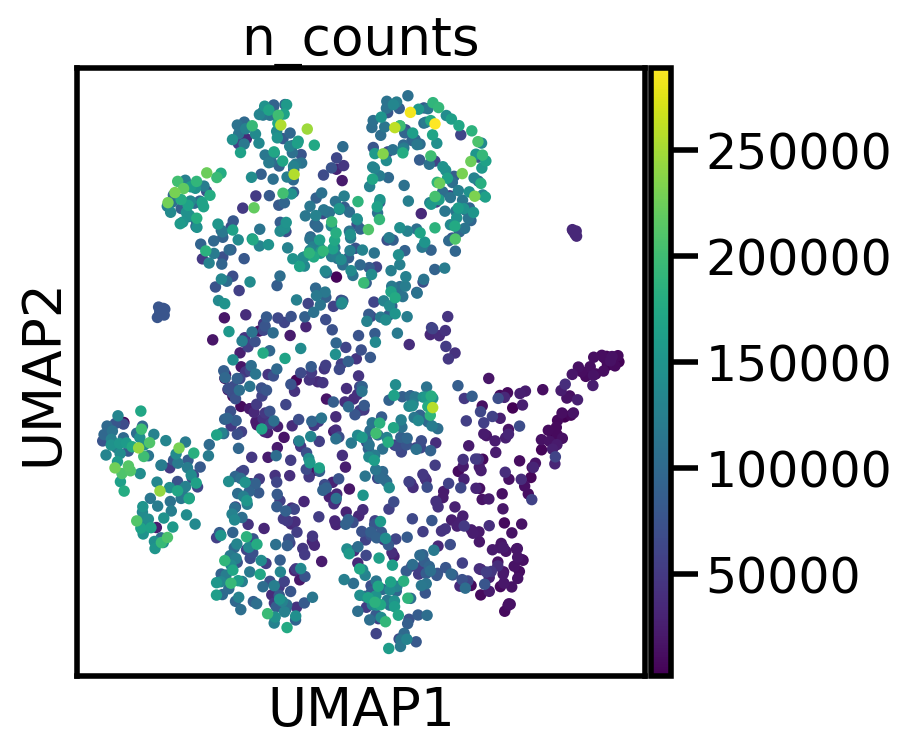

computing PCA
    on highly variable genes
    with n_comps=35
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 35
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 35
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


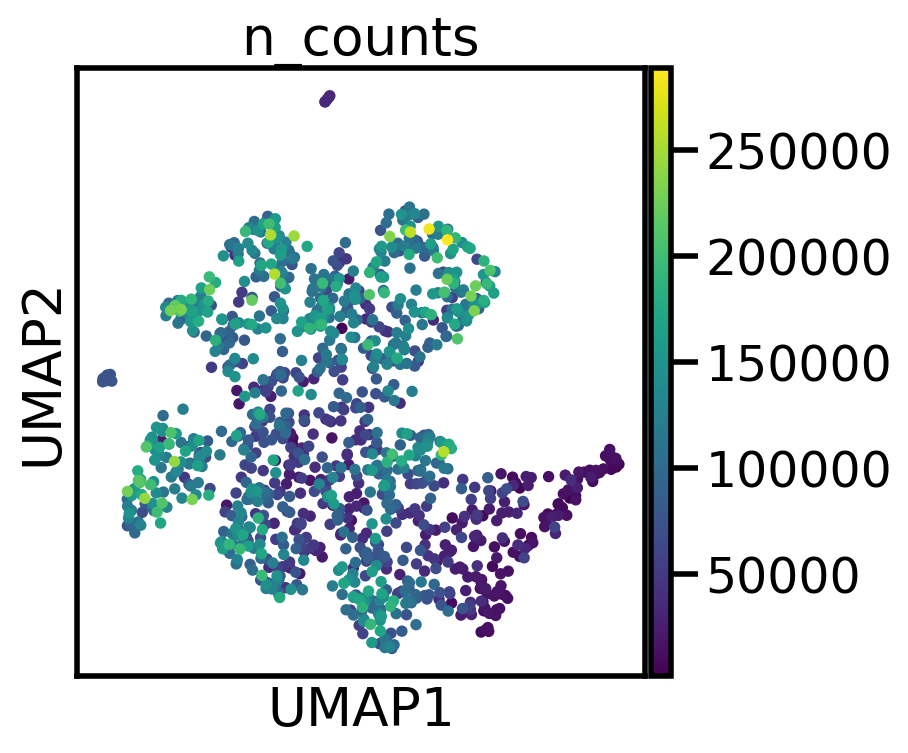

computing PCA
    on highly variable genes
    with n_comps=36
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 36
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 36
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


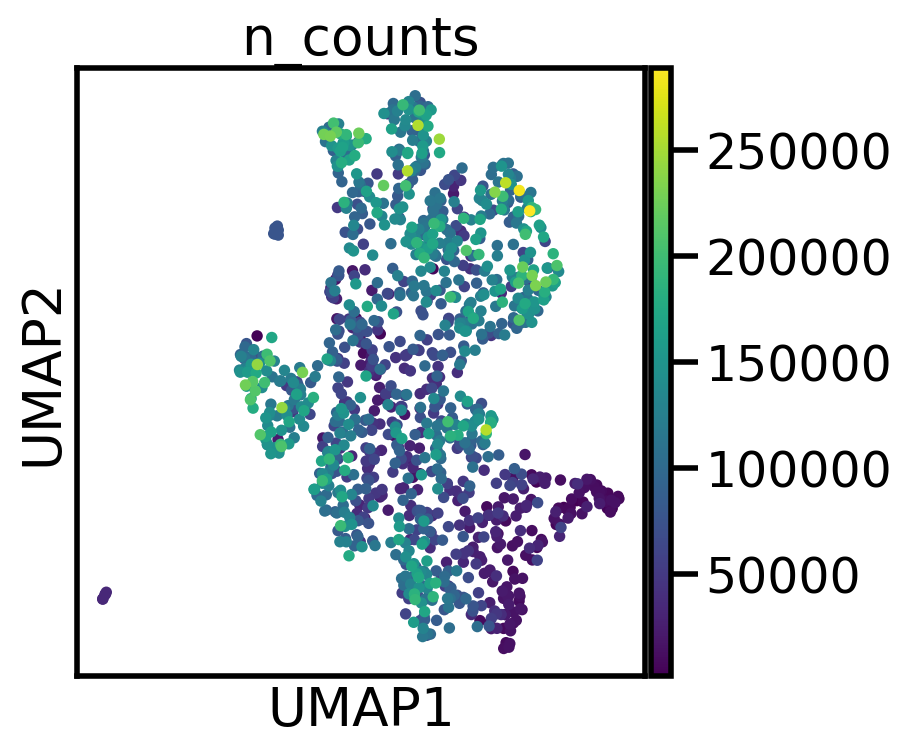

computing PCA
    on highly variable genes
    with n_comps=37
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 37
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 37
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


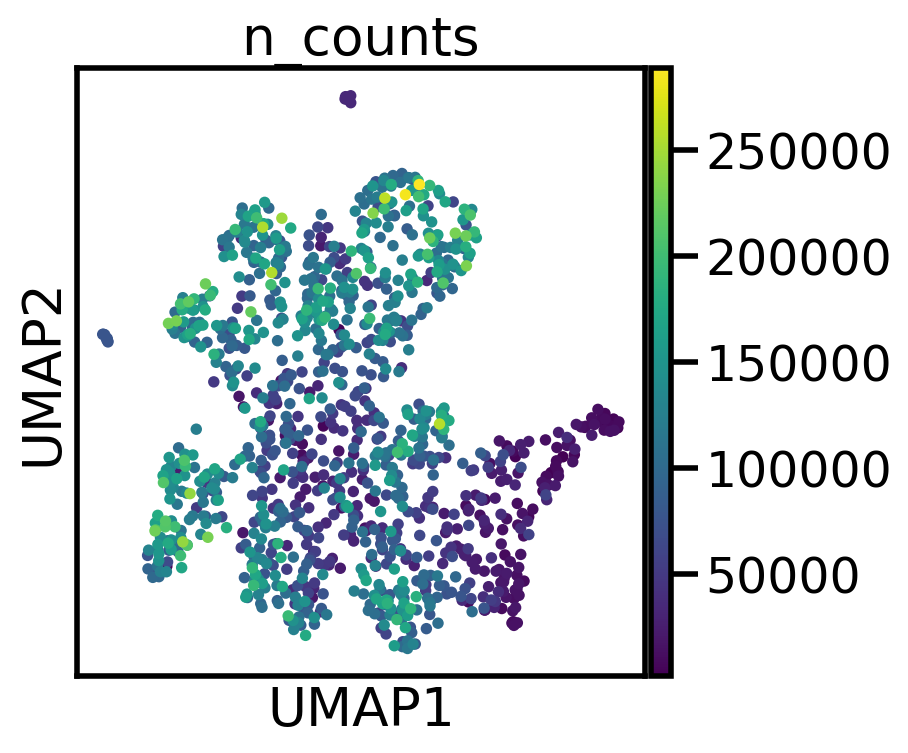

computing PCA
    on highly variable genes
    with n_comps=38
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 38
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 38
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


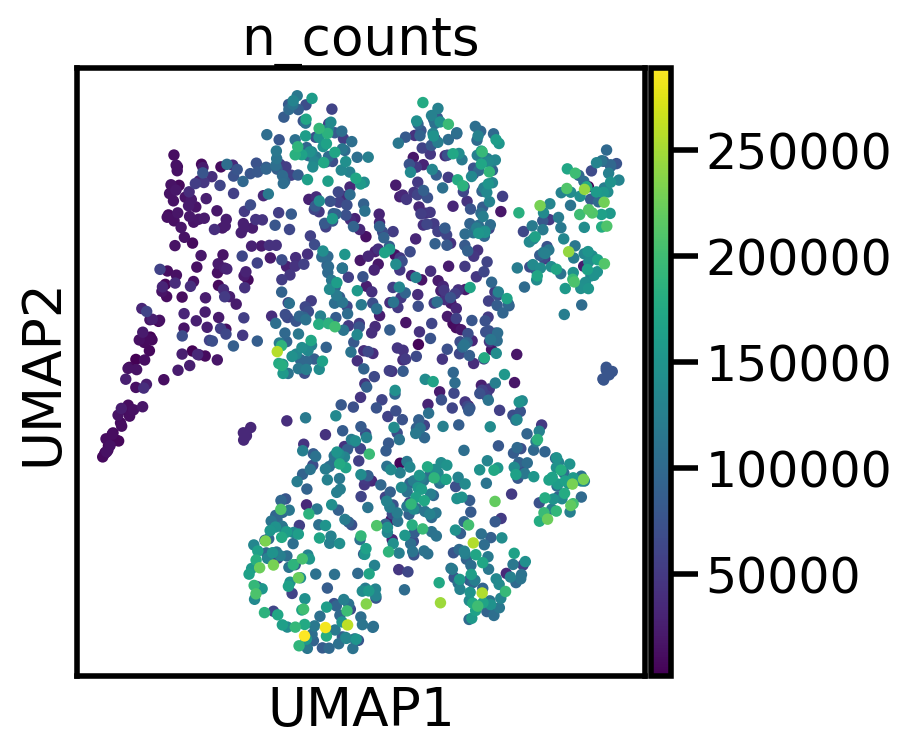

computing PCA
    on highly variable genes
    with n_comps=39
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 39
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 39
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


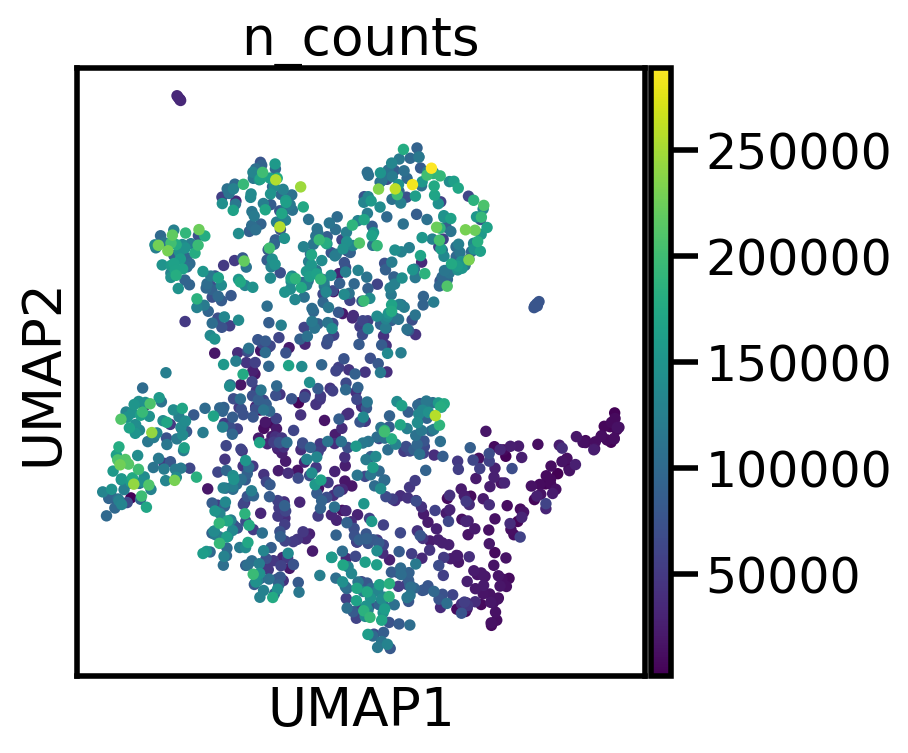

computing PCA
    on highly variable genes
    with n_comps=40
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 40
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


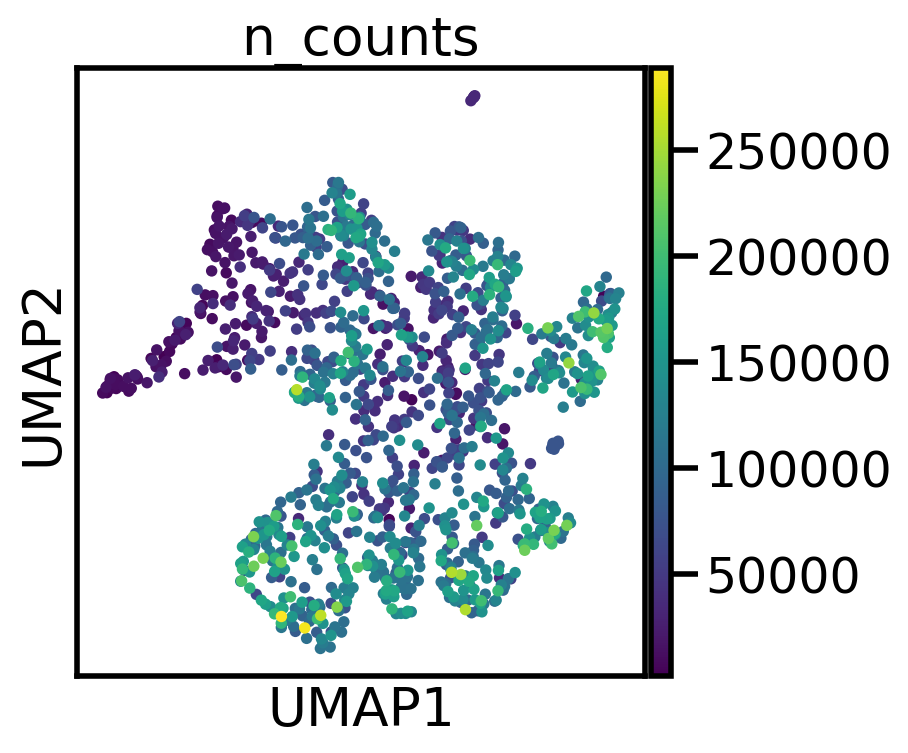

computing PCA
    on highly variable genes
    with n_comps=41
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 41
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 41
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


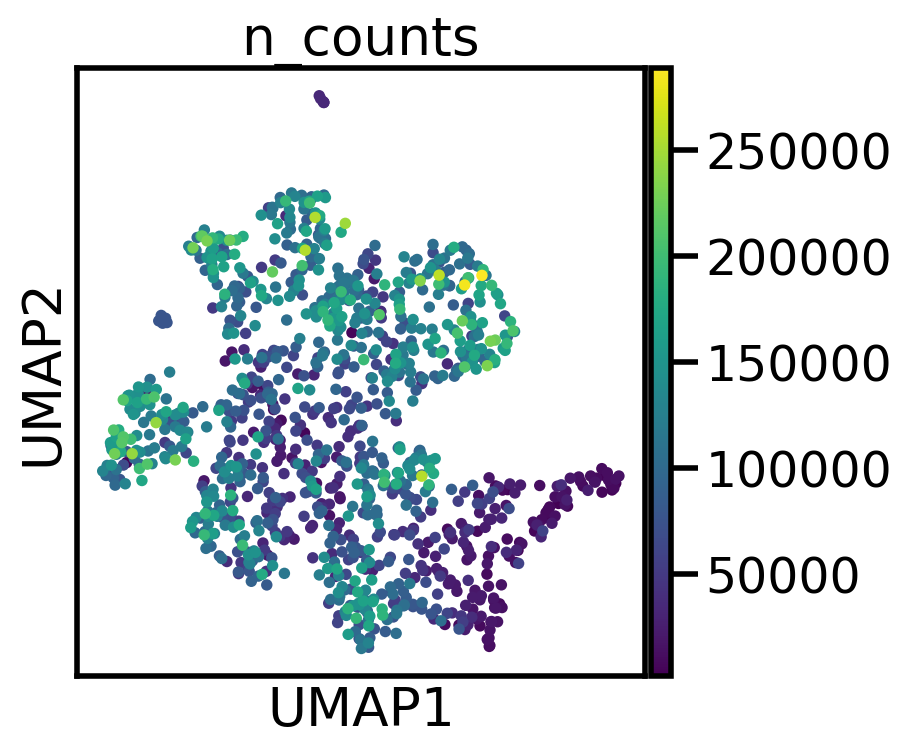

computing PCA
    on highly variable genes
    with n_comps=42
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 42
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 42
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


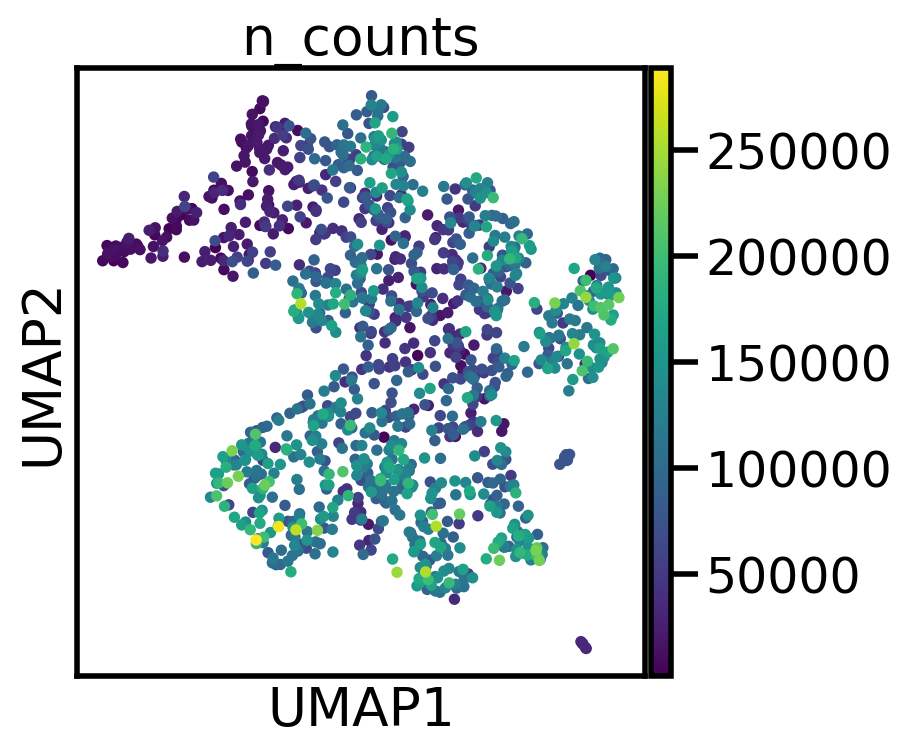

computing PCA
    on highly variable genes
    with n_comps=43
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 43
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 43
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


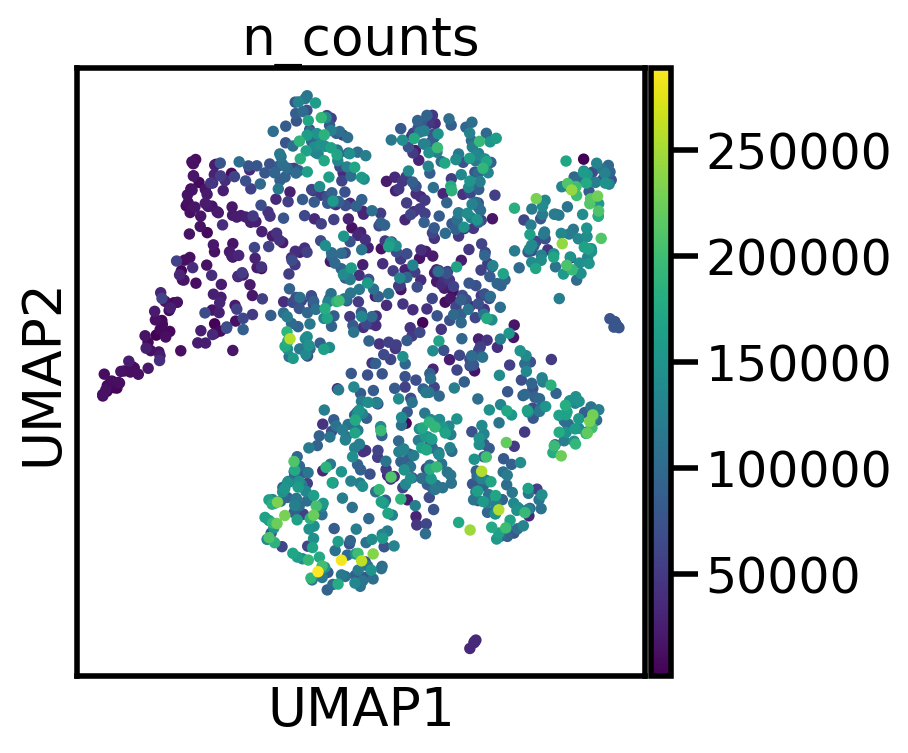

computing PCA
    on highly variable genes
    with n_comps=44
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 44
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 44
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


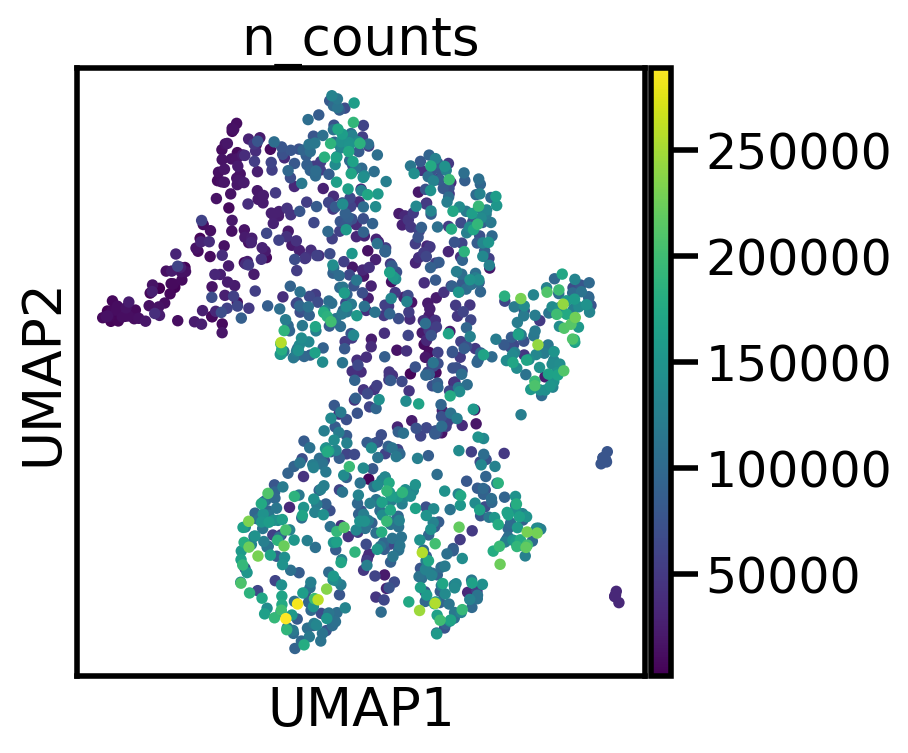

computing PCA
    on highly variable genes
    with n_comps=45
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 45
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 45
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


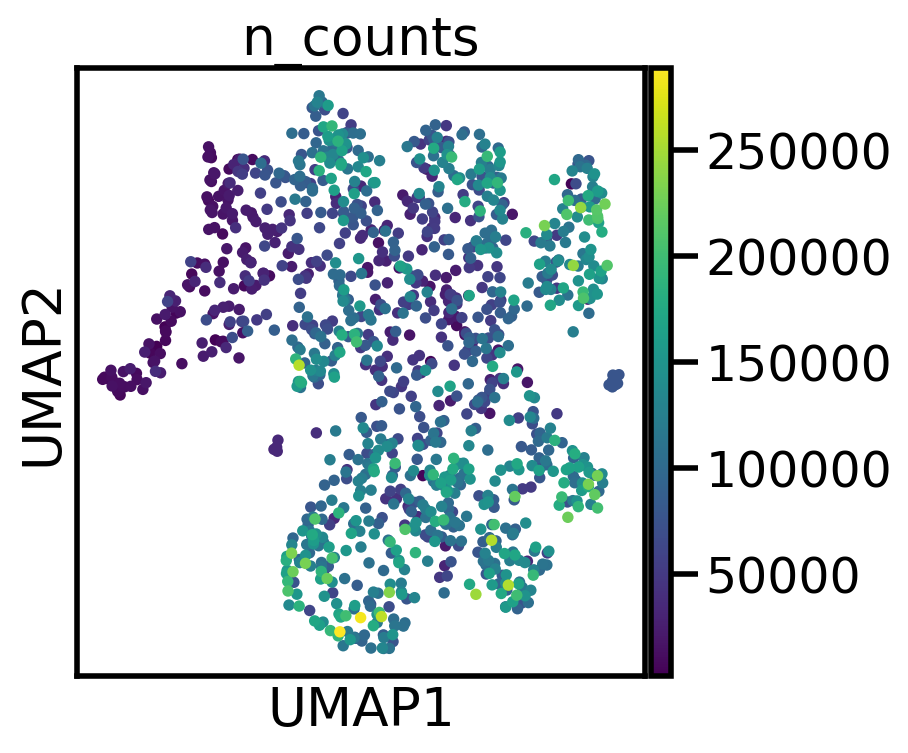

computing PCA
    on highly variable genes
    with n_comps=46
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 46
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 46
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


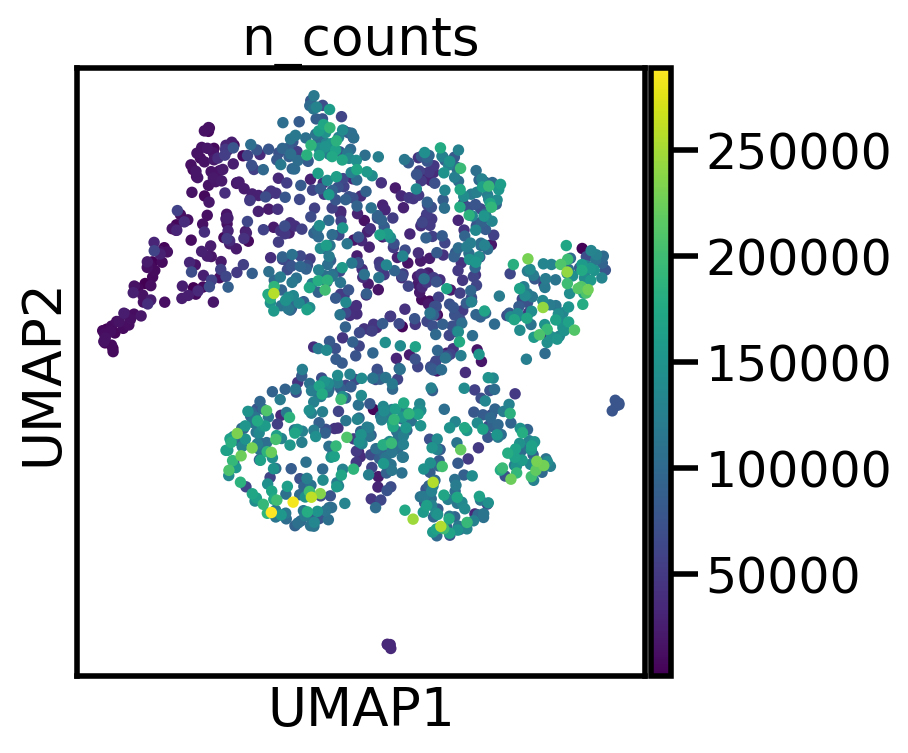

computing PCA
    on highly variable genes
    with n_comps=47
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 47
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 47
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


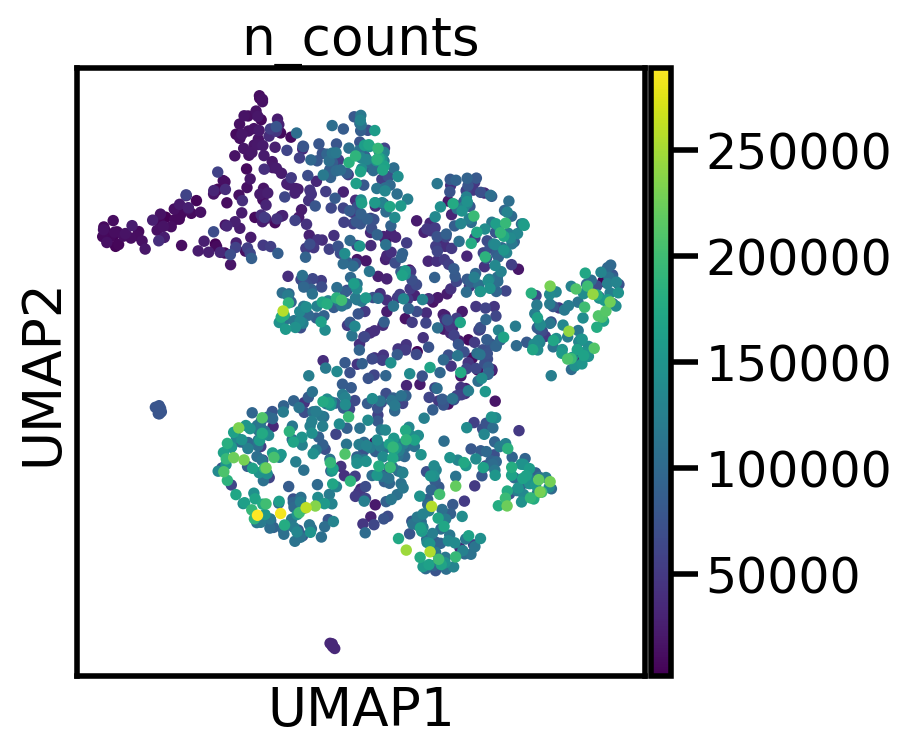

computing PCA
    on highly variable genes
    with n_comps=48
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 48
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 48
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


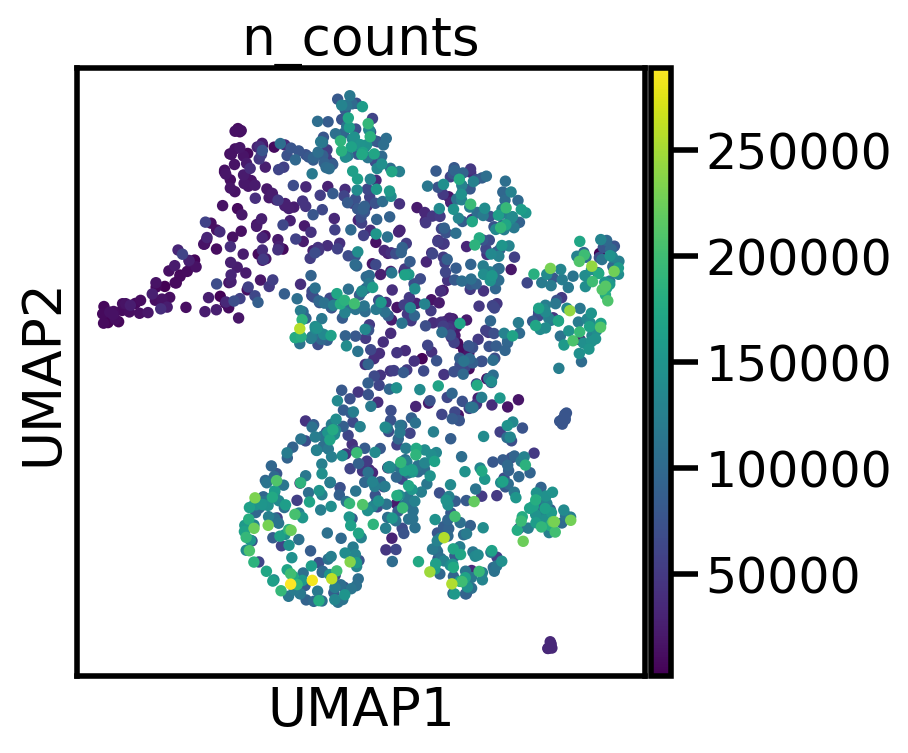

computing PCA
    on highly variable genes
    with n_comps=49
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 49
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 49
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


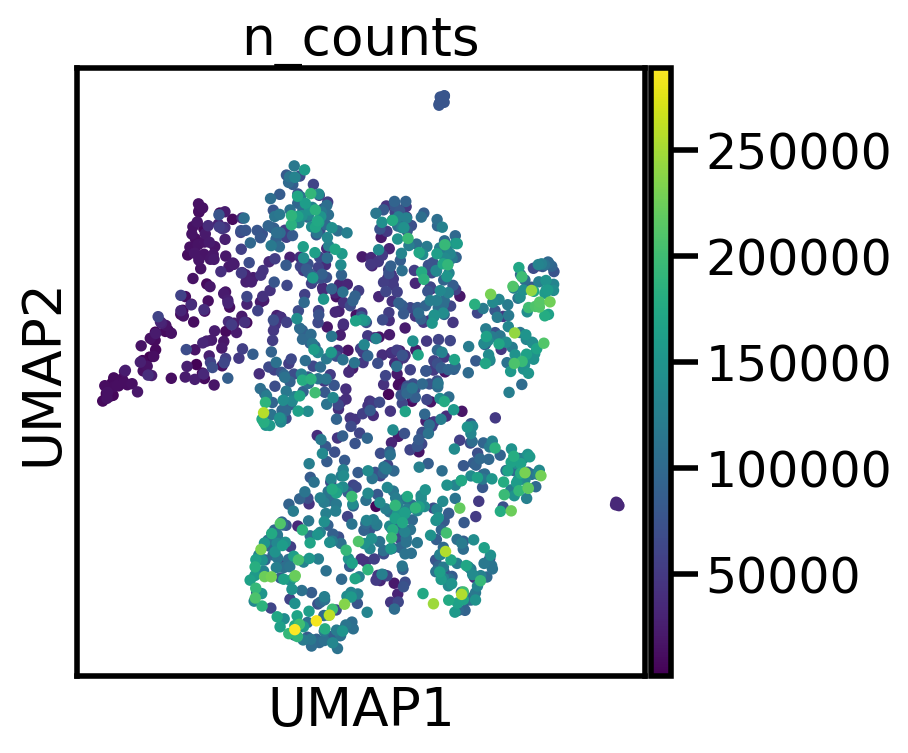

In [54]:
rcParams['figure.figsize']=(5,5)

for n in range(2,50):
    sc.pp.pca(adata, n_comps=n, use_highly_variable=True, svd_solver='arpack')
    sc.pp.neighbors(adata)
    sc.tl.tsne(adata) #Note n_jobs works for MulticoreTSNE, but not regular implementation)
    sc.tl.umap(adata)
    sc.pl.umap(adata, color='n_counts', save = 'UMIs/pc_componets/pc_'+ str(n) + '.png')

In [41]:
# Perform clustering - using highly variable genes
sc.tl.louvain(adata, resolution=5, key_added='louvain_r5')
sc.tl.louvain(adata, resolution=3, key_added='louvain_r3')
sc.tl.louvain(adata, resolution=2, key_added='louvain_r2')
sc.tl.louvain(adata, resolution=1.5, key_added='louvain_r1.5')
sc.tl.louvain(adata, resolution=0.5, key_added='louvain_r0.5')
sc.tl.louvain(adata, resolution=0.3, key_added='louvain_r0.3')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 34 clusters and added
    'louvain_r5', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 25 clusters and added
    'louvain_r3', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 18 clusters and added
    'louvain_r2', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 16 clusters and added
    'louvain_r1.5', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 8 clusters and added
    'louvain_r0.5', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" p

In [42]:
#adata.obs['plate'] = well_id_filter2
#rcParams['figure.figsize']=(7,7)
#sc.pl.umap(adata, color='plate', save = 'well_id' + '.pdf')



/home/melma31/mambaforge/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


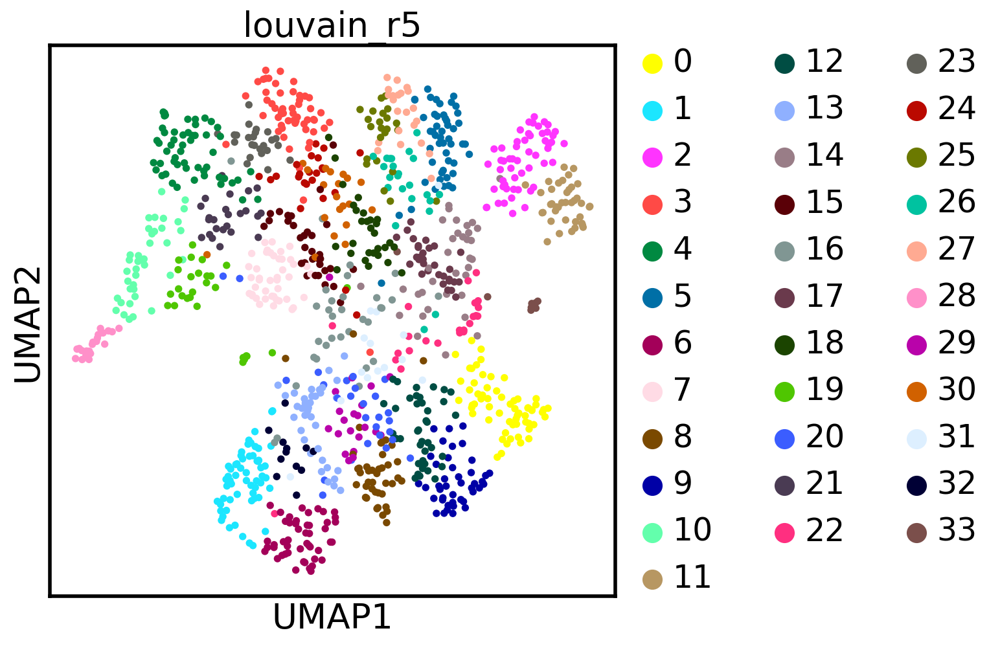

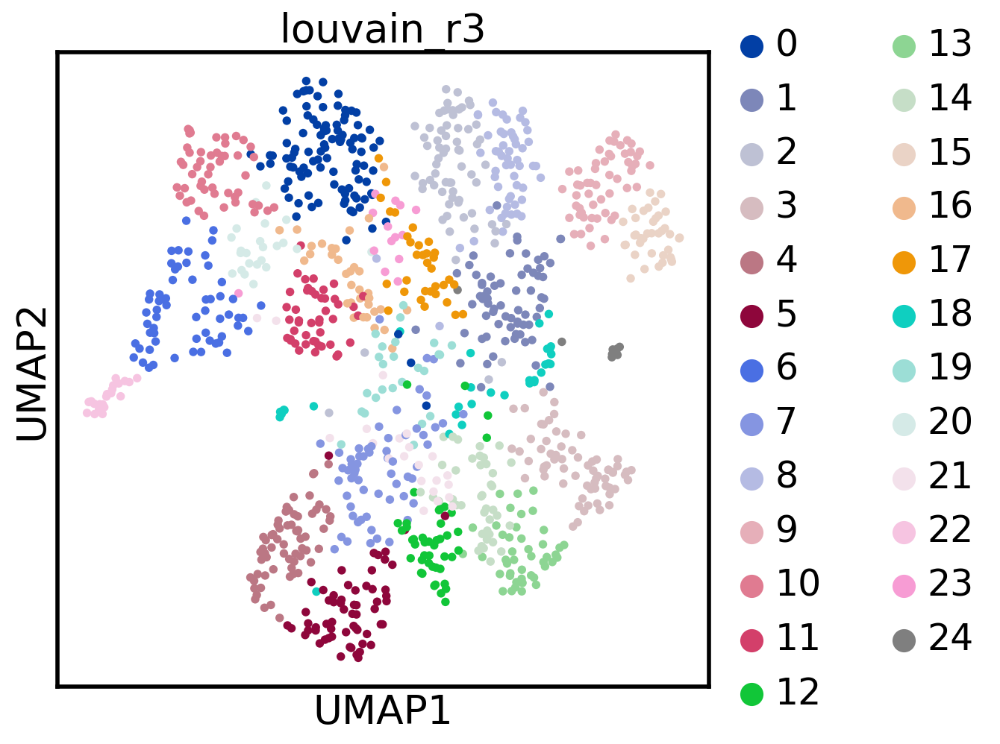

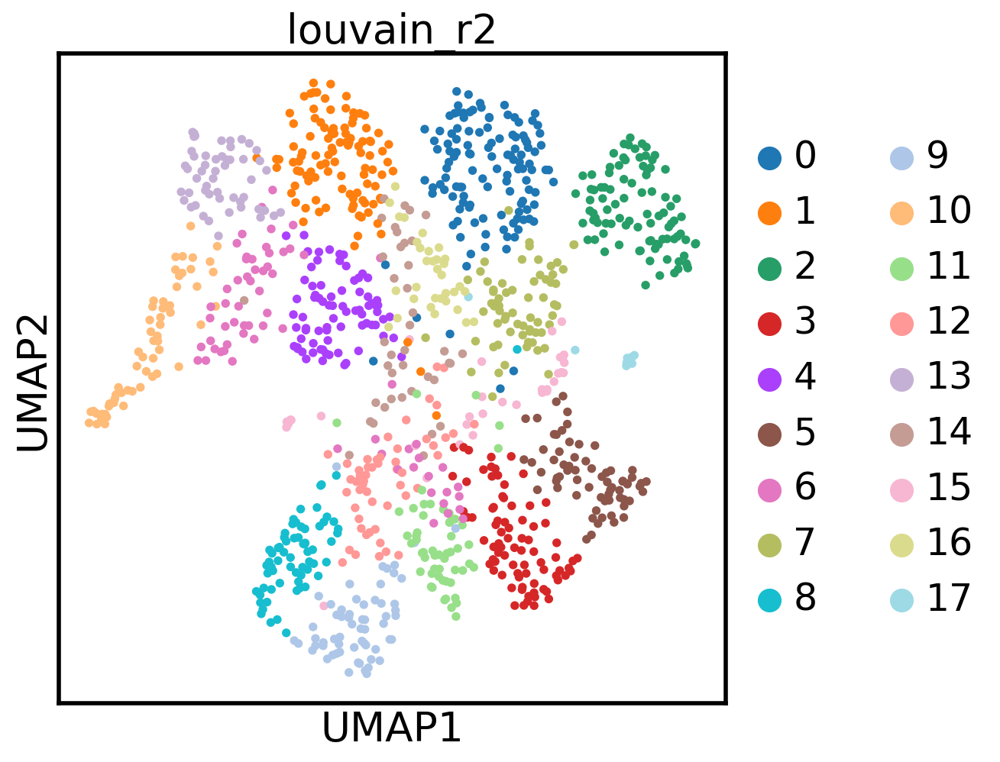

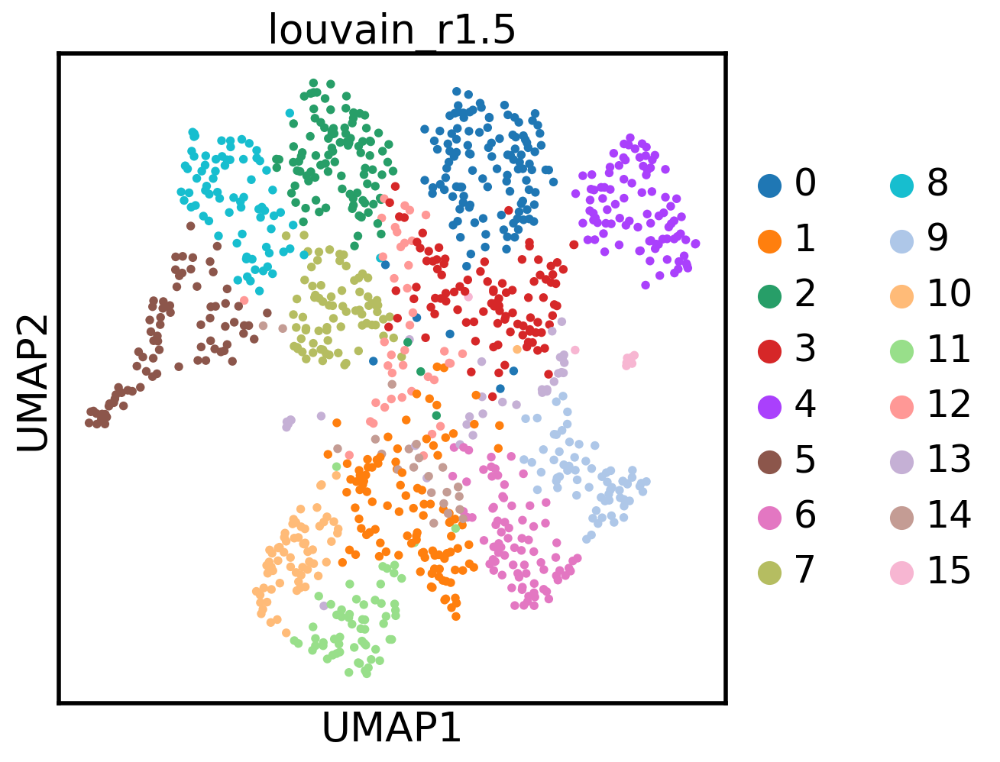

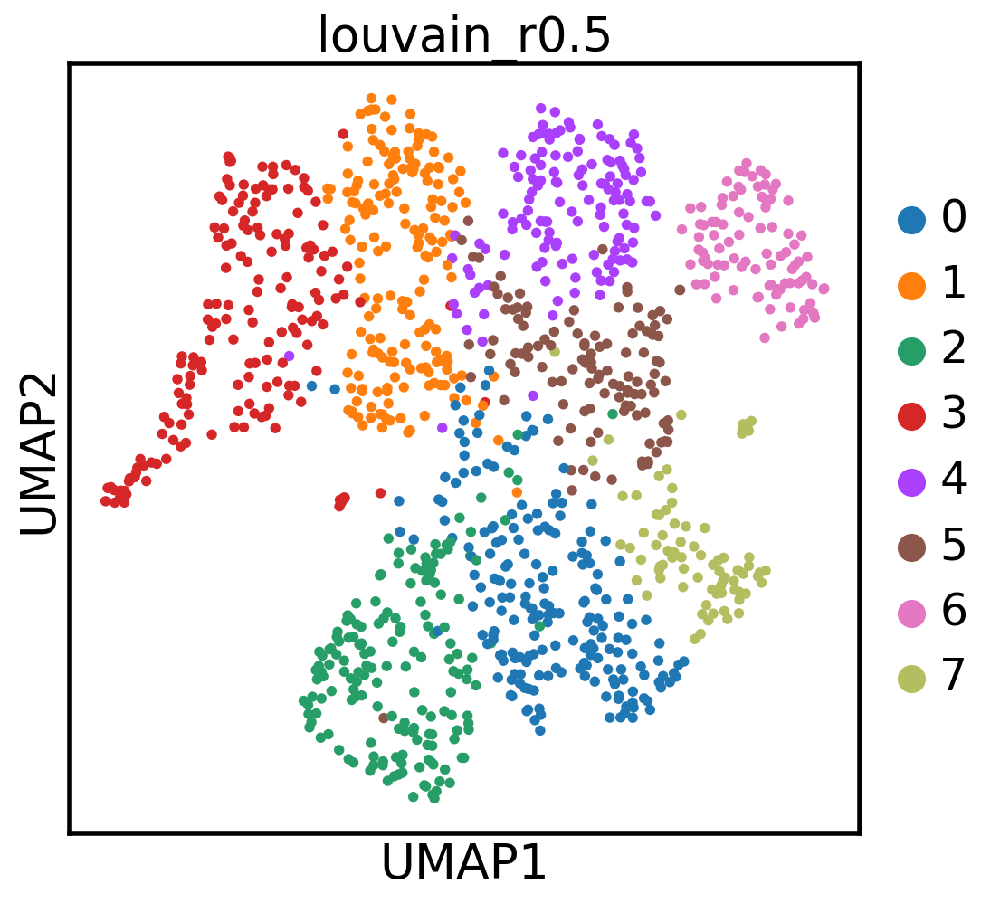

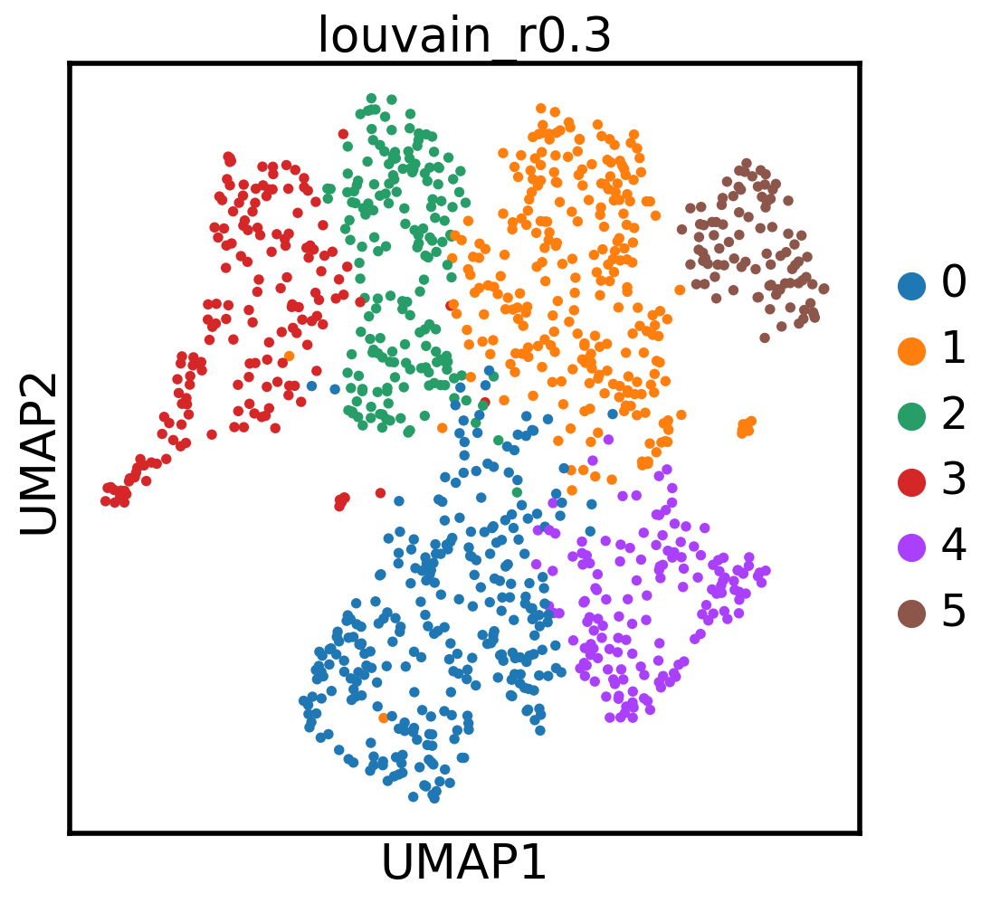

In [43]:
rcParams['figure.figsize']=(7,7)

clustering_color = ['louvain_r5','louvain_r3','louvain_r2','louvain_r1.5', 'louvain_r0.5','louvain_r0.3']

#Visualize the clustering and how this is reflected by different technical covariates
for clustering in clustering_color:
    sc.pl.umap(adata, color=clustering, save = 'UMIs/louvain/'+clustering + '.png')
#sc.pl.umap(adata, color=['log_counts','stimuli'])

In [44]:
marker_genes = ['Trpm3','Piezo2','Trpm2','Smr2','Sstr2','Bmpr1b','Trpm8','Trpv1','Piezo2','Piezo1','Nppb',
                'Sst','Pvalb','Prokr2','Mrgprd','Mrgpra3','Cd34',
                'Th','Trpa1','Ntrk3','Ntrk2','Ntrk1','Ret','Tac1','Calca','Calcb','Nefh',
                'S100b','Scn10a','Slc17a8','Atf3','Pou4f3','Calb1','Calb2','Avil','Asic3',
                'Asic2','Asic1','Pou6f2','Avpr1a','Pou4f2','Sox10','Casq2','Chrna7','Chrna3',
                'P2rx3','Gfra2','Ldhb','Necab2','Spp1']


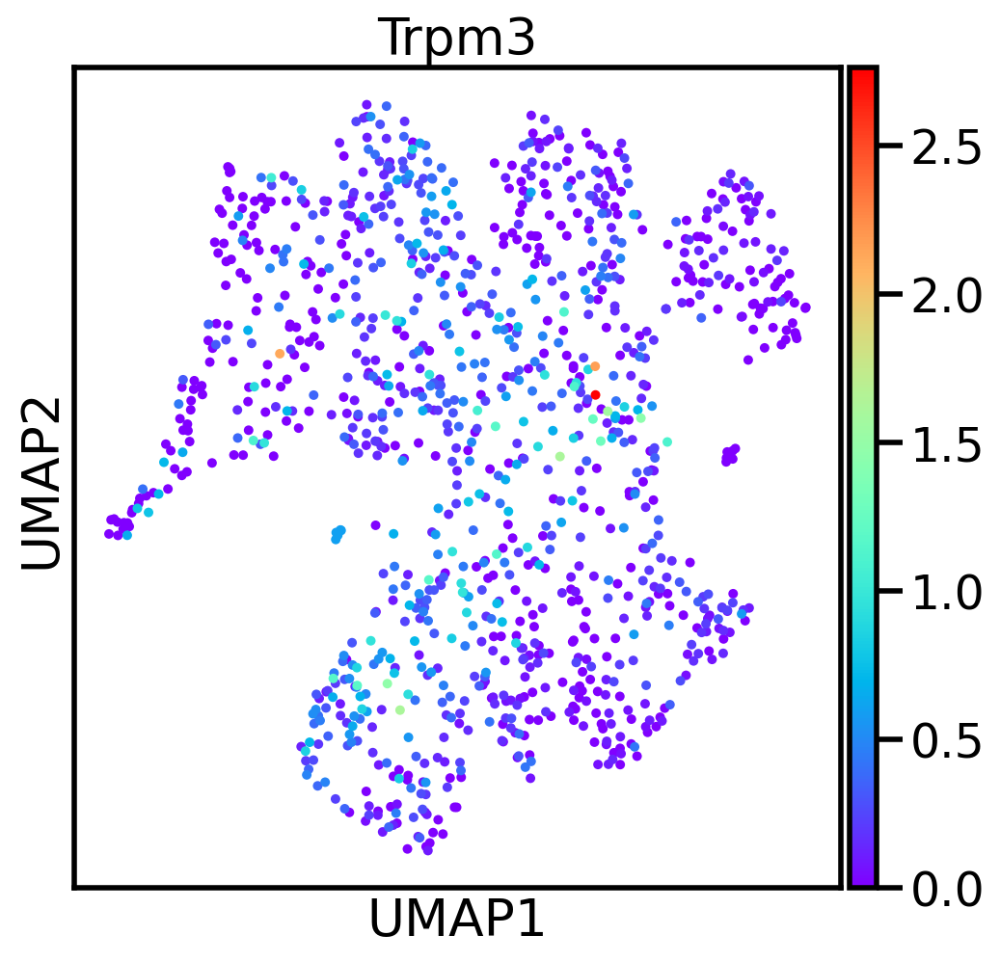

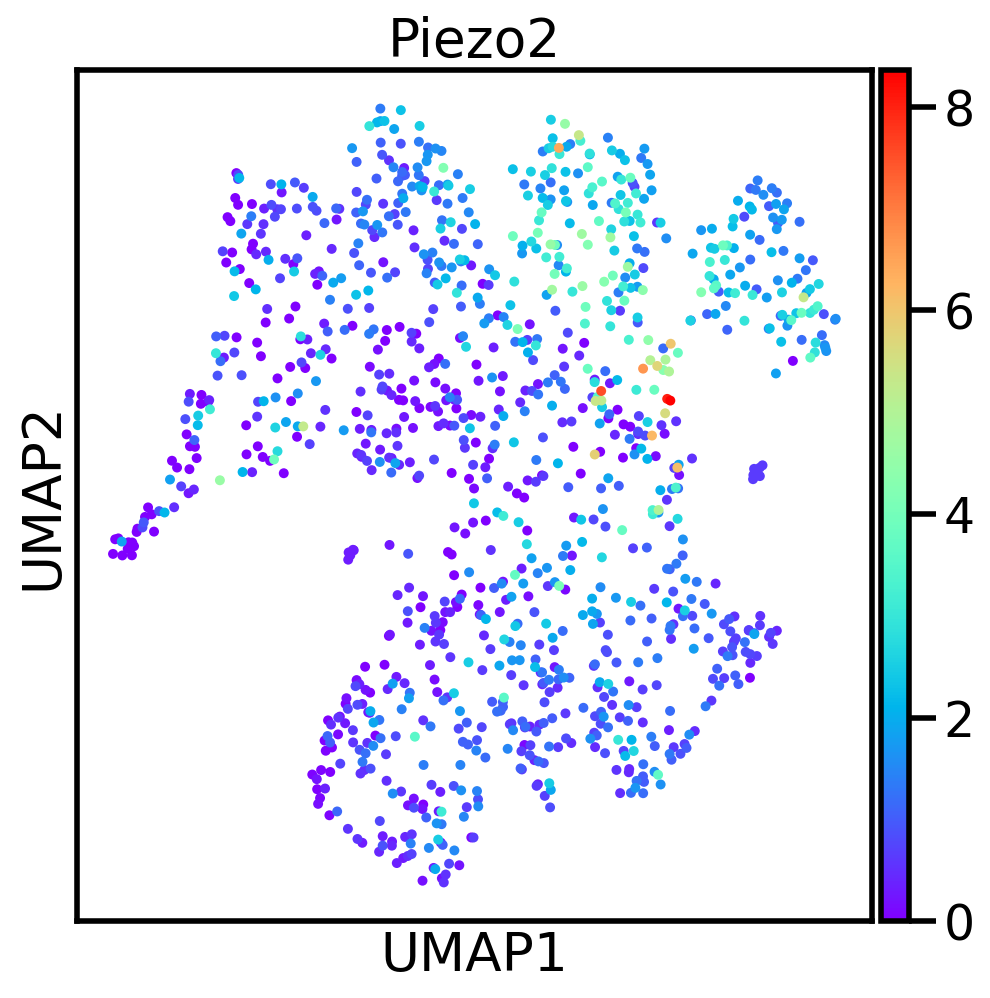

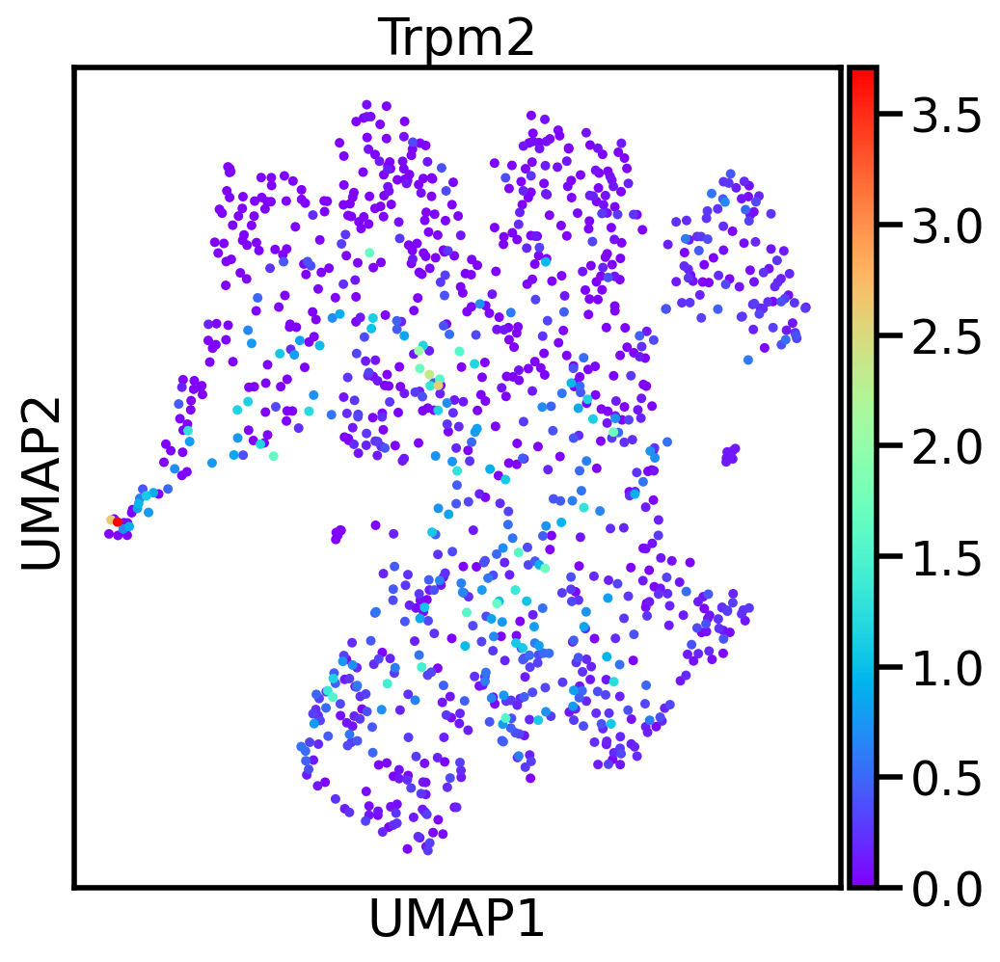

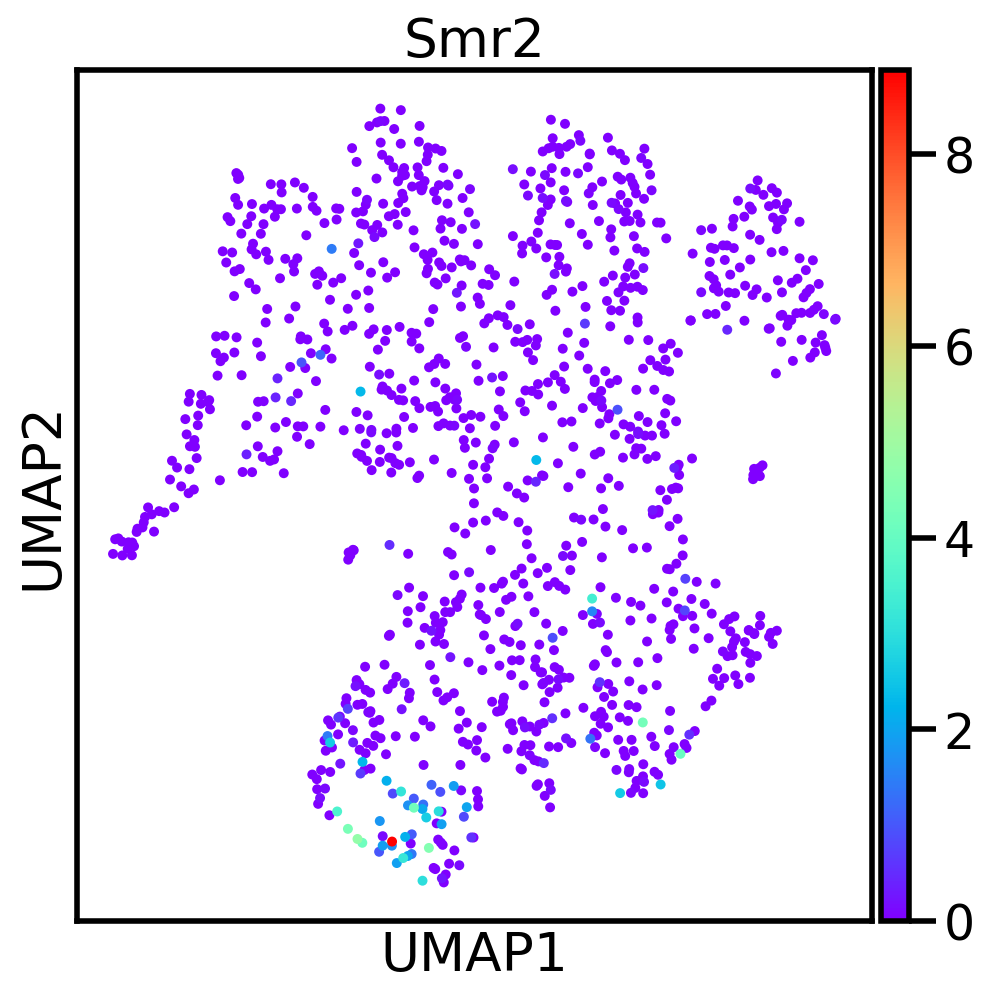

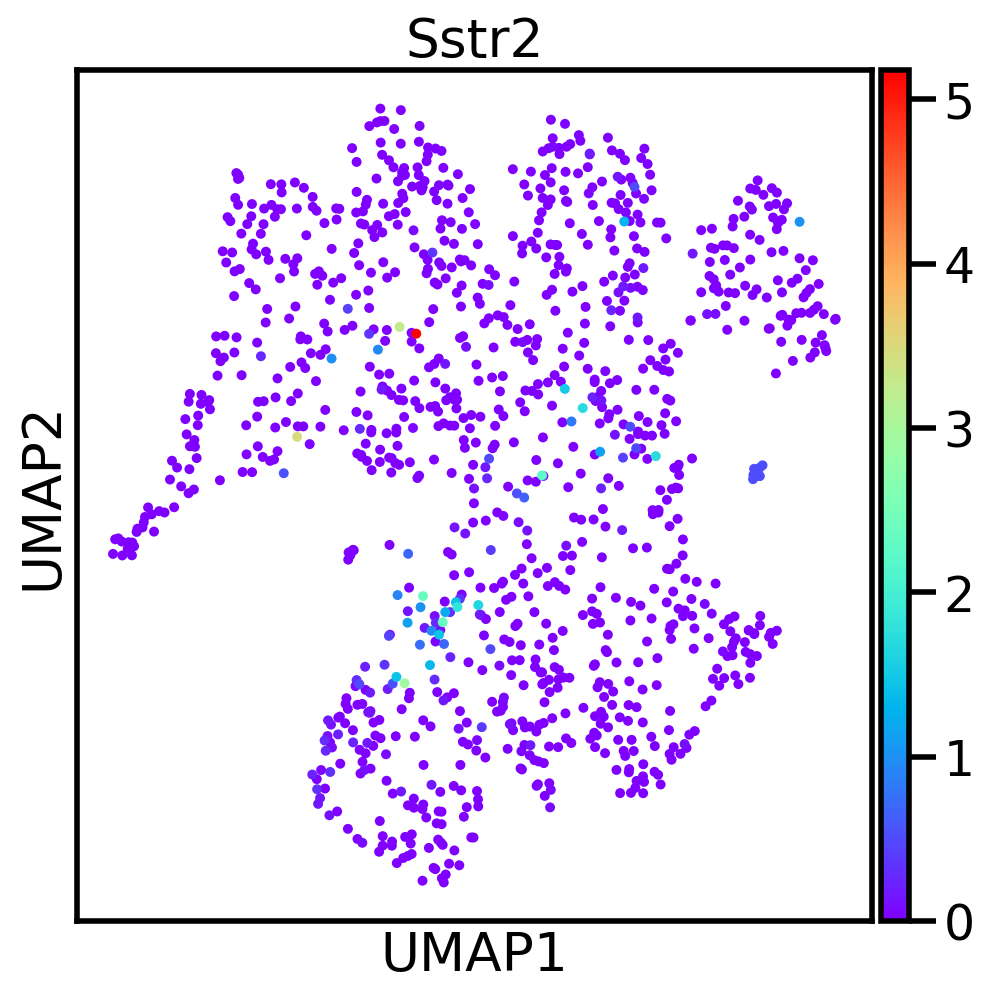

...

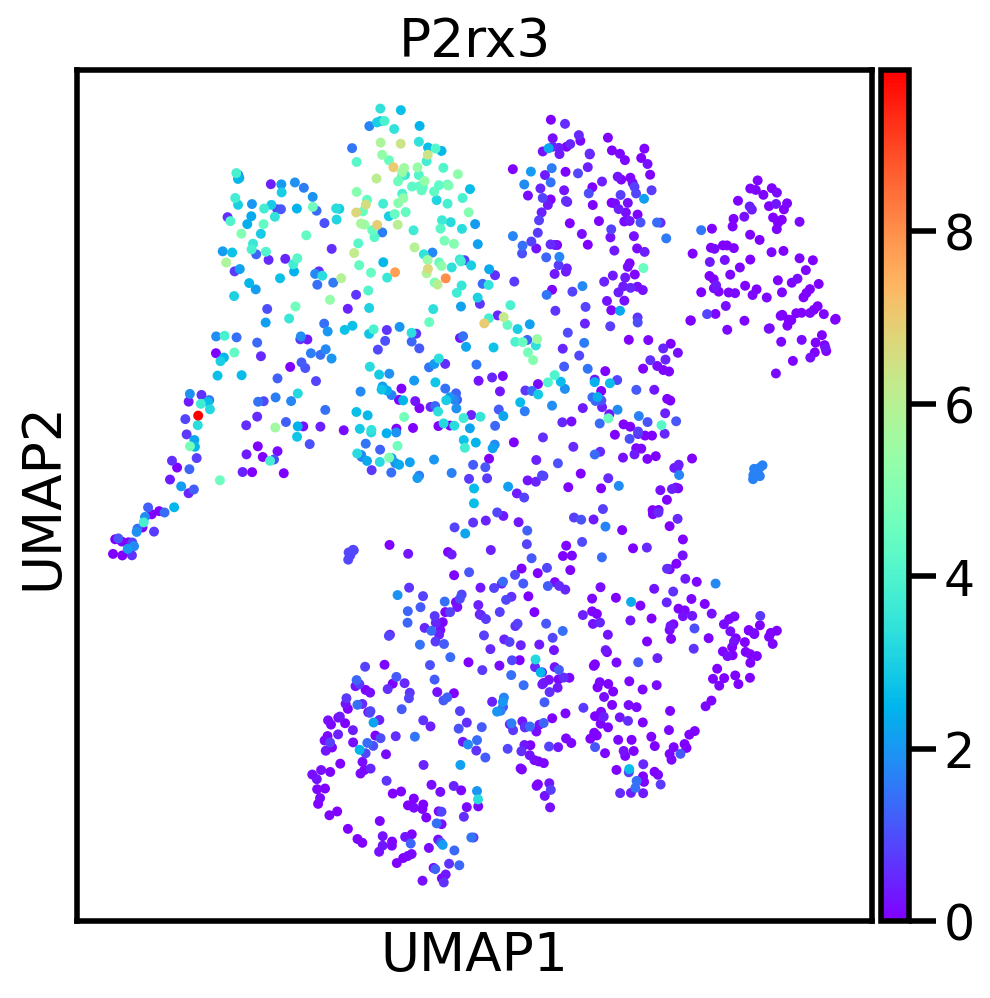

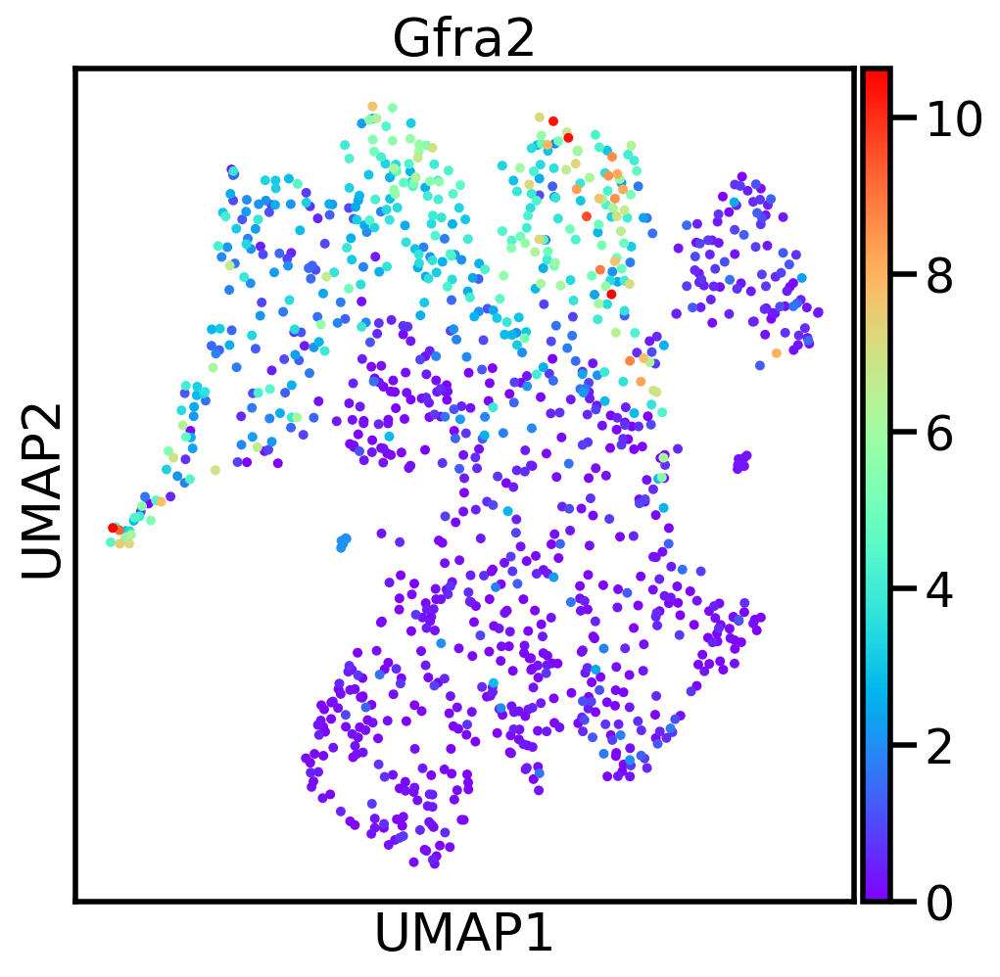

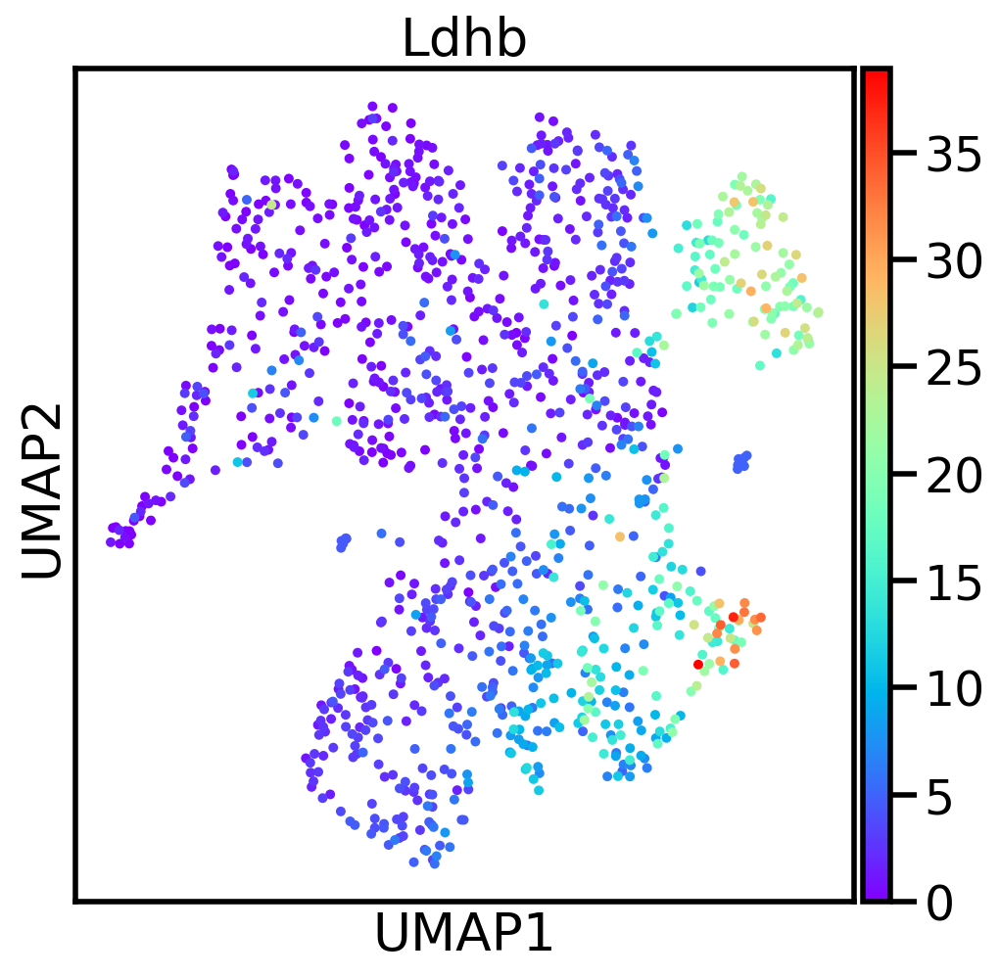

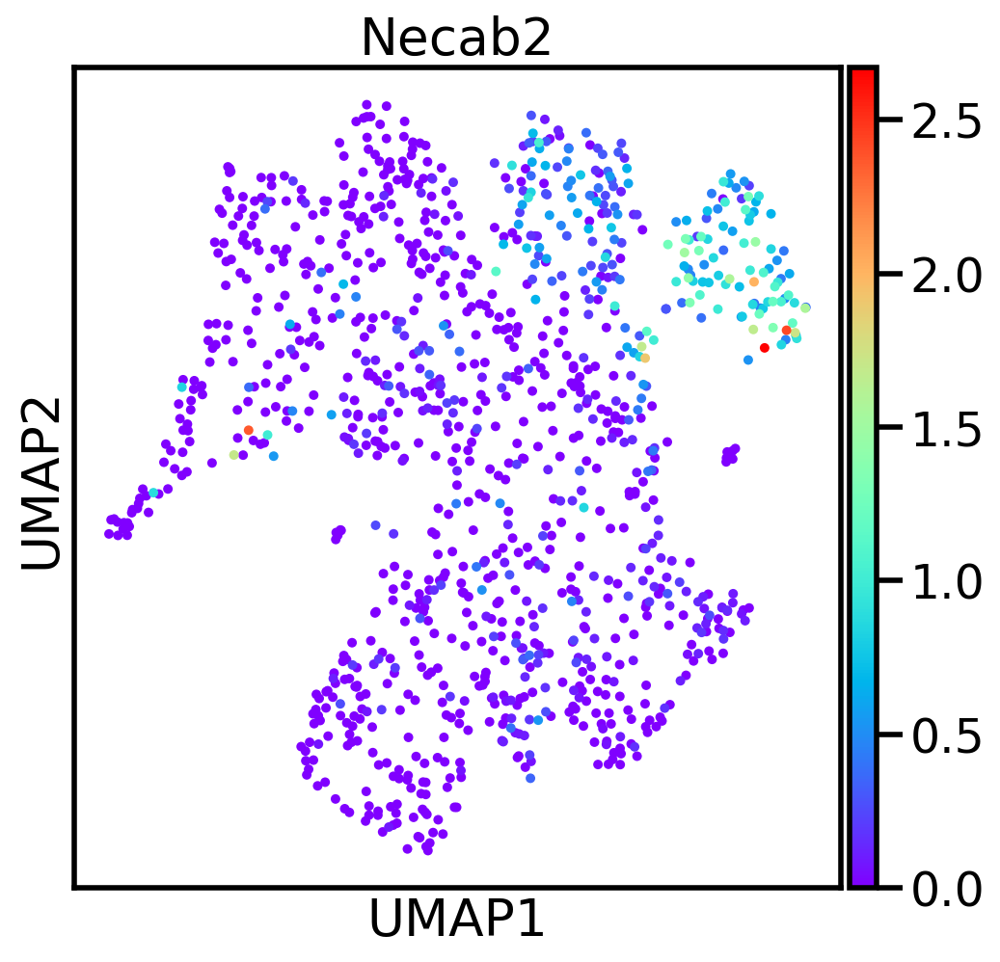

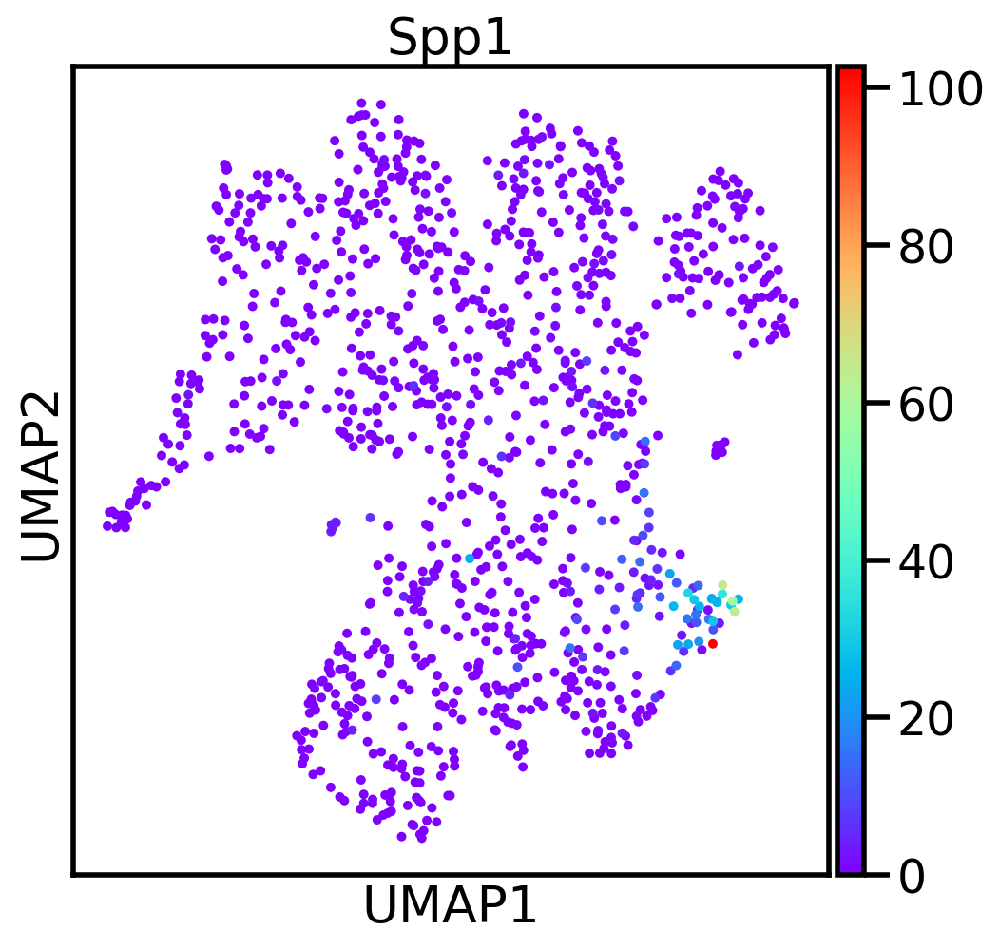

In [45]:

rcParams['figure.figsize']=(7,7)

np.in1d(marker_genes, adata.var_names)
for gene in marker_genes:
    sc.pl.umap(adata=adata, color=gene, use_raw=False, cmap = 'rainbow',save = 'UMIs/expression/genes_' + gene + '.png', size = 80)

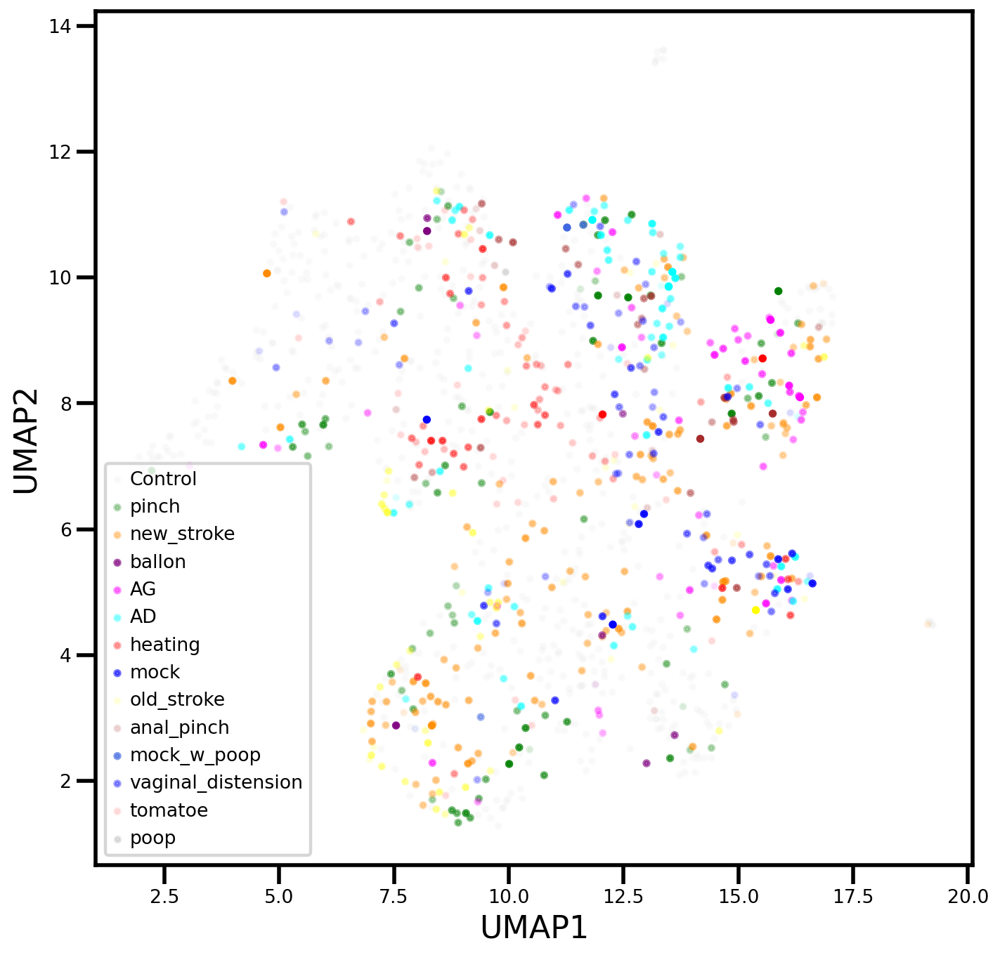

In [56]:
import scipy

rcParams['figure.figsize']=(7,7)

labels=['Control','pinch','new_stroke','ballon','AG','AD','heating','mock','old_stroke','anal_pinch','mock_w_poop','vaginal_distension','tomatoe','poop']

x = scipy.sparse.csr_matrix.toarray(adata.X)

stim = np.zeros((x.shape[0],))
red = np.zeros((x.shape[0],))
green = np.zeros((x.shape[0],))
for i in range(x.shape[0]):
    stim[i] = adata.obs['stimulus'][i]
    red[i] = adata.obs['red'][i]
    green[i] = adata.obs['green'][i]


color = ['gainsboro','green','darkorange','purple','magenta','cyan','red','blue','yellow','brown','royalblue','b','r','k']

import matplotlib.pyplot as plt
import sys 

figure, axes = plt.subplots()
#red_norm = (red - np.min(red)) / (np.max(red) - np.min(red))

for i in range(14):
    index = np.where(stim == i)[0]
    red_norm = (red[index] - np.min(red[index])) / (np.max(red[index]) - np.min(red[index]) + sys.float_info.epsilon)
    red_norm = (red_norm + 0.1)/1.1
    axes.scatter(adata.obsm['X_umap'][index,0],adata.obsm['X_umap'][index,1], s = 10, c = color[i], alpha = red_norm)

axes.grid(visible = 'None')
#axes.set_xlim([0,19])
#axes.set_ylim([0,19])
axes.set_xlabel('UMAP1', fontsize = 20)
axes.set_ylabel('UMAP2', fontsize = 20)
axes.tick_params(axis='both', which='major', labelsize=12)
axes.tick_params(axis='both', which='minor', labelsize=12)
axes.grid(False)

axes.legend(labels, fontsize = 12)
#sc.pl.umap(adata, color = 'stimulus', color_map = 'Set1', save = 'stimulus'+ '.png', size = 180)

figure.set_size_inches([10,10])
figure.savefig(figure_path + 'stimulus.png')

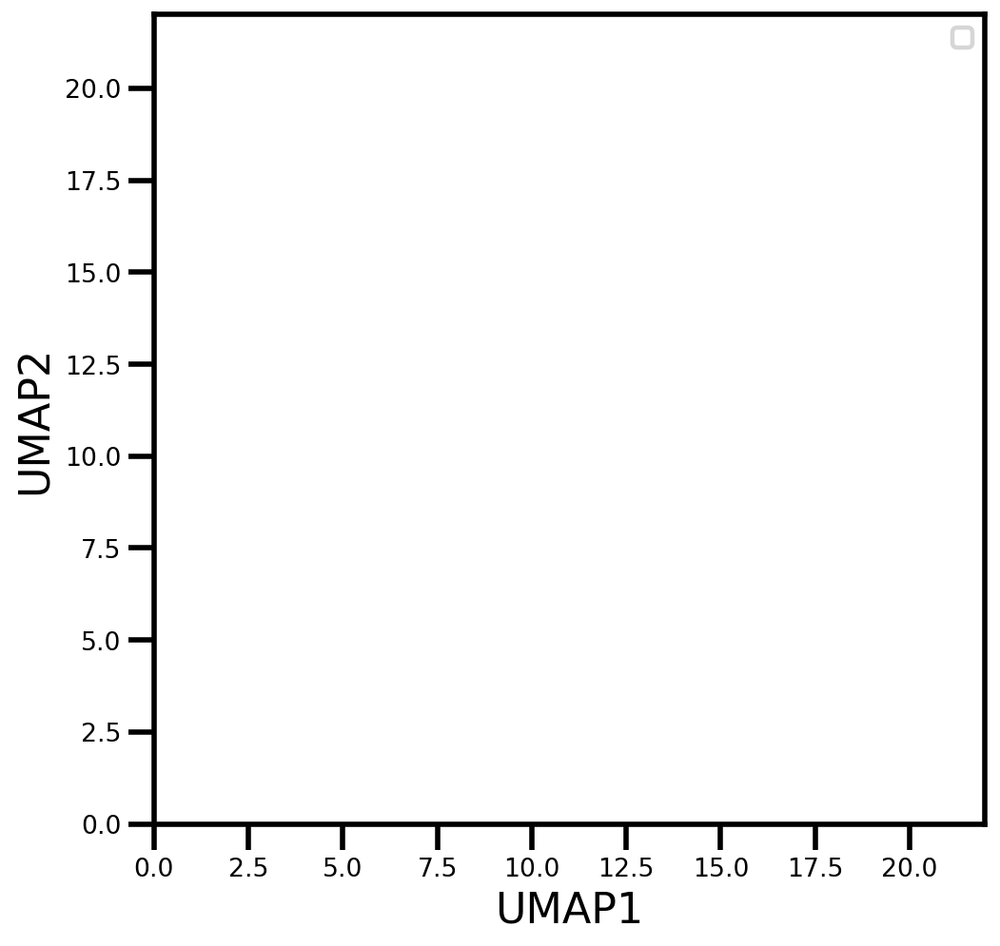

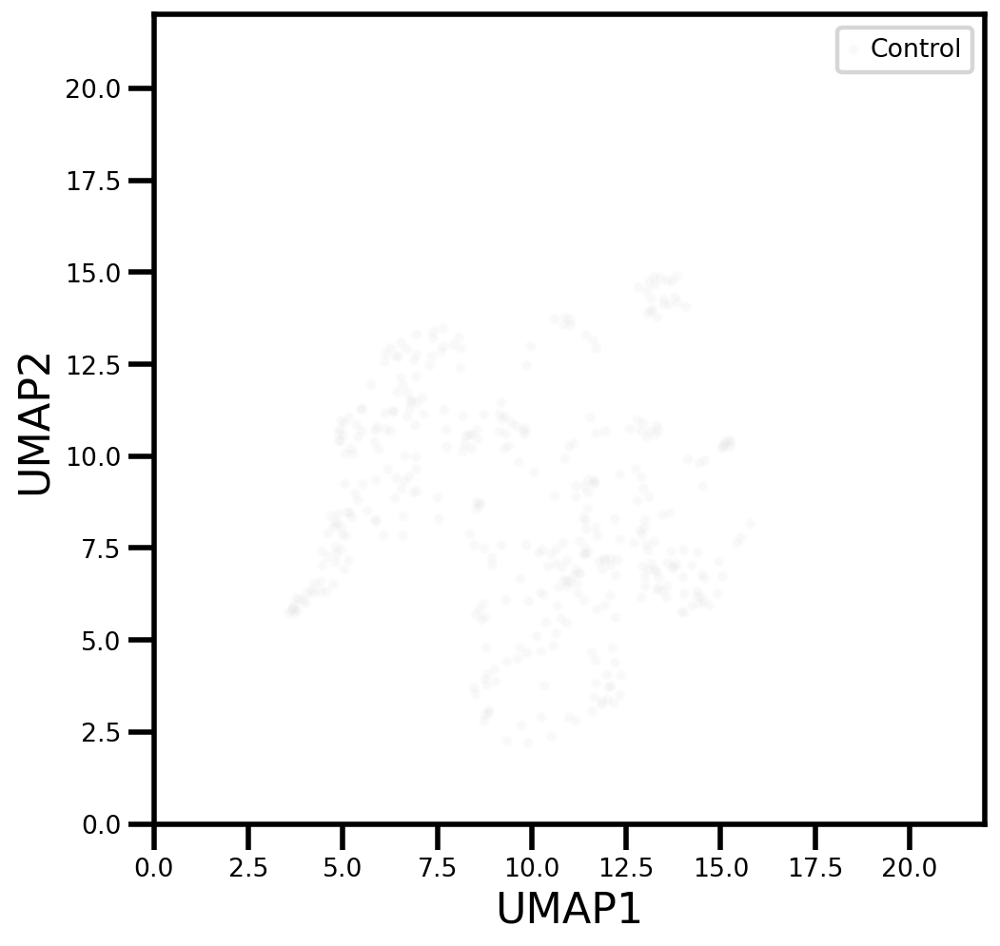

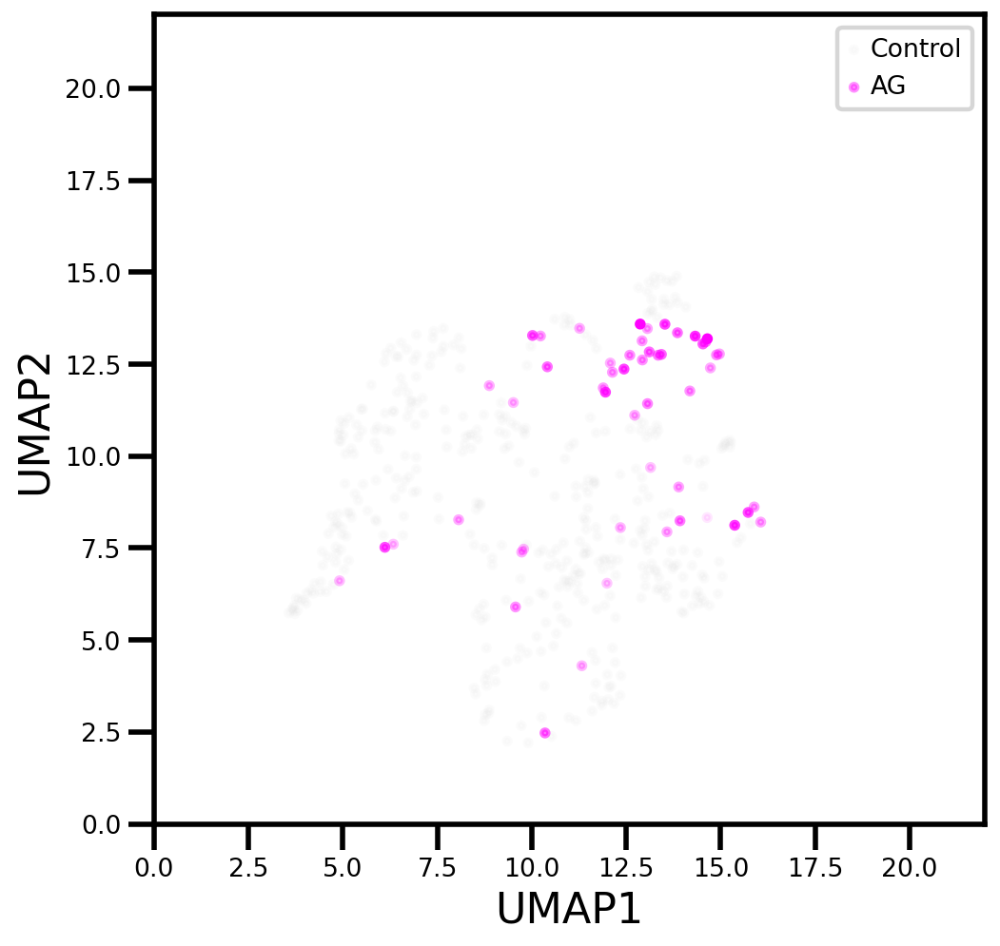

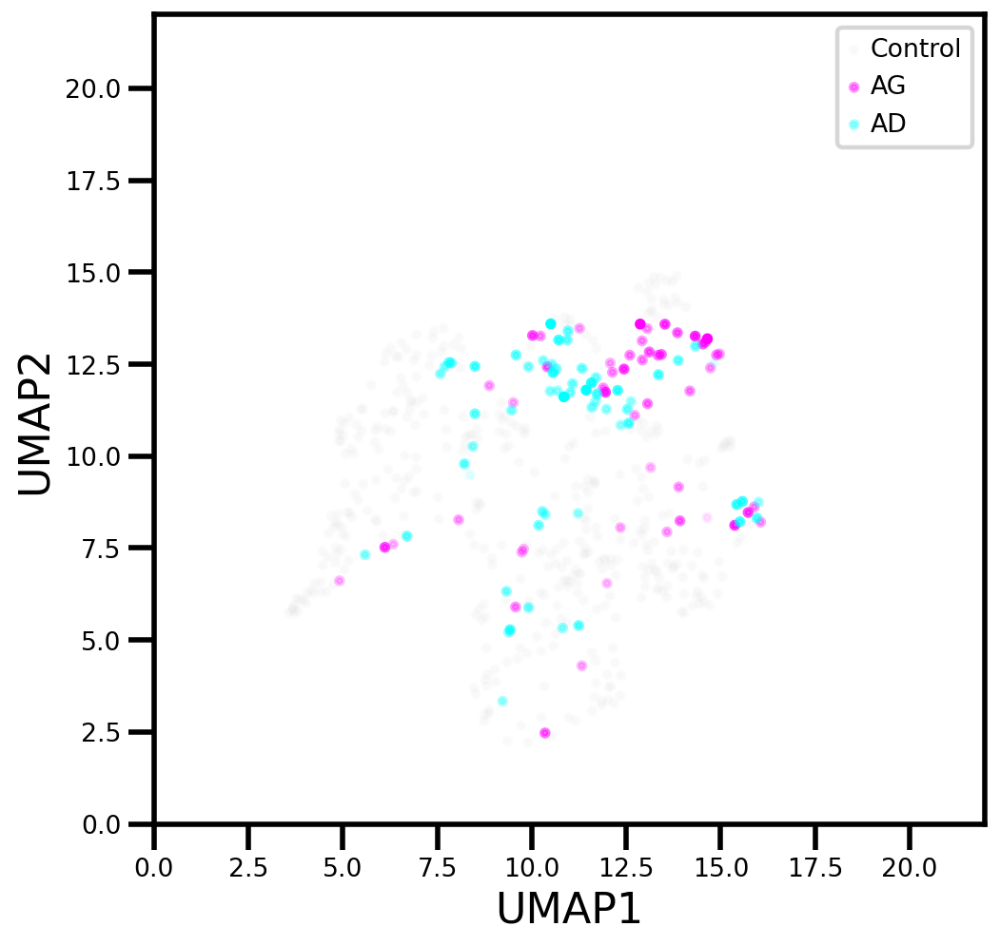

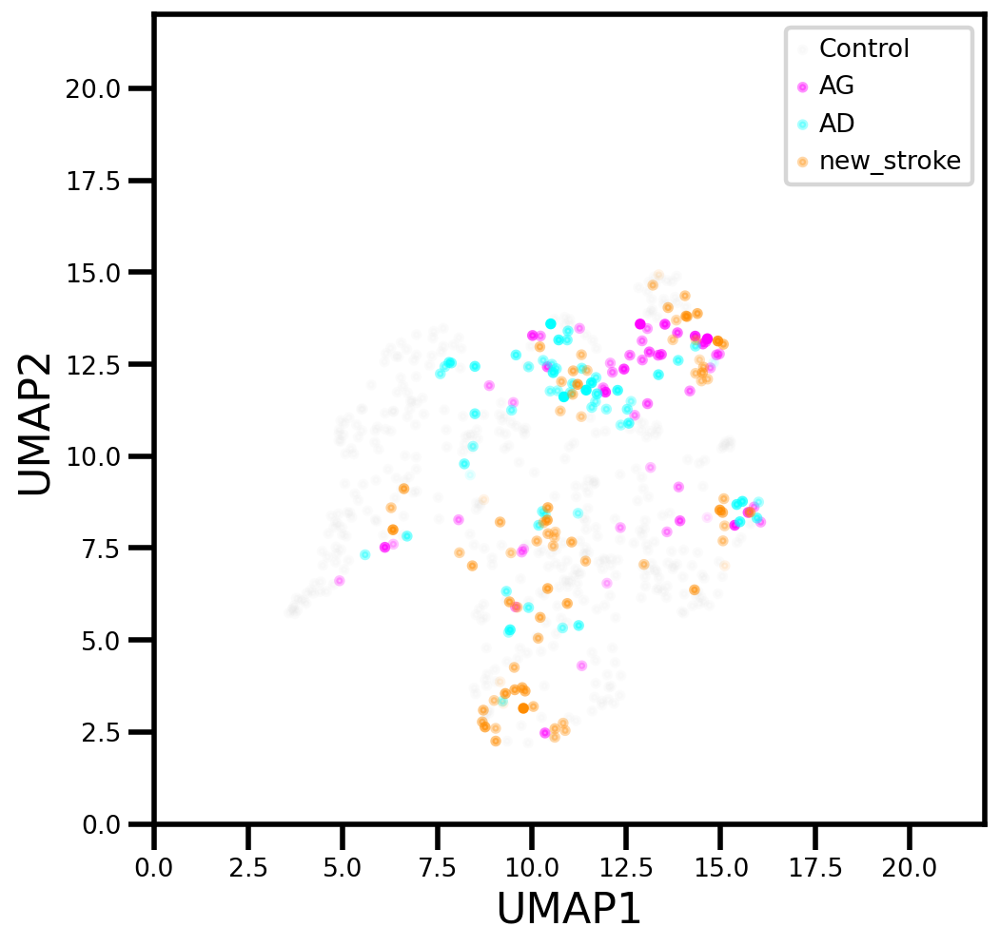

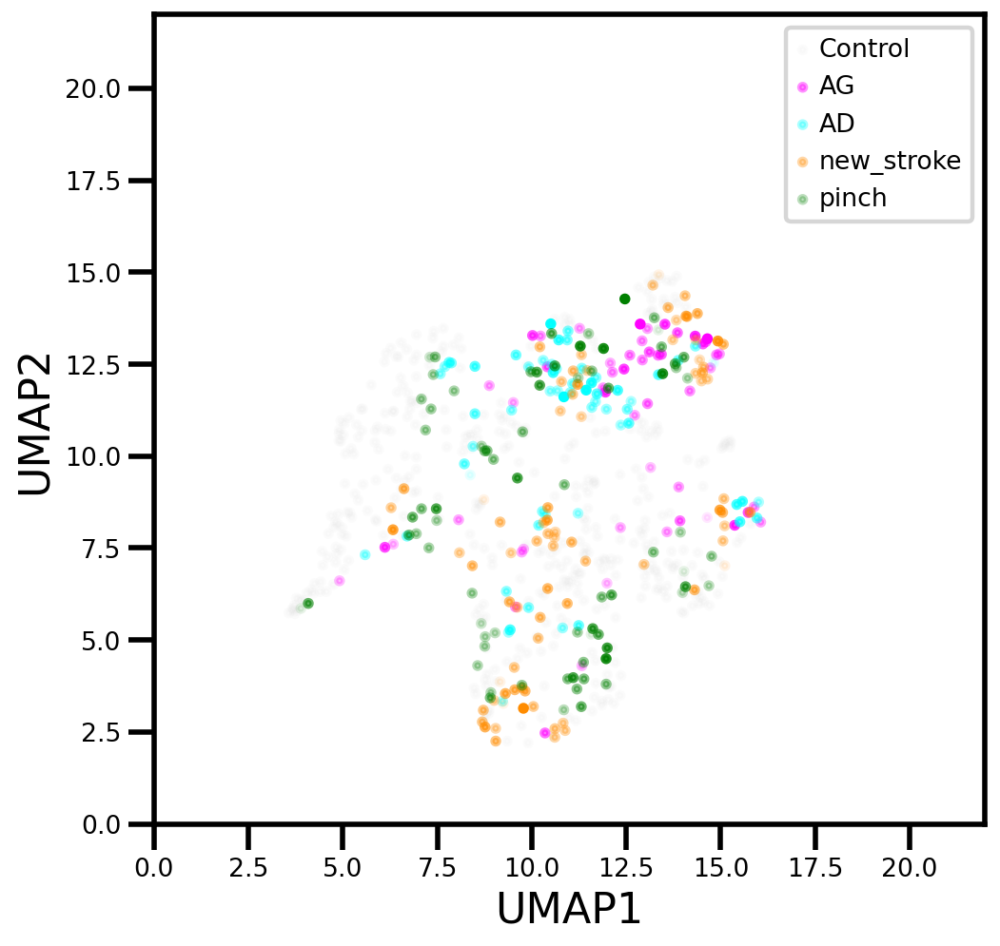

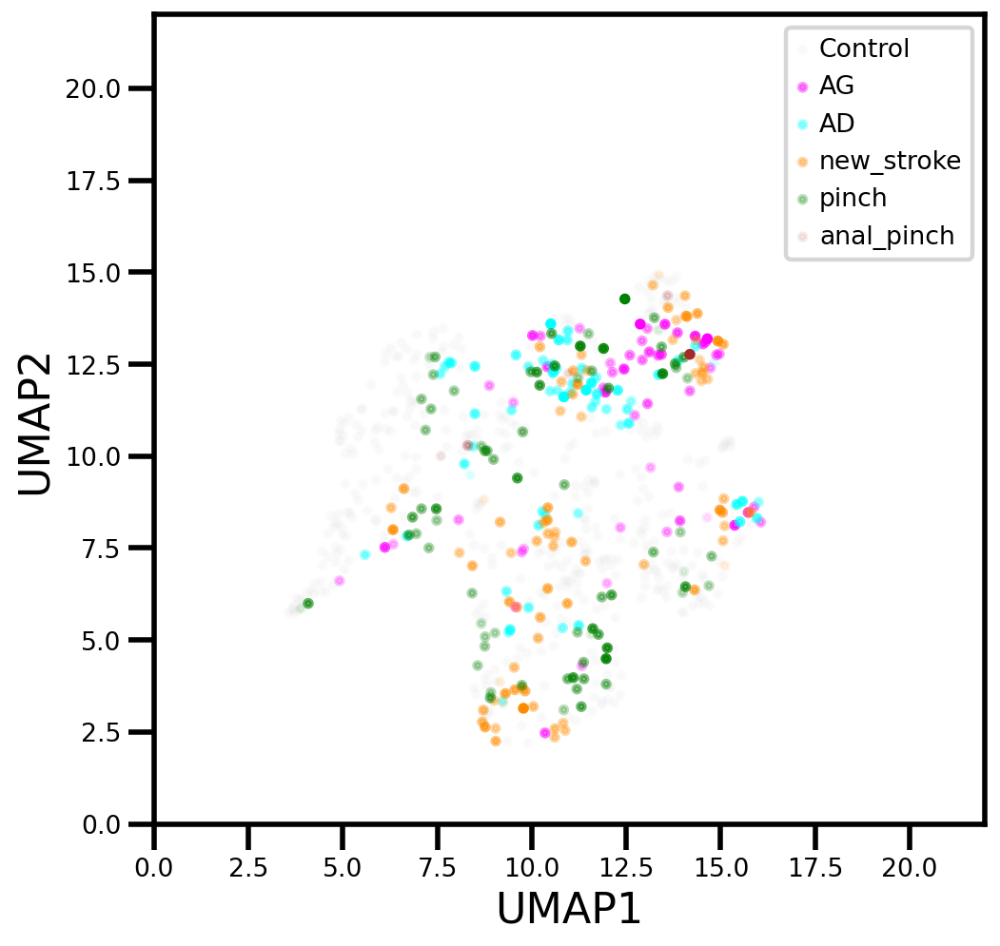

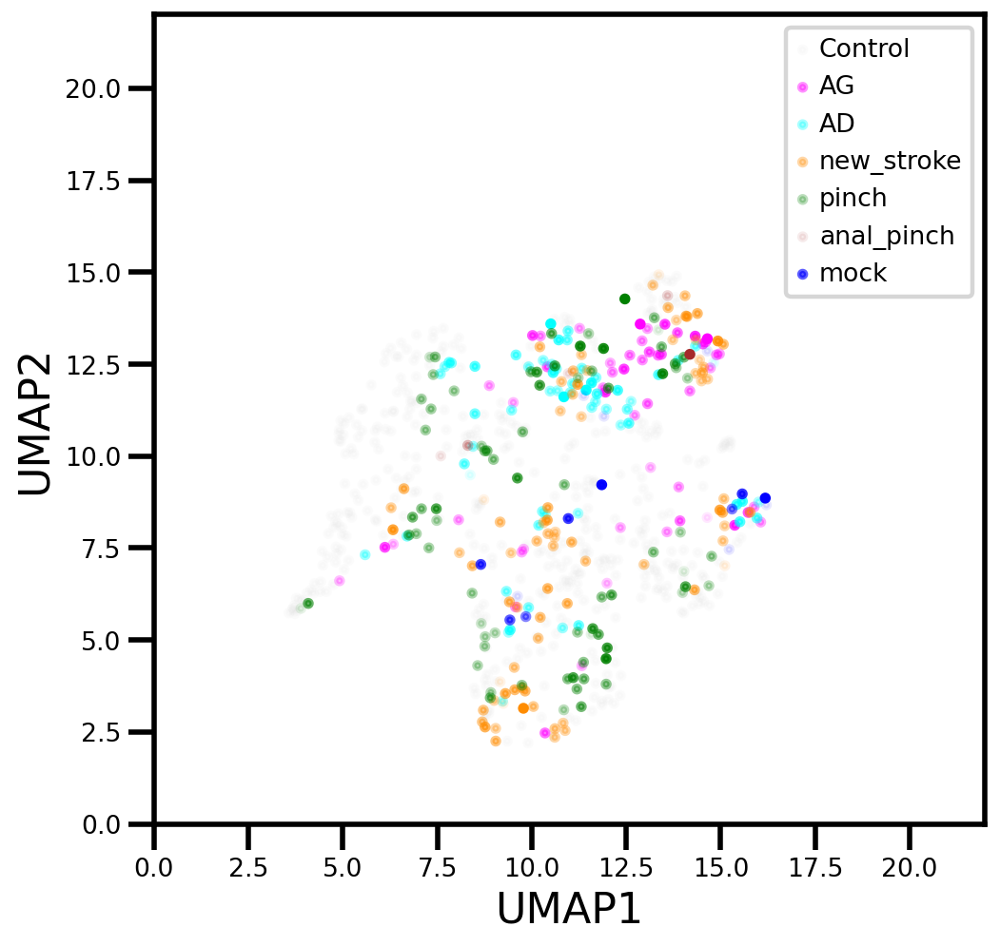

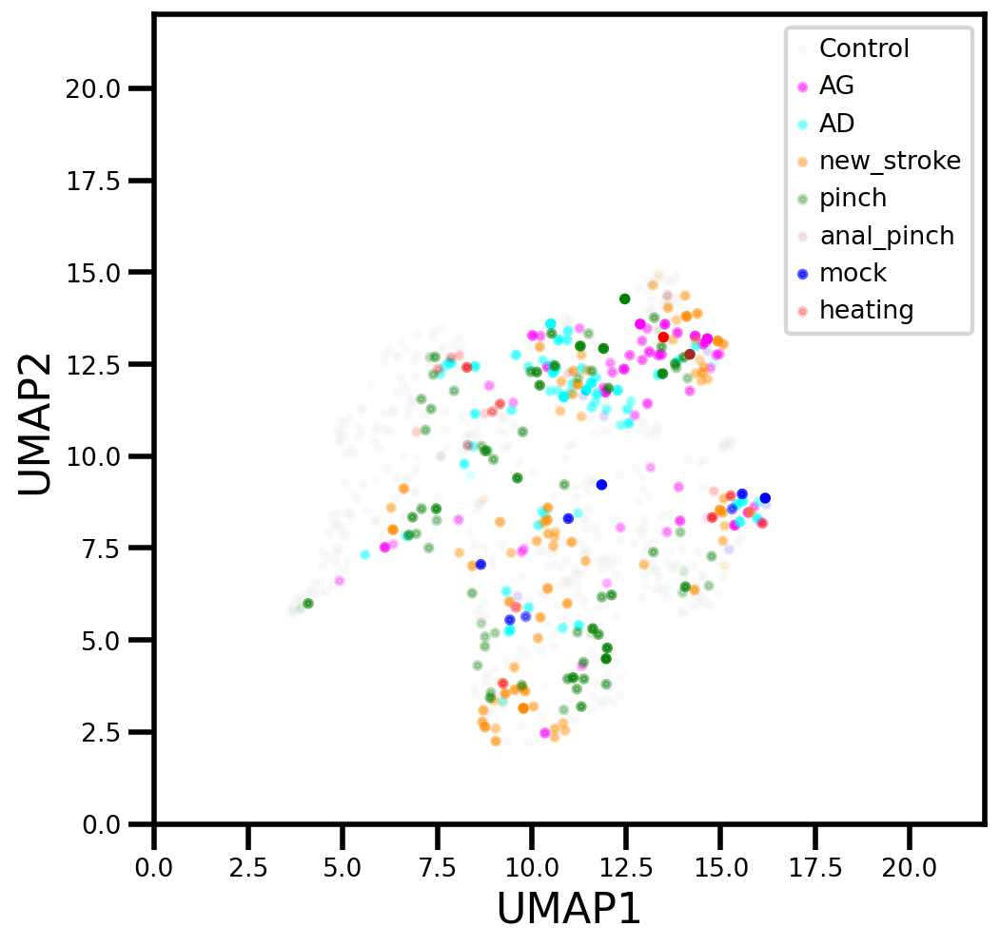

In [41]:
stimulus_list = [0,4,5,2,1,9,7,6,3]
new_labels=['Control','AG','AD','new_stroke','pinch','anal_pinch','mock','heating','ballon']

count = 0
for i in stimulus_list:
    
    figure, axes = plt.subplots()

    sublist = stimulus_list[0:count]
    for j in sublist:
        index = np.where(stim == j)[0]
        red_norm = (red[index] - np.min(red[index])) / (np.max(red[index]) - np.min(red[index]) + sys.float_info.epsilon)
        red_norm = (red_norm + 0.1)/1.1
        axes.scatter(adata.obsm['X_umap'][index,0],adata.obsm['X_umap'][index,1], s = 10, c = color[j],alpha = red_norm)

    axes.grid(visible = 'None')
    axes.set_xlim([0,22])
    axes.set_ylim([0,22])
    axes.set_xlabel('UMAP1', fontsize = 20)
    axes.set_ylabel('UMAP2', fontsize = 20)
    axes.tick_params(axis='both', which='major', labelsize=12)
    axes.tick_params(axis='both', which='minor', labelsize=12)
    axes.grid(False)

    axes.legend(new_labels, fontsize = 12)

    figure.set_size_inches([7,7])
    figure.savefig(figure_path + 'cum_stimulus'+ str(count) +'.png')

    count = count +1 

In [42]:
sublist

[0, 4, 5, 2, 1, 9, 7, 6]

(629, 25930)


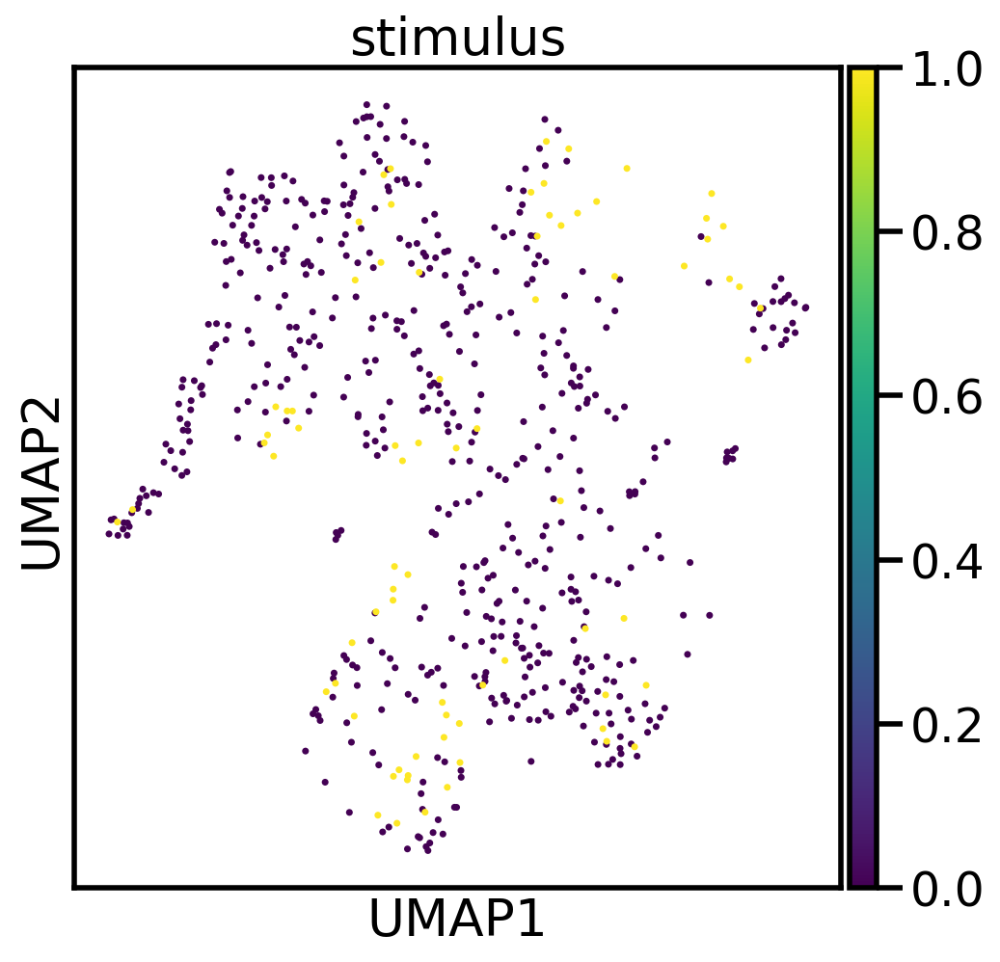

(686, 25930)


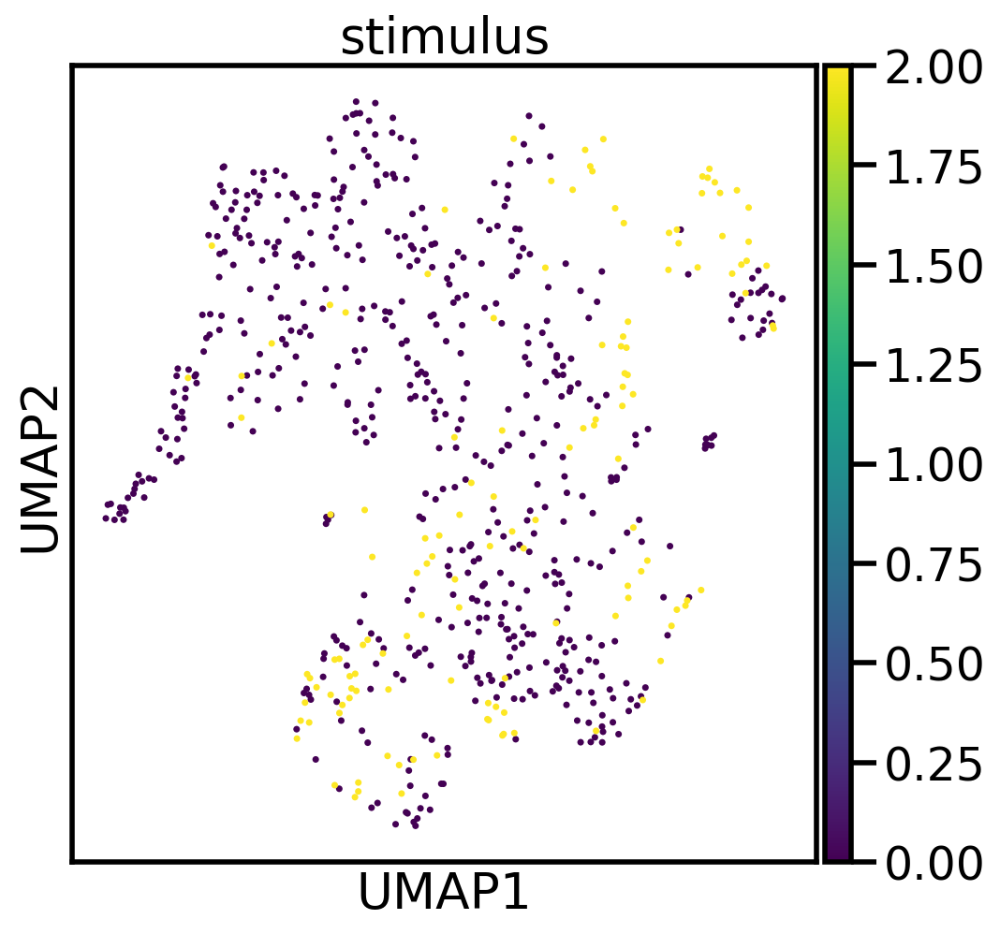

(561, 25930)


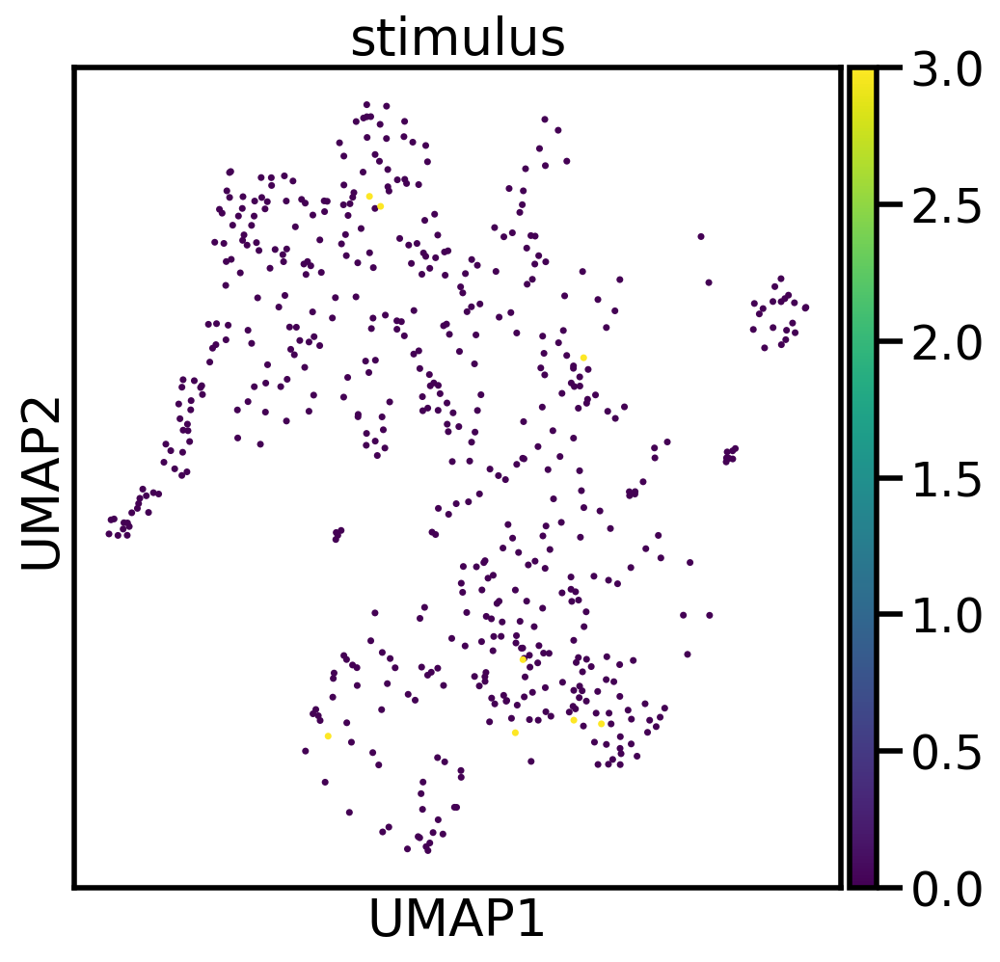

(604, 25930)


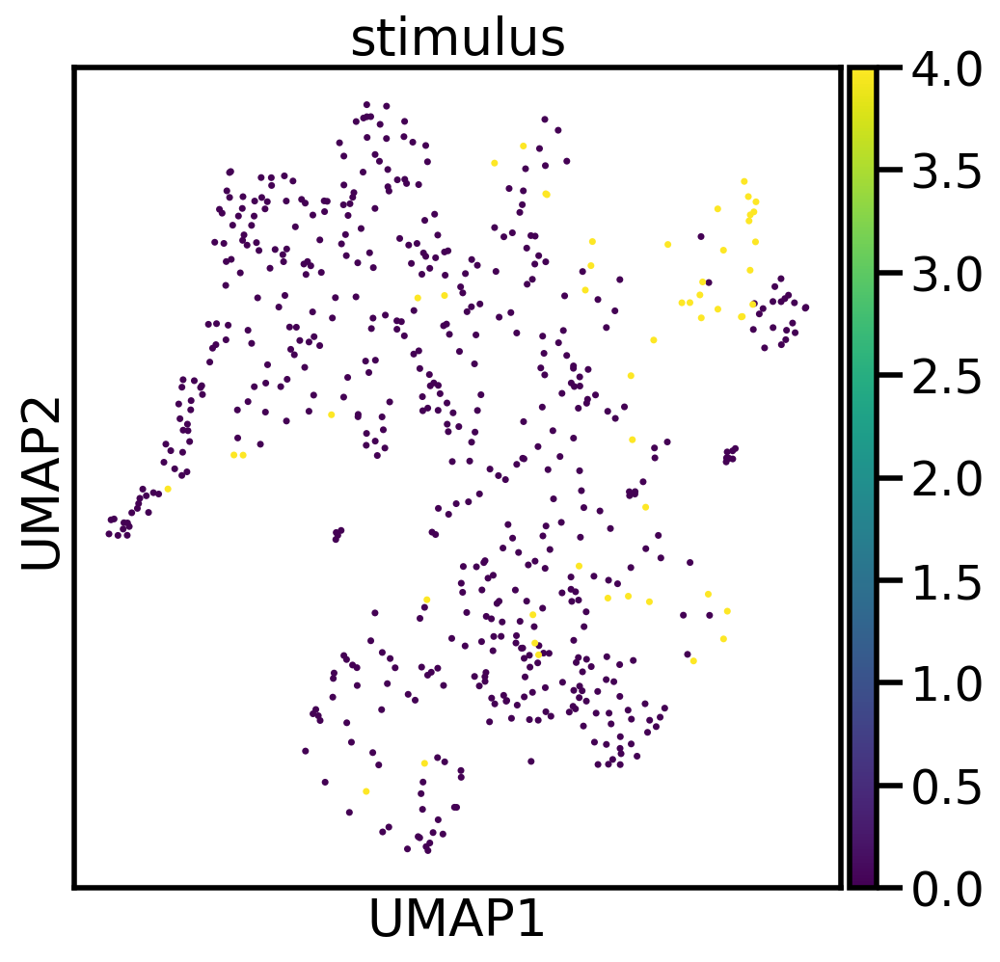

(614, 25930)


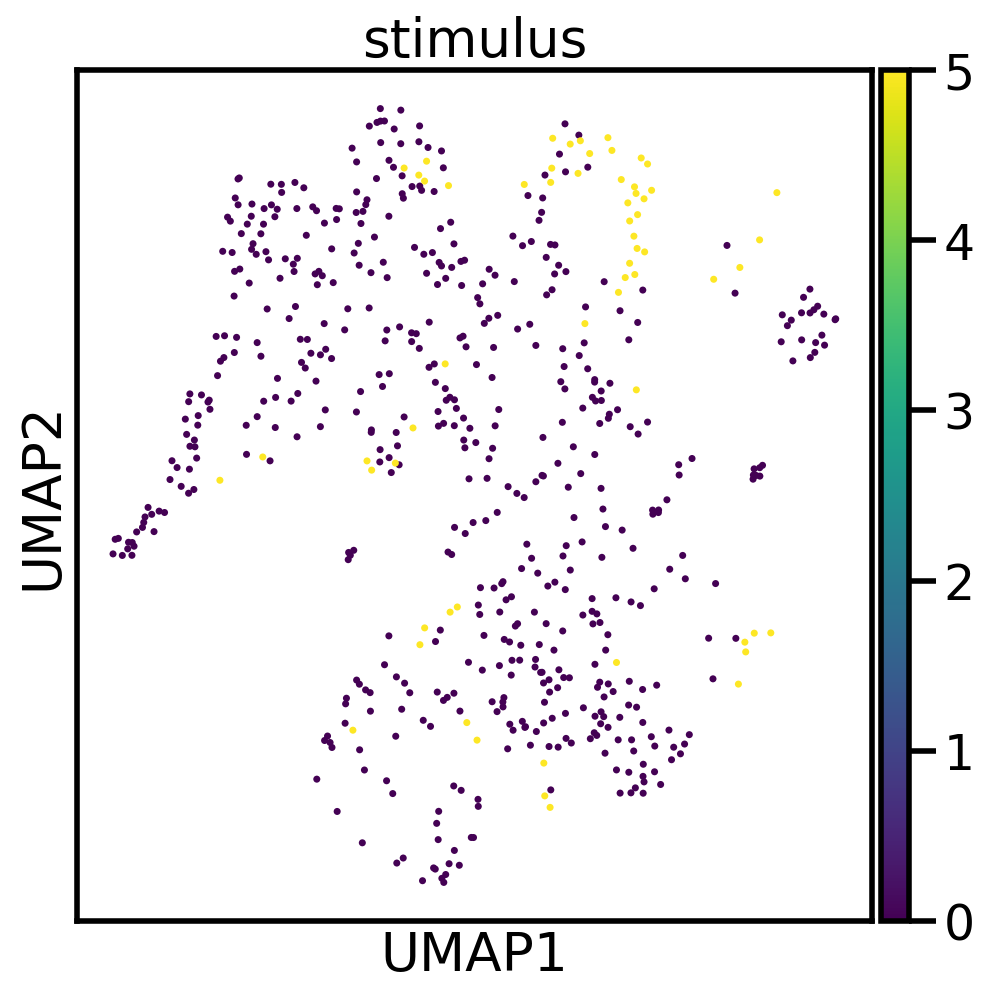

(616, 25930)


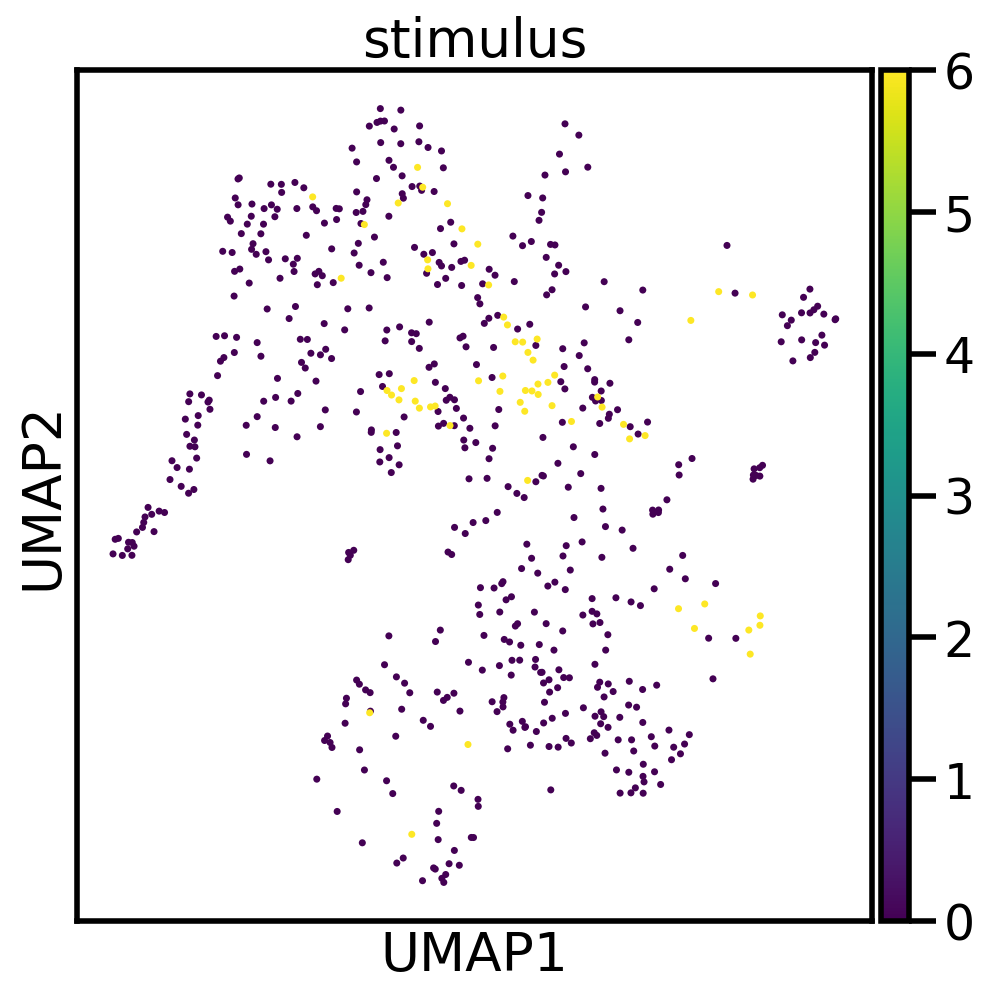

(569, 25930)


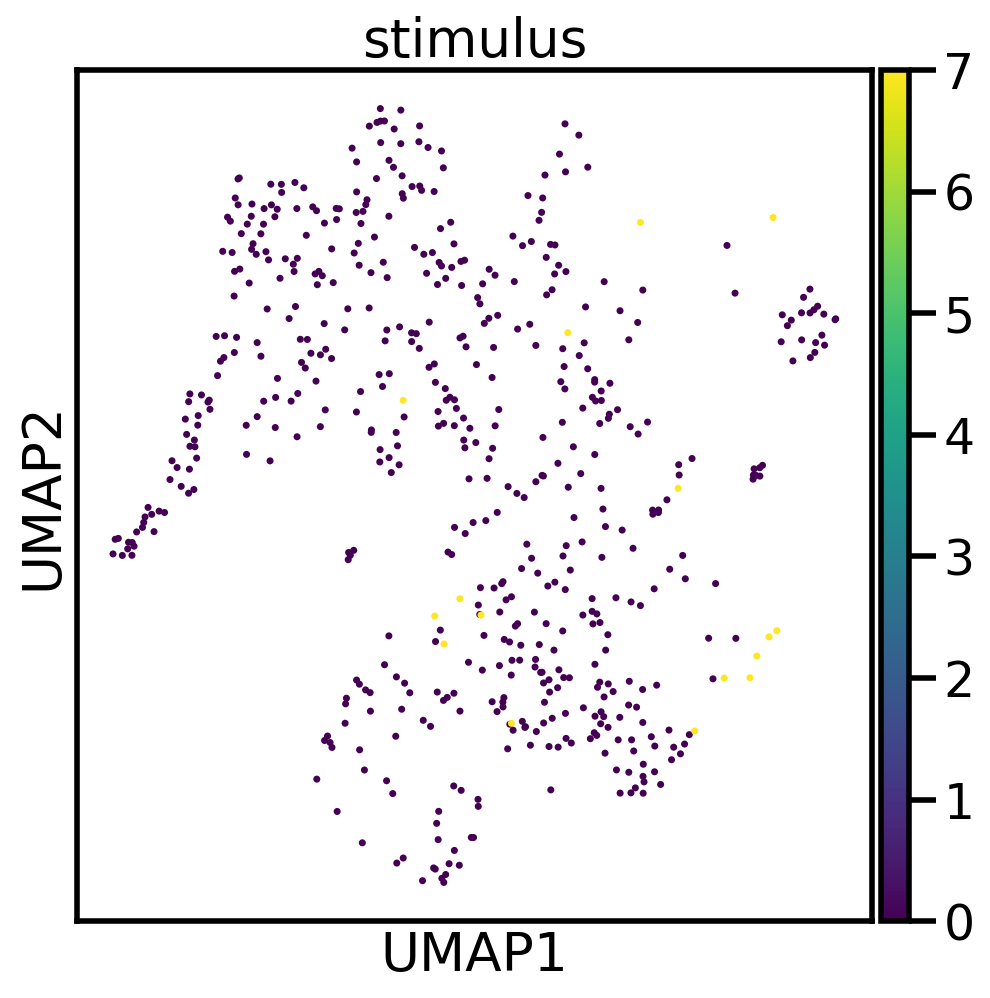

(608, 25930)


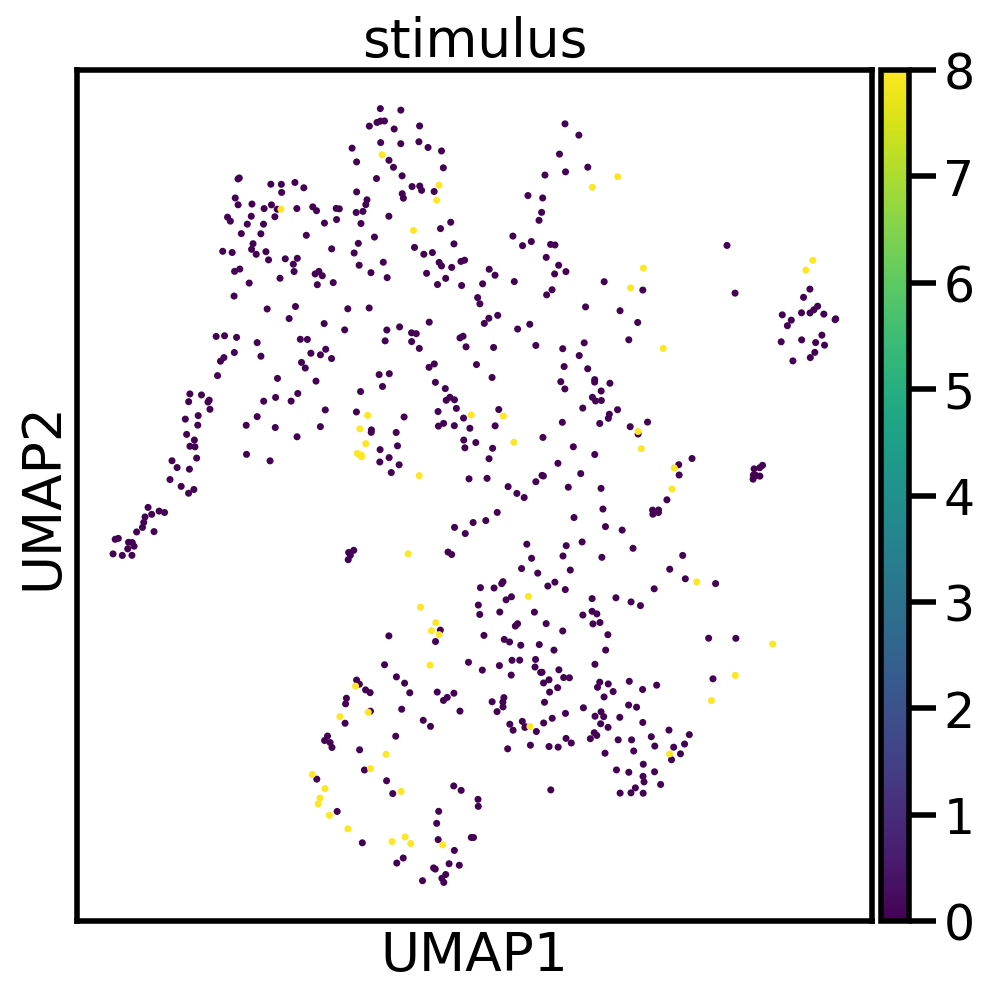

(585, 25930)


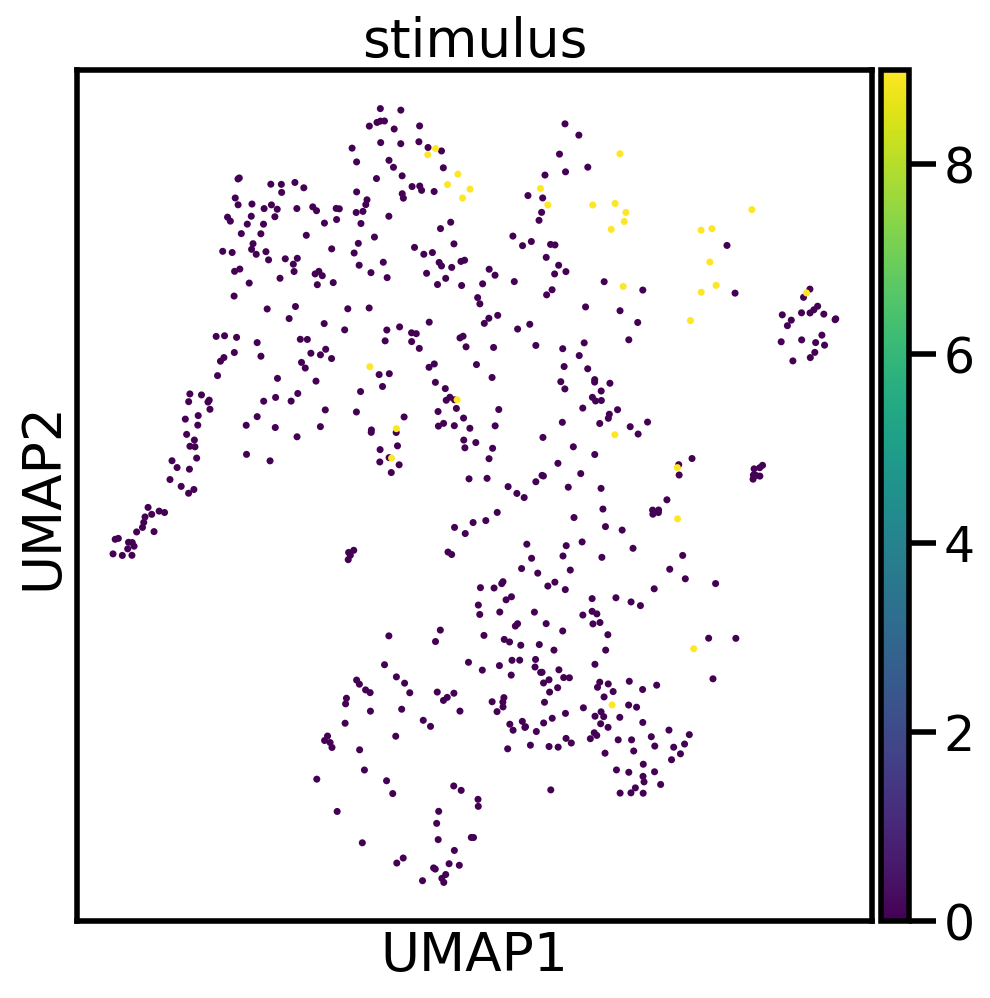

(557, 25930)


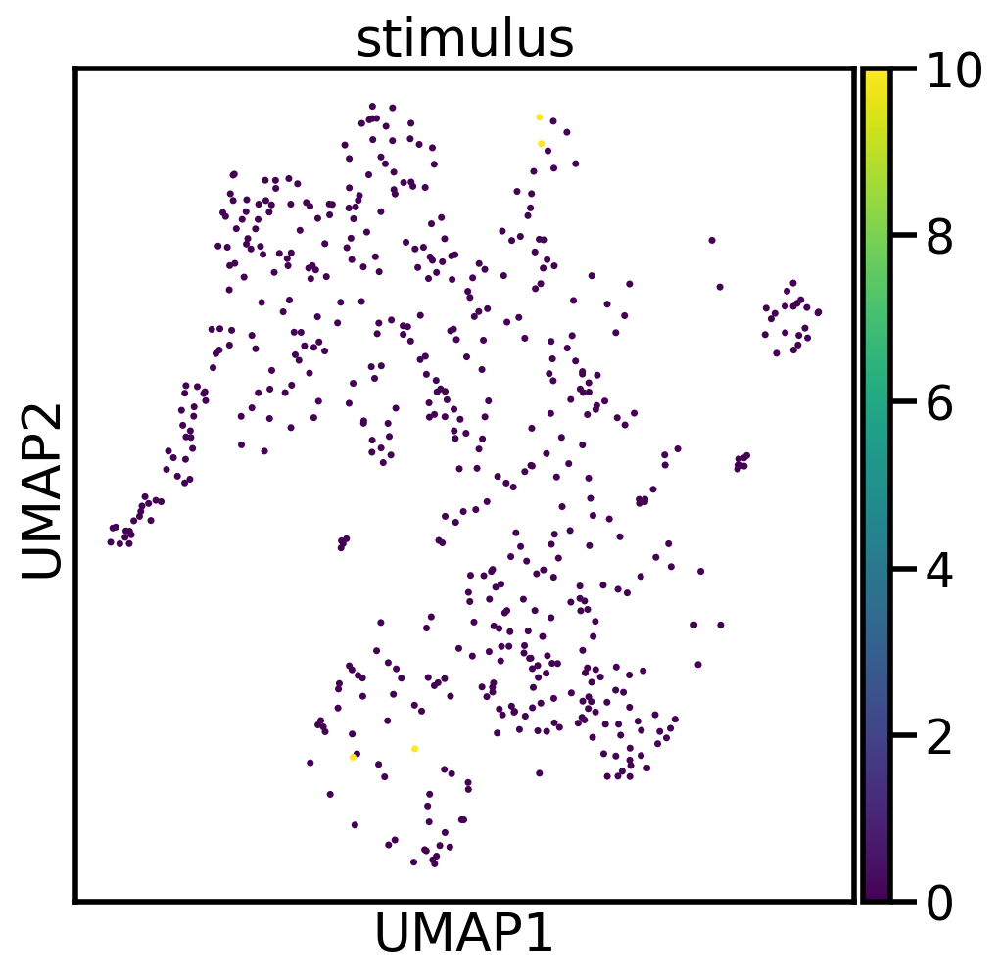

(612, 25930)


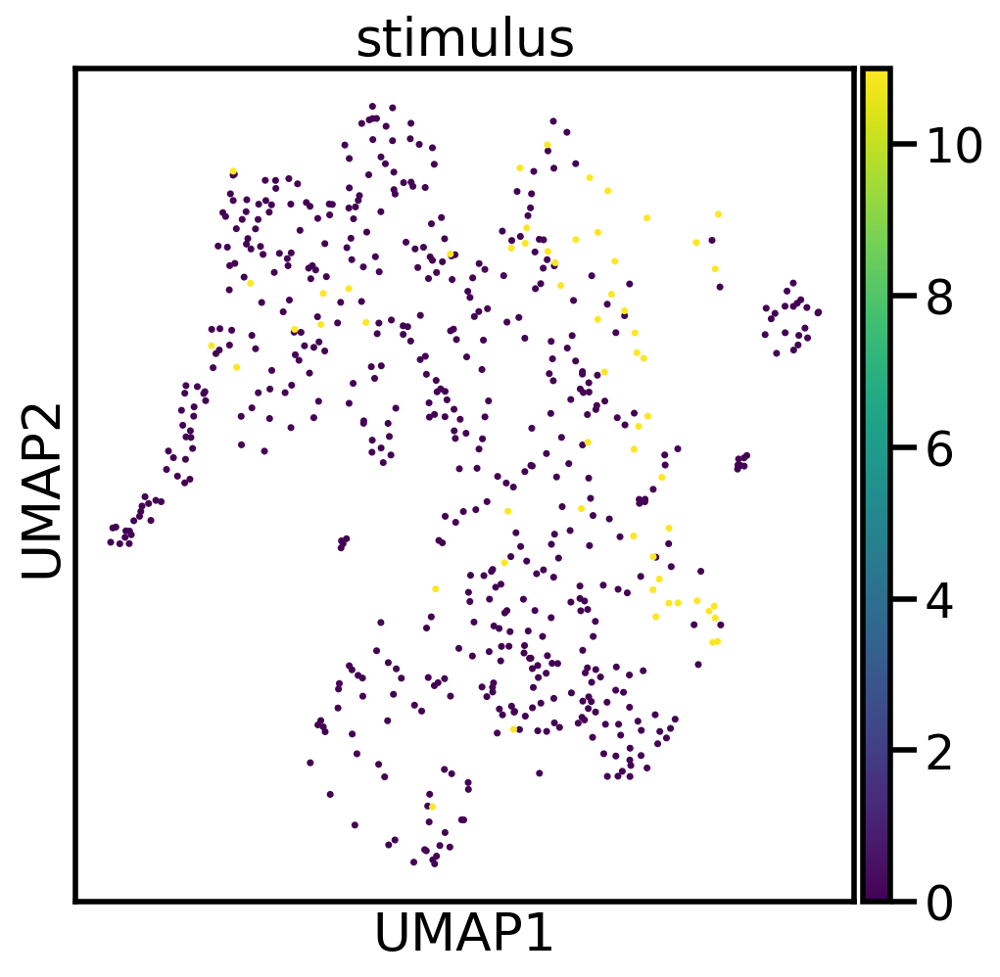

(575, 25930)


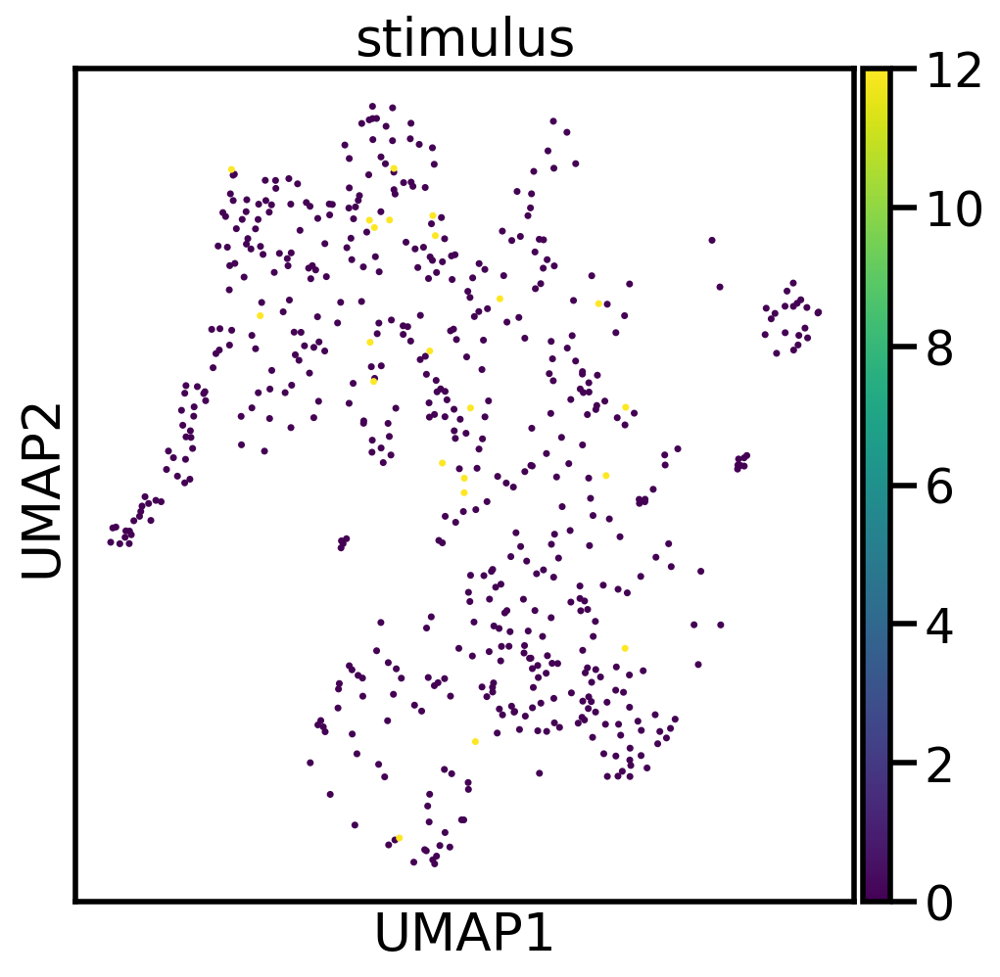

(554, 25930)


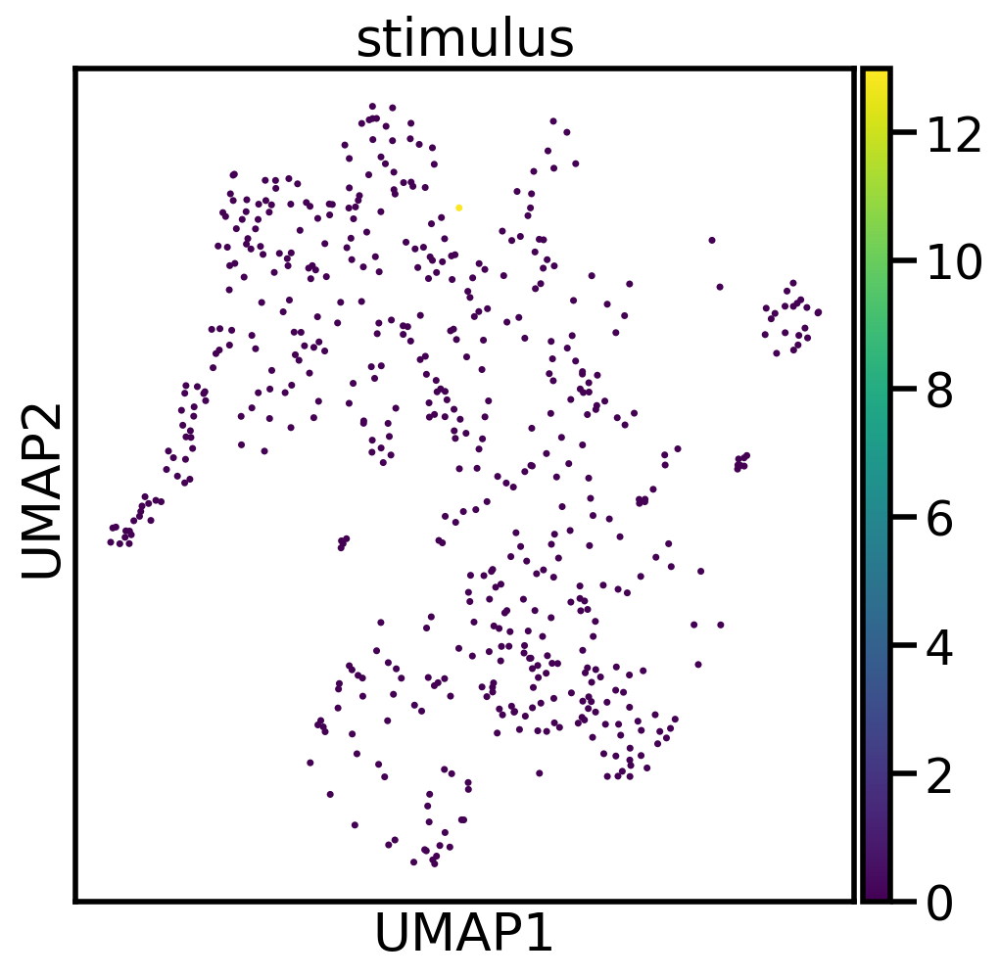

In [48]:
rcParams['figure.figsize']=(7,7)

for i in range(1,14):
    index = np.logical_or(adata.obs['stimulus'] == i,adata.obs['stimulus'] == 0)
    aux_adata = adata[index,:]
    print(aux_adata.shape)
    sc.pl.umap(aux_adata, color = 'stimulus', color_map = 'viridis', save = 'UMIs/stimulus/stimulus_' + labels[i]+ '.png', size = 40)

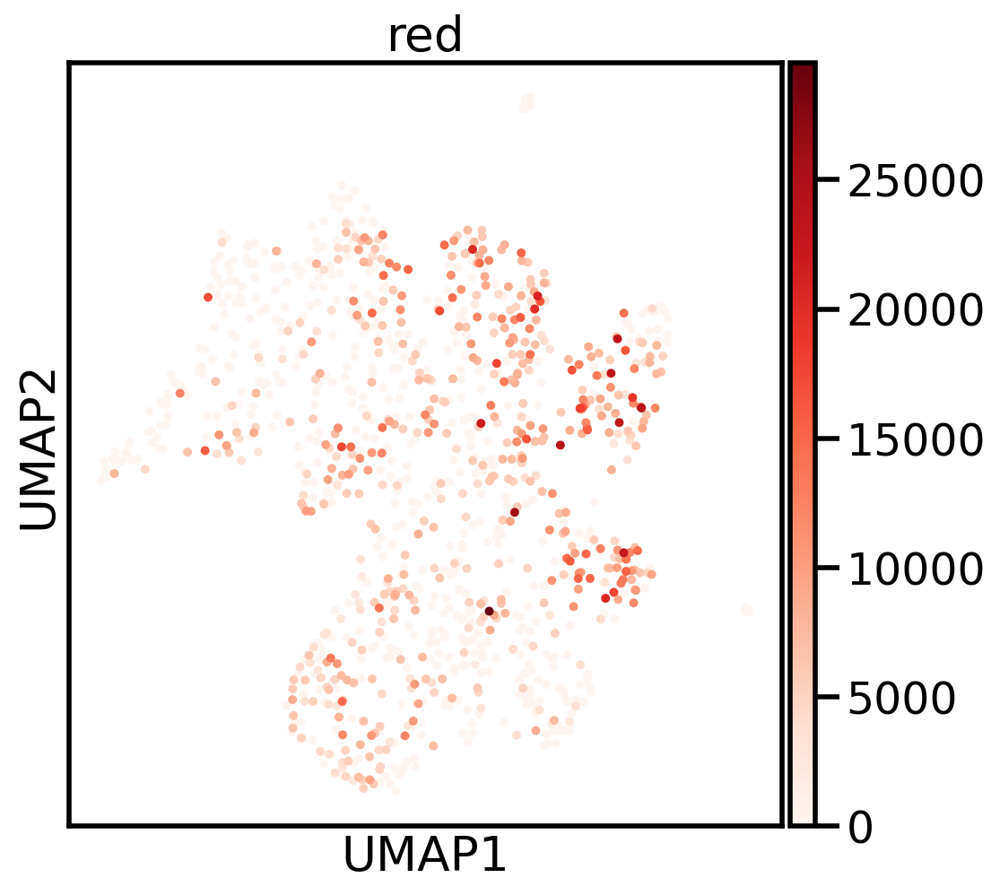

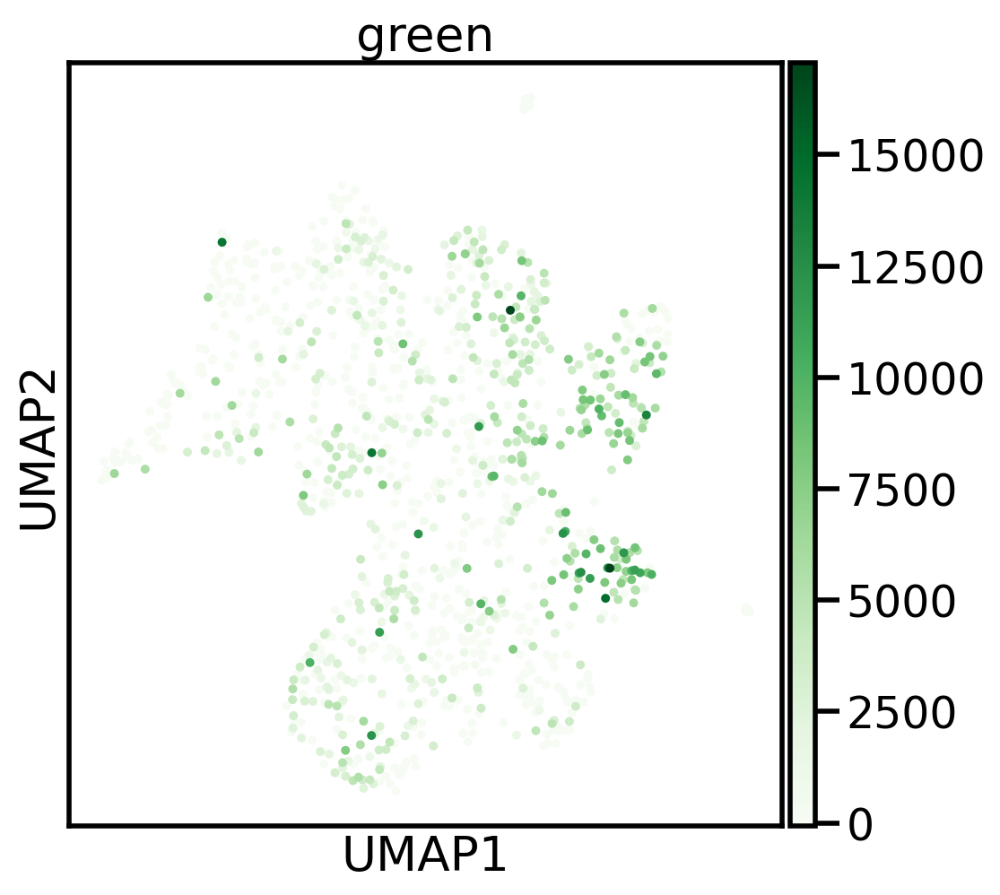

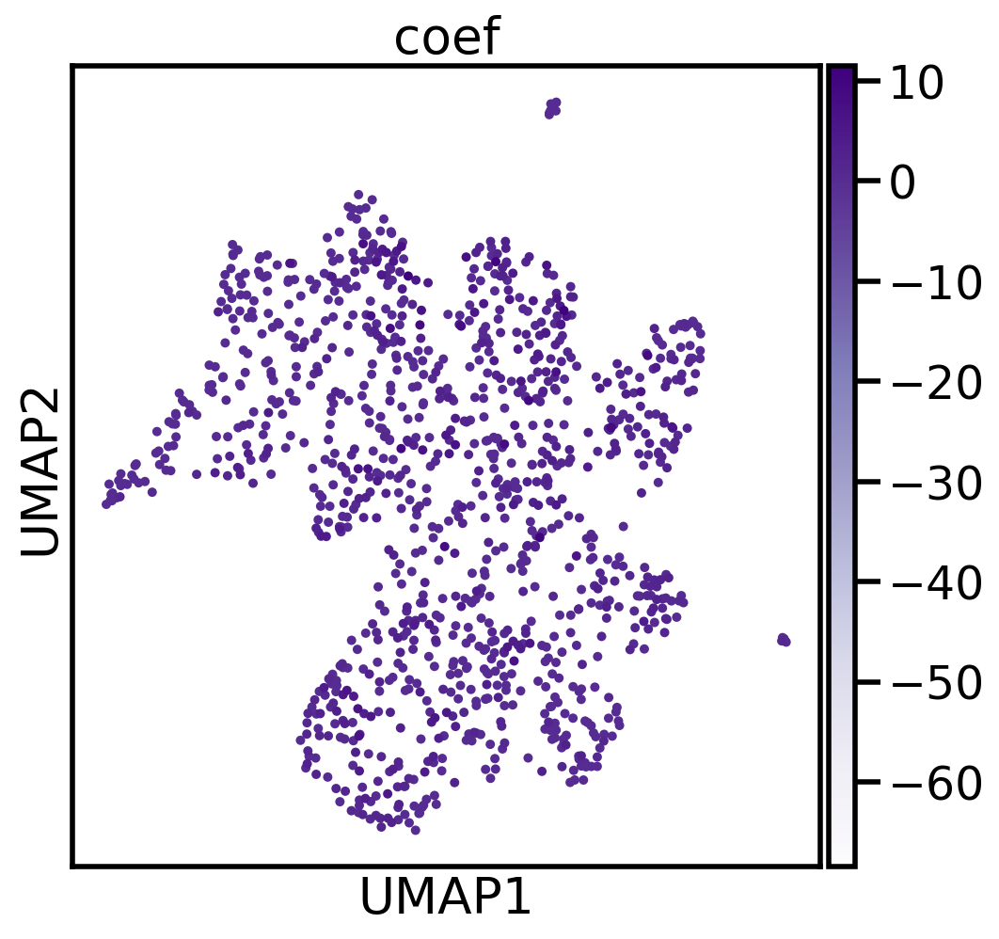

In [57]:
sc.pl.umap(adata, color='red', color_map = 'Reds', save = 'UMIs/fluorecence/red_f' + '.png', size = 80)
sc.pl.umap(adata, color='green', color_map = 'Greens', save = 'UMIs/fluorecence/green_f' + '.png', size = 80)
import sys
adata.obs['coef'] = adata.obs['red']/(adata.obs['green'] + sys.float_info.epsilon)
sc.pl.umap(adata, color='coef', color_map = 'Purples', save = 'UMIs/fluorecence/coef_f' + '.png', size = 80)


(629, 25930)


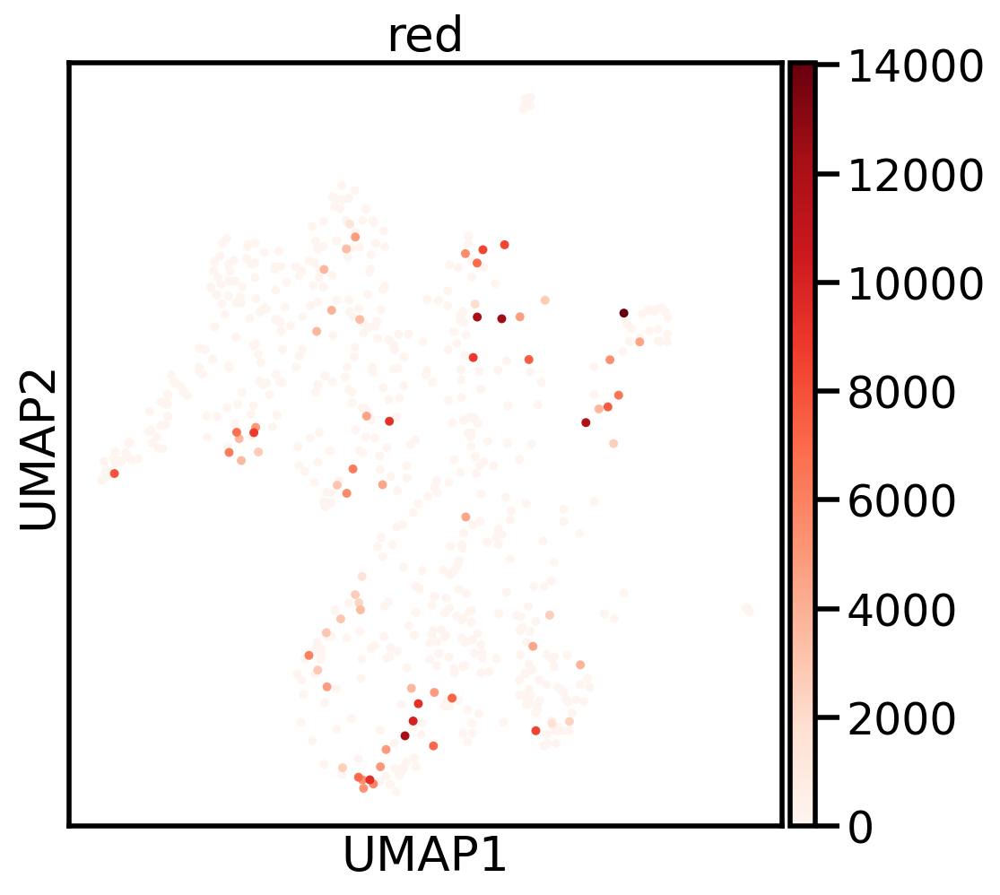

(686, 25930)


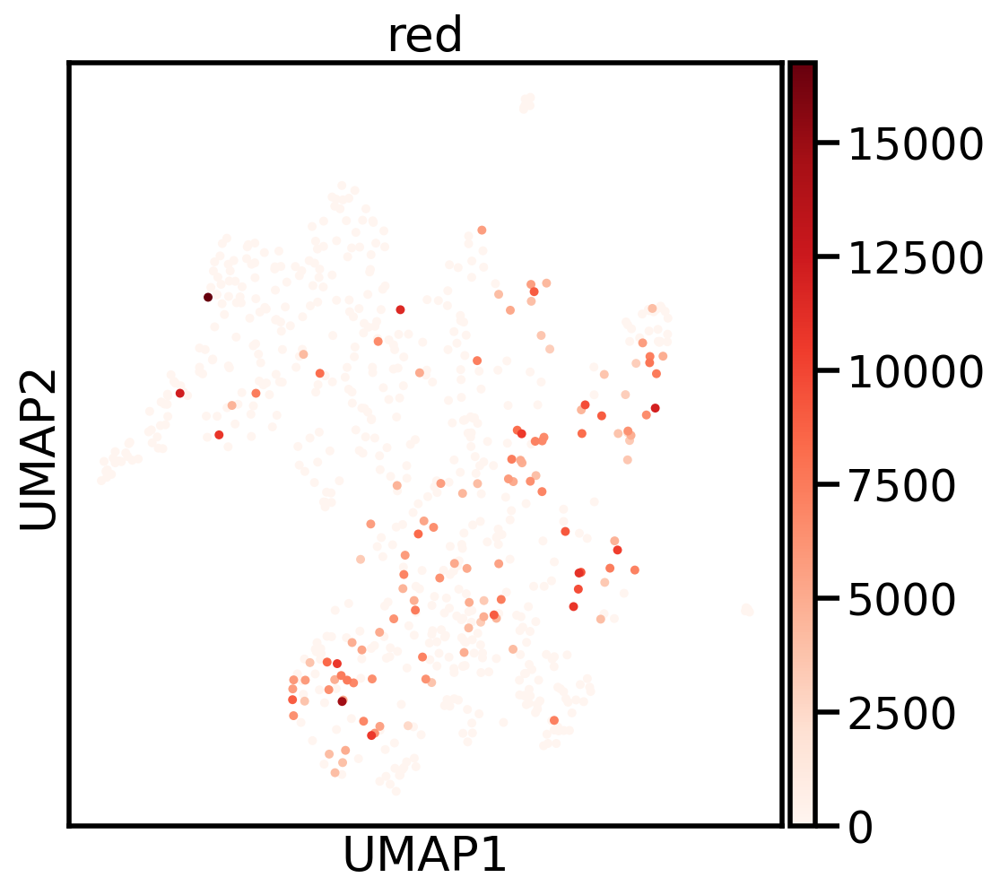

(561, 25930)


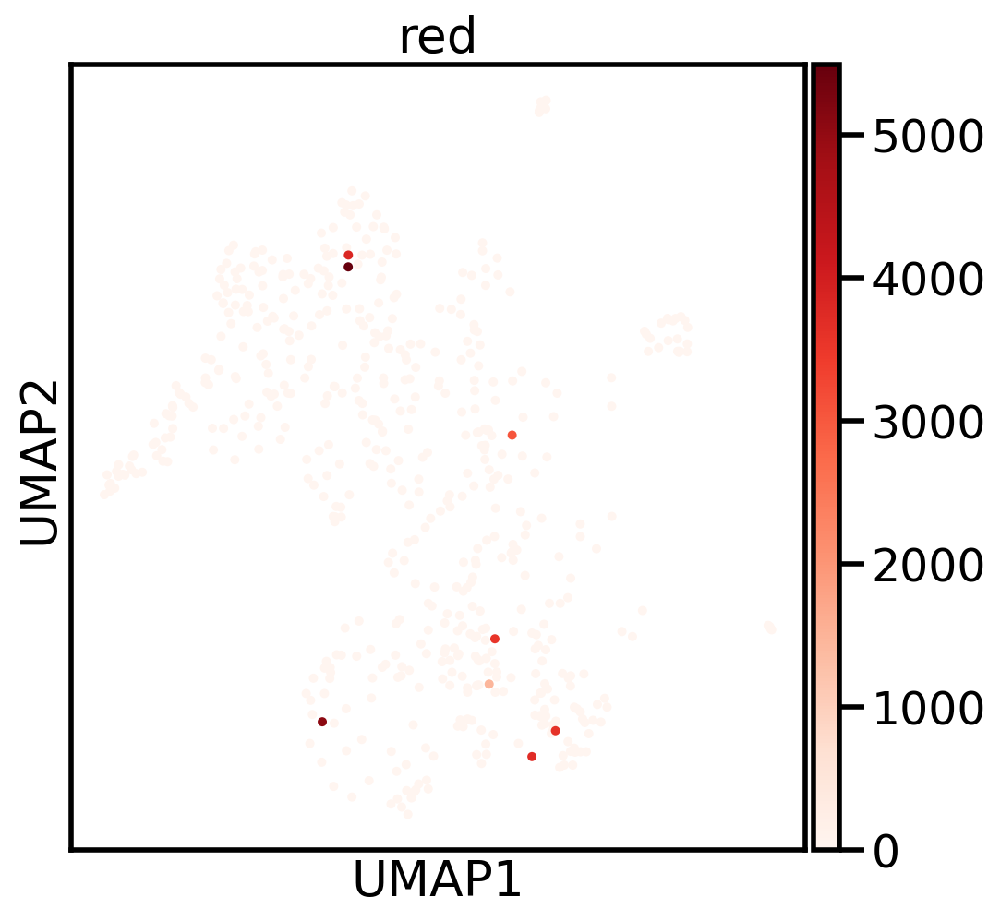

(604, 25930)


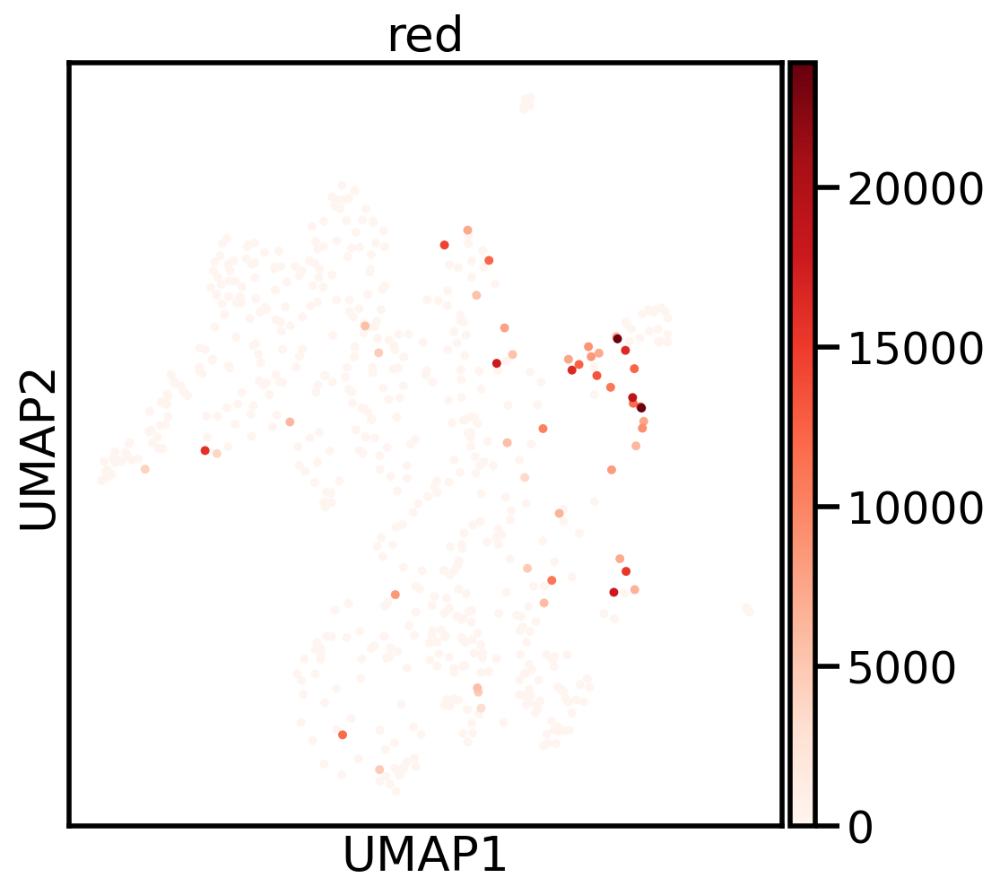

(614, 25930)


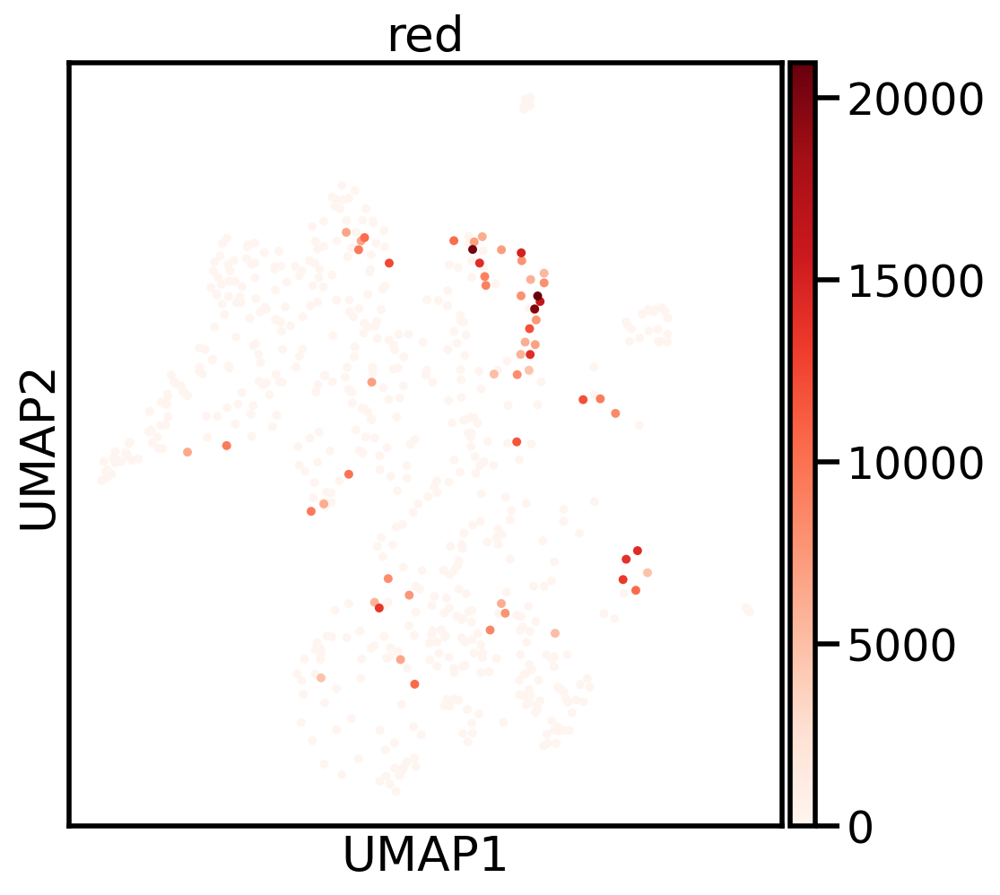

(616, 25930)


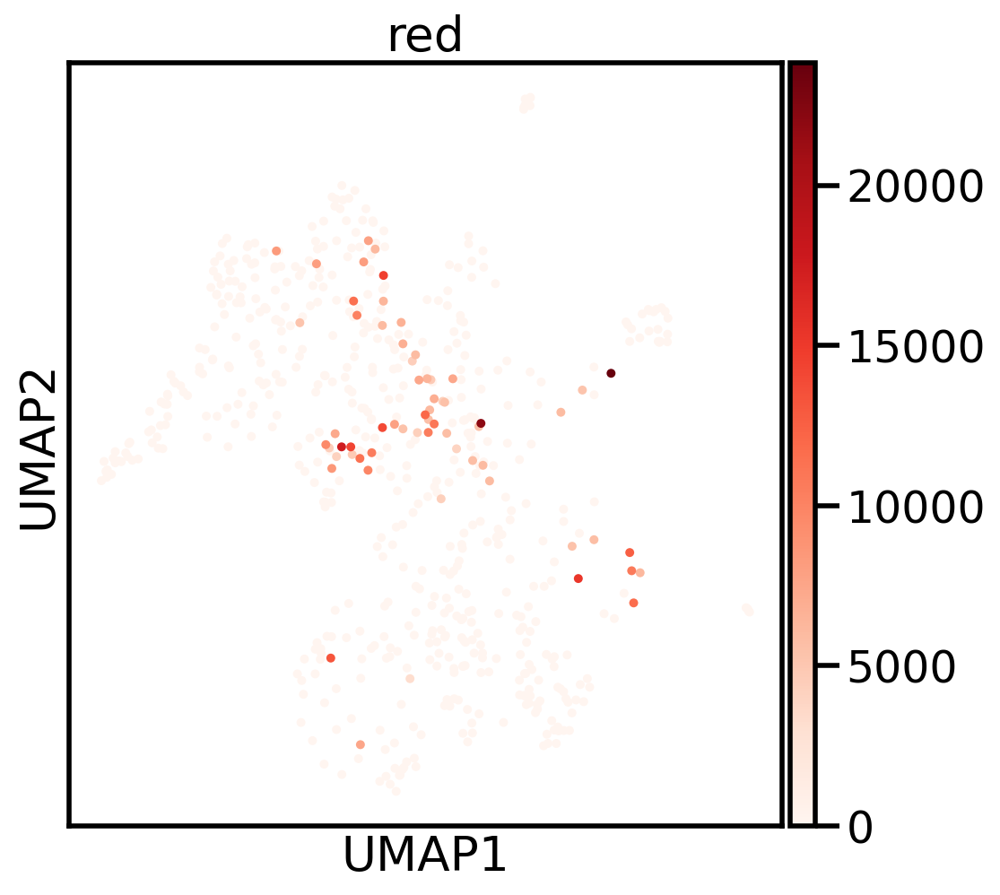

(569, 25930)


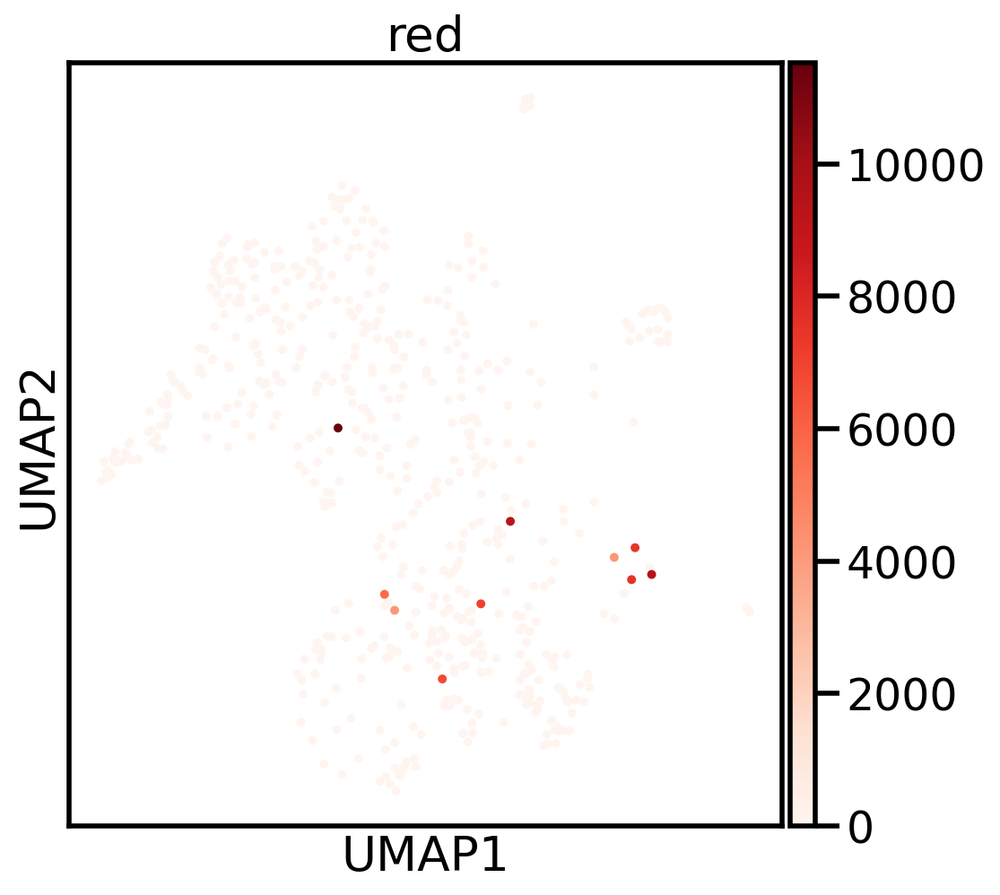

(608, 25930)


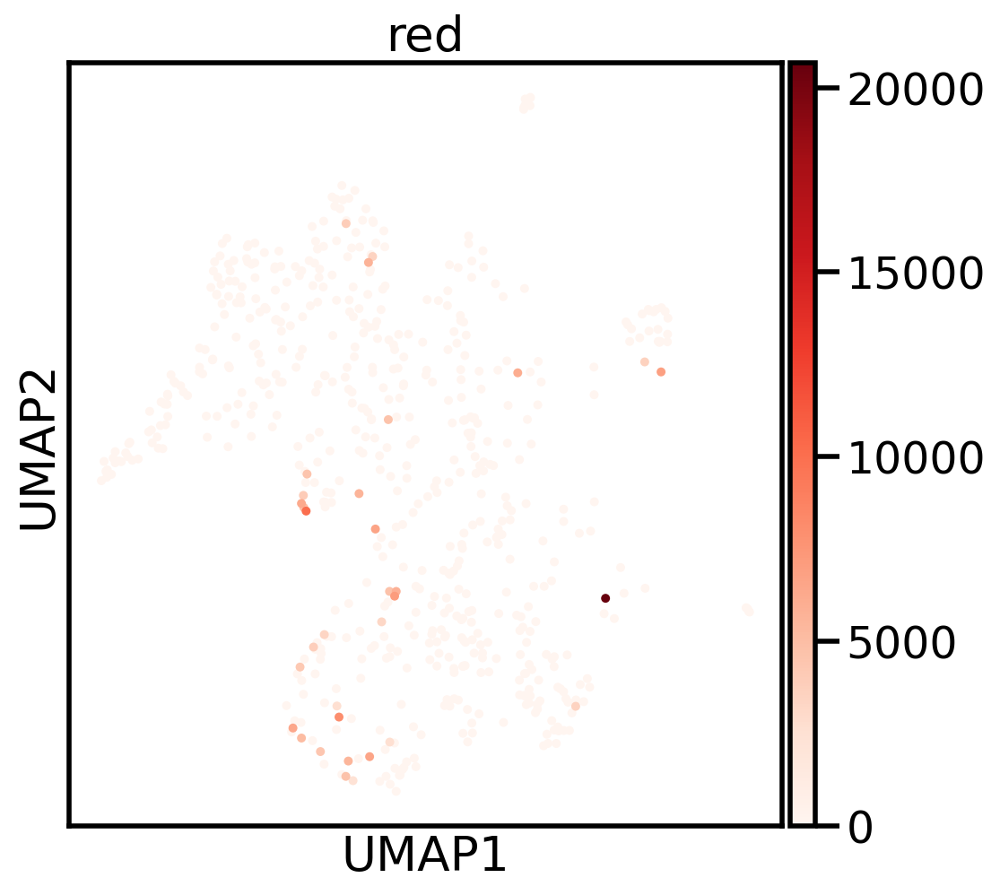

(585, 25930)


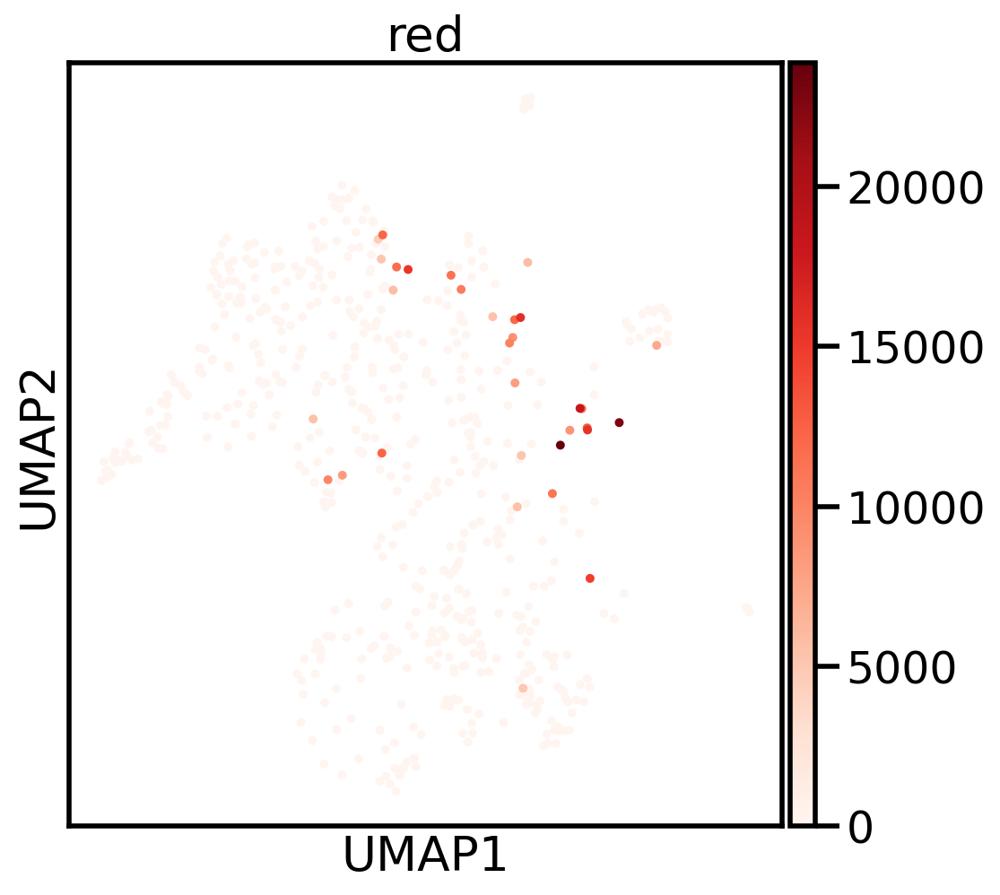

(557, 25930)


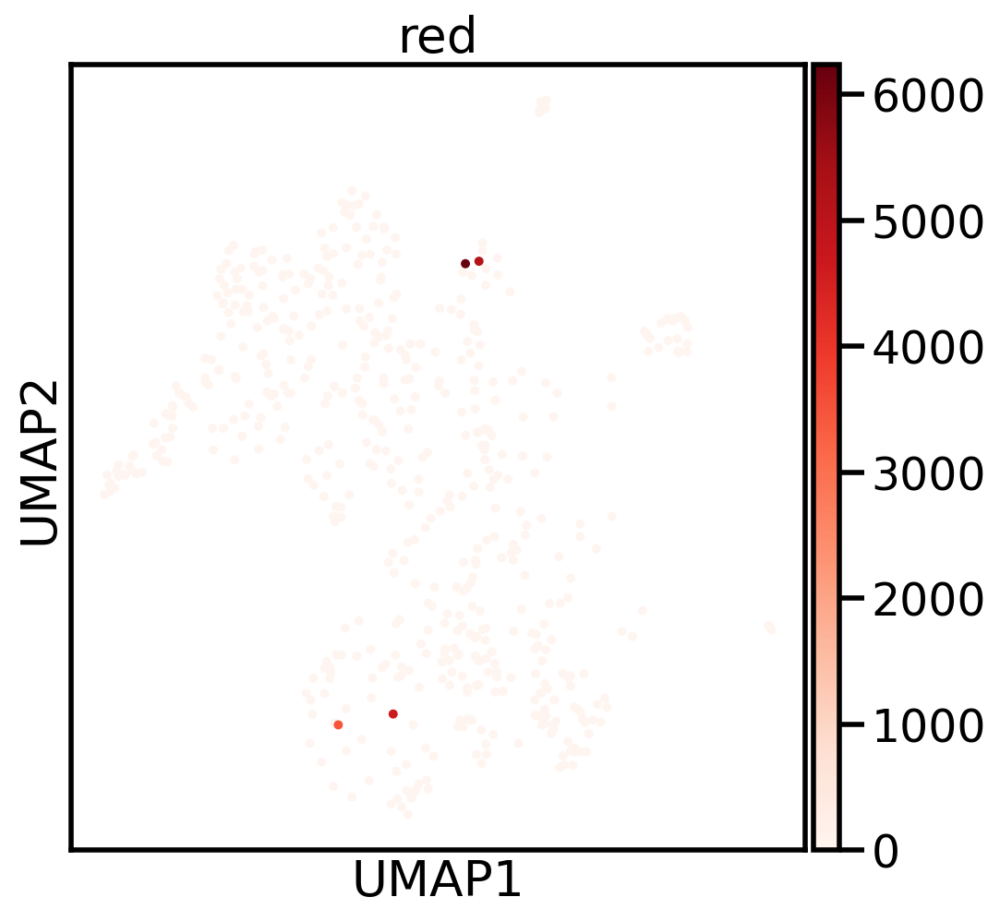

(612, 25930)


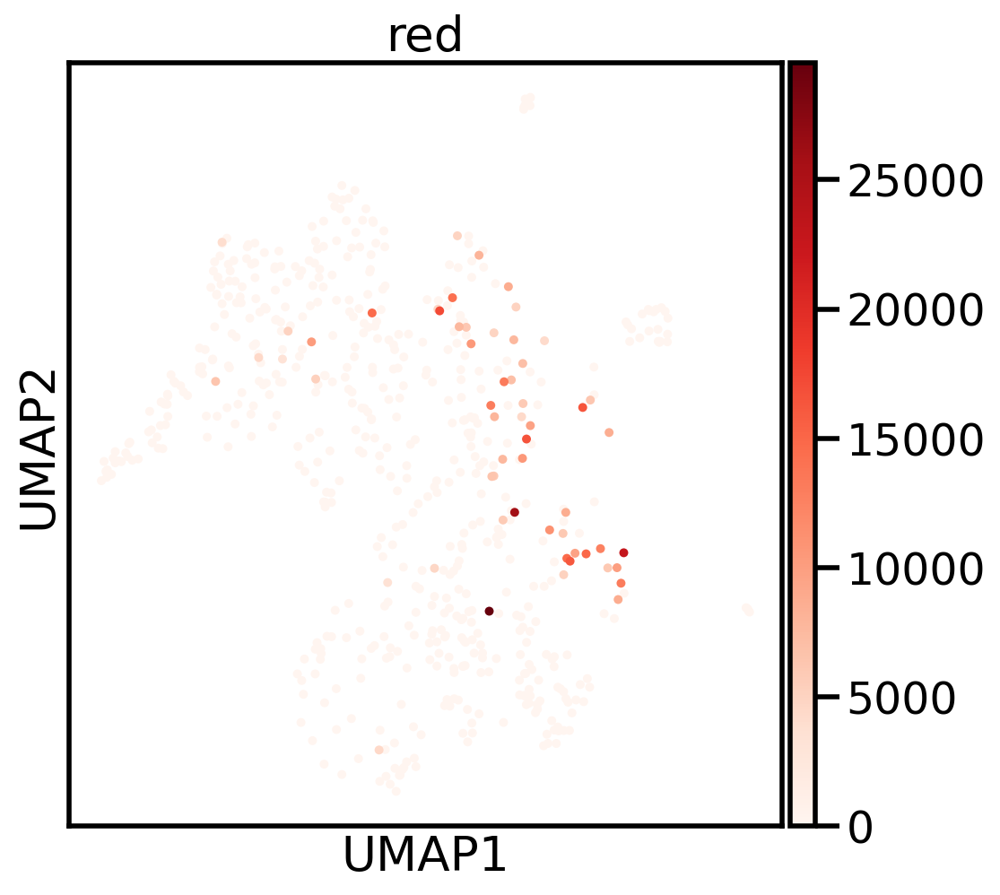

(575, 25930)


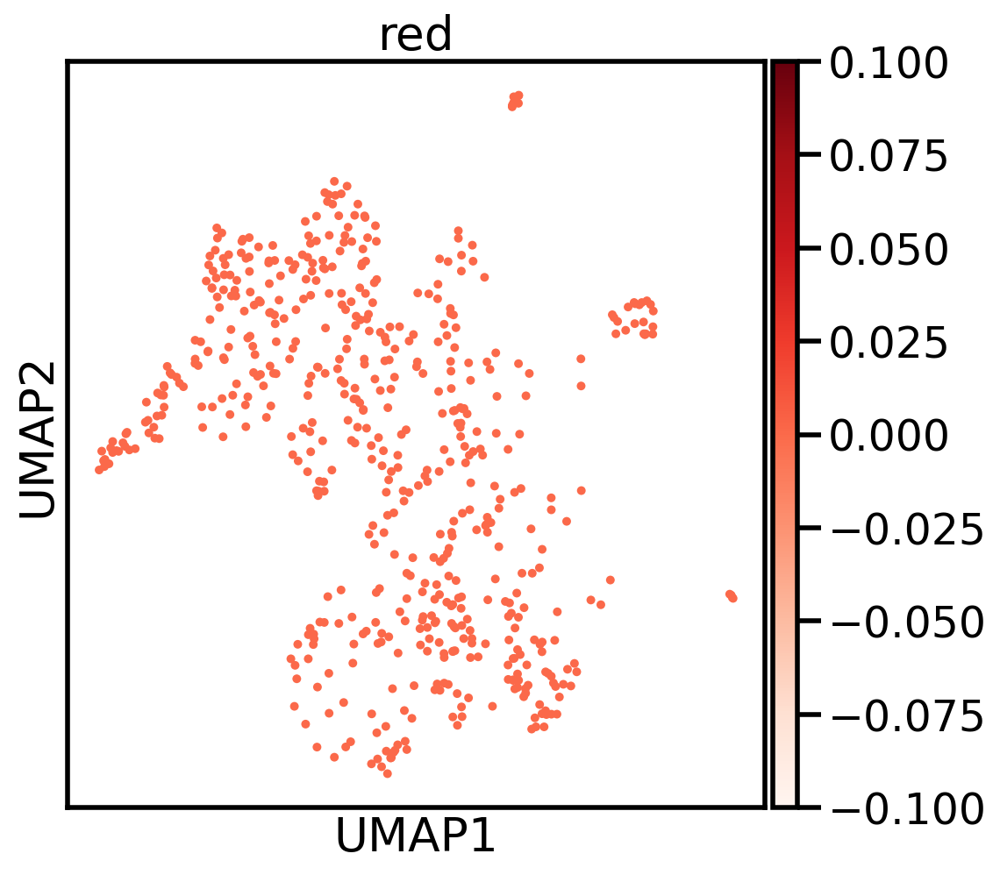

(554, 25930)


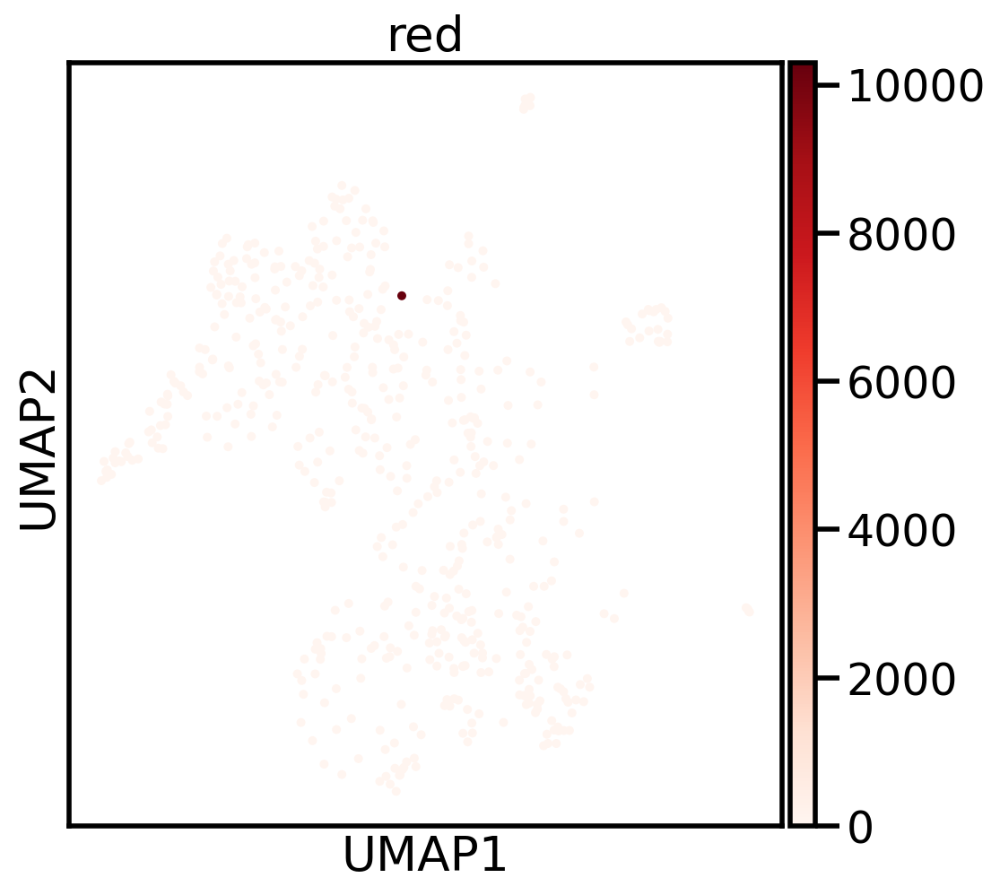

In [58]:
rcParams['figure.figsize']=(7,7)

colors = ['Greys','Reds','Blues','Greens','Purples','Oranges','GnBu','YlOrBr']

#labels=['Control','pinch','new_stroke','ballon','AG','AD','heating','mock','old_stroke','anal_pinch','mockw_poop']

for i in range(1,14):
    index = np.logical_or(adata.obs['stimulus'] == i,adata.obs['stimulus'] == 0)
    aux_adata = adata[index,:]
    print(aux_adata.shape)
    sc.pl.umap(aux_adata, color = 'red', color_map = 'Reds', save = 'UMIs/fluorecence/stimulus_red_' + labels[i]+ '.png', size = 80)


(629, 25930)


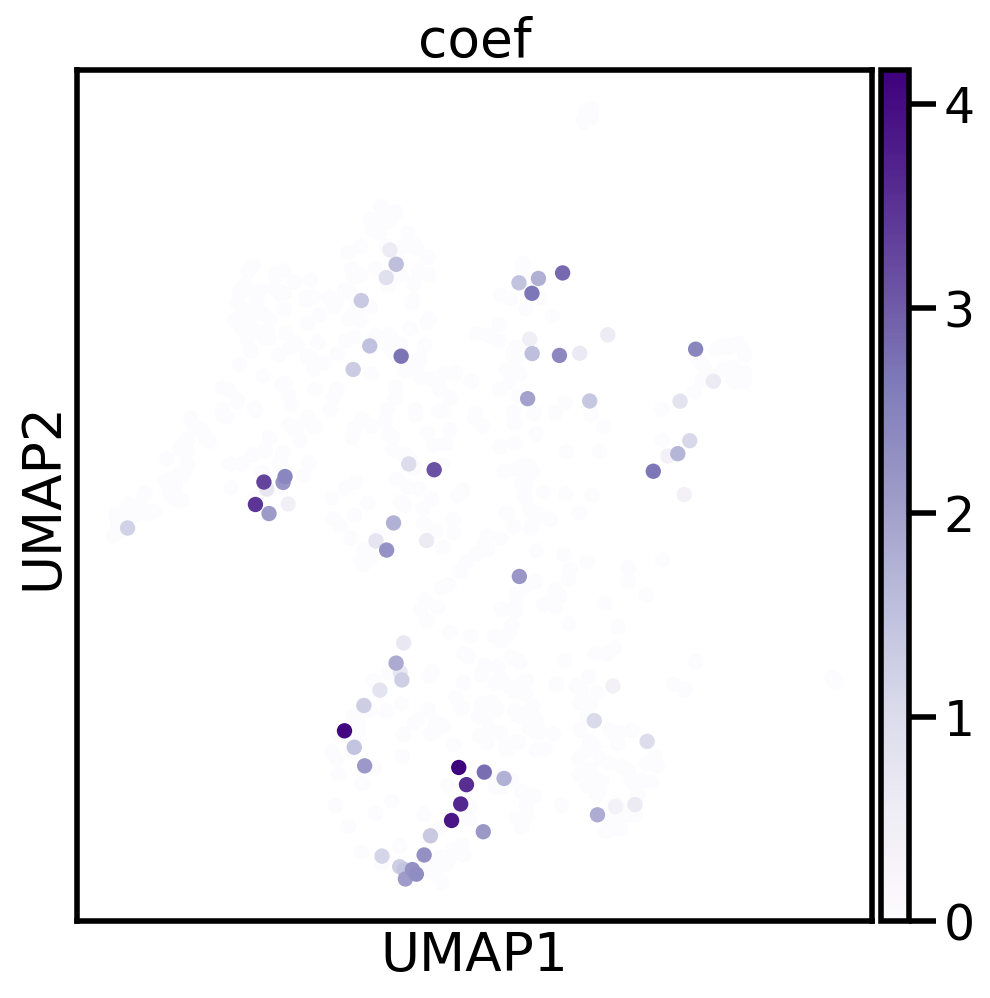

(686, 25930)


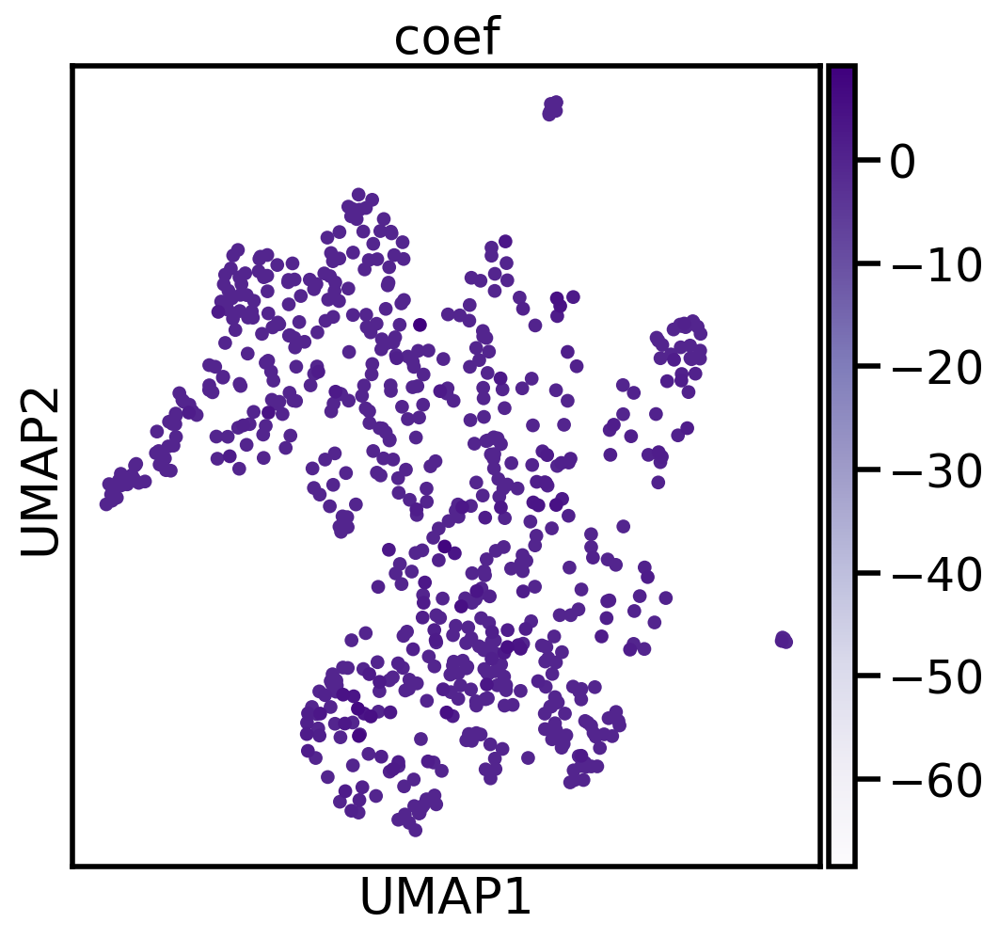

(561, 25930)


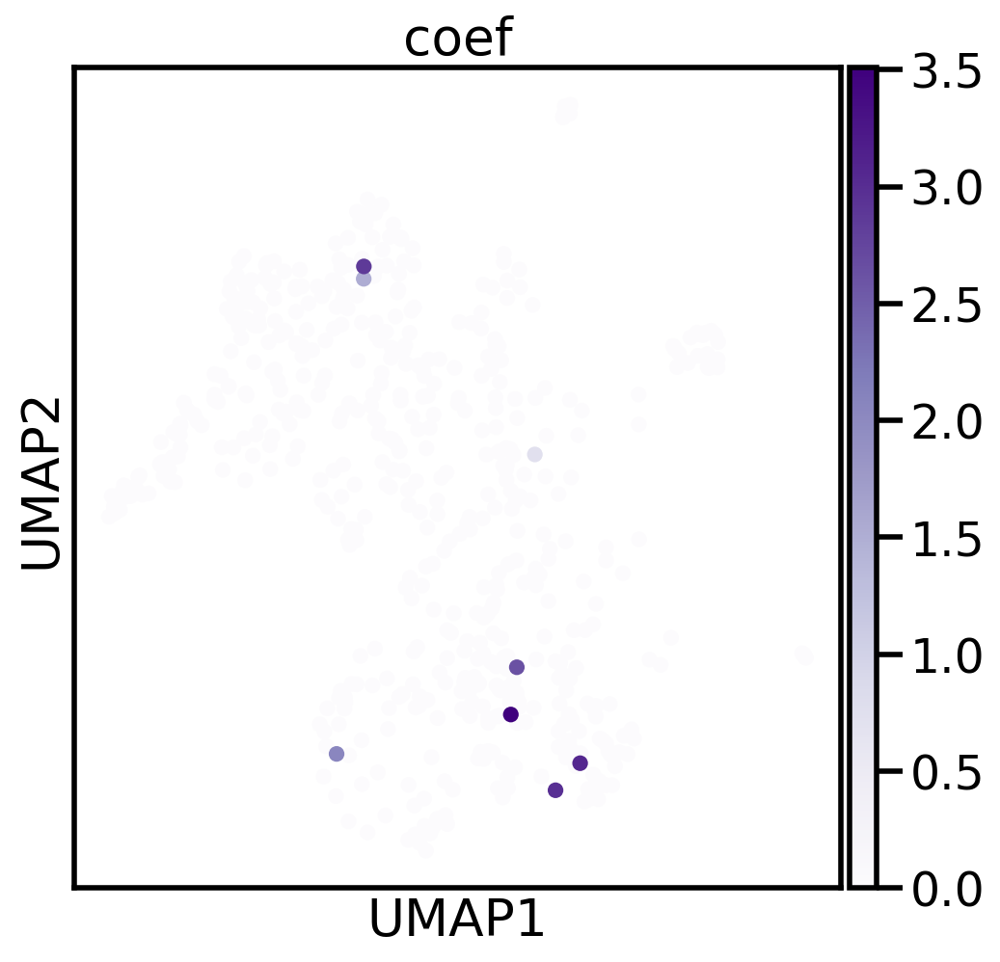

(604, 25930)


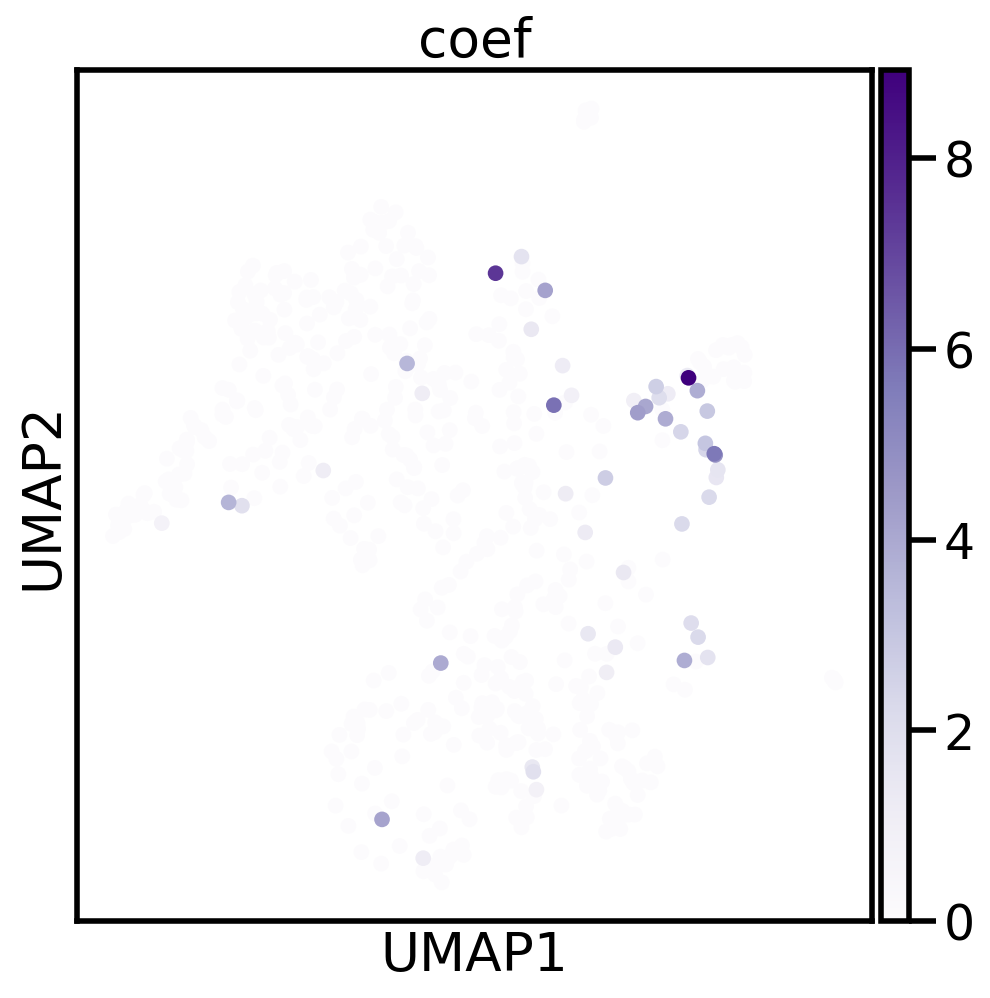

(614, 25930)


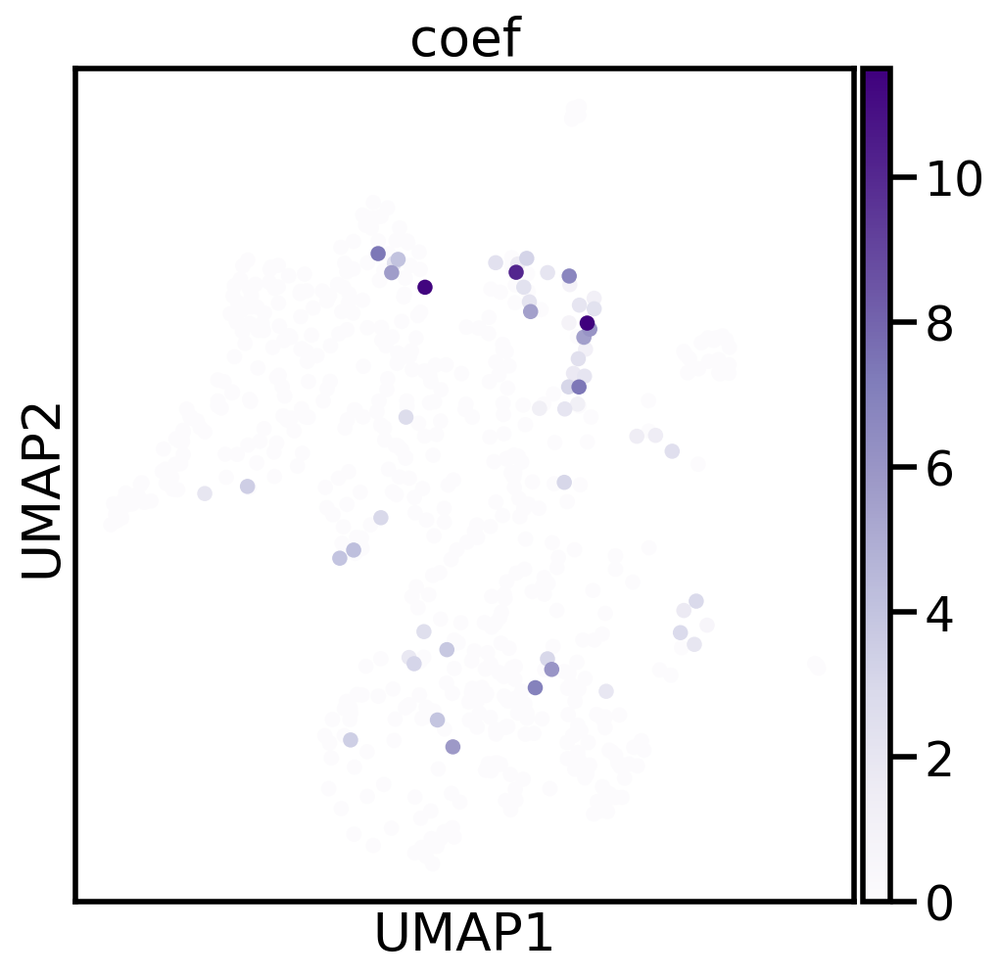

(616, 25930)


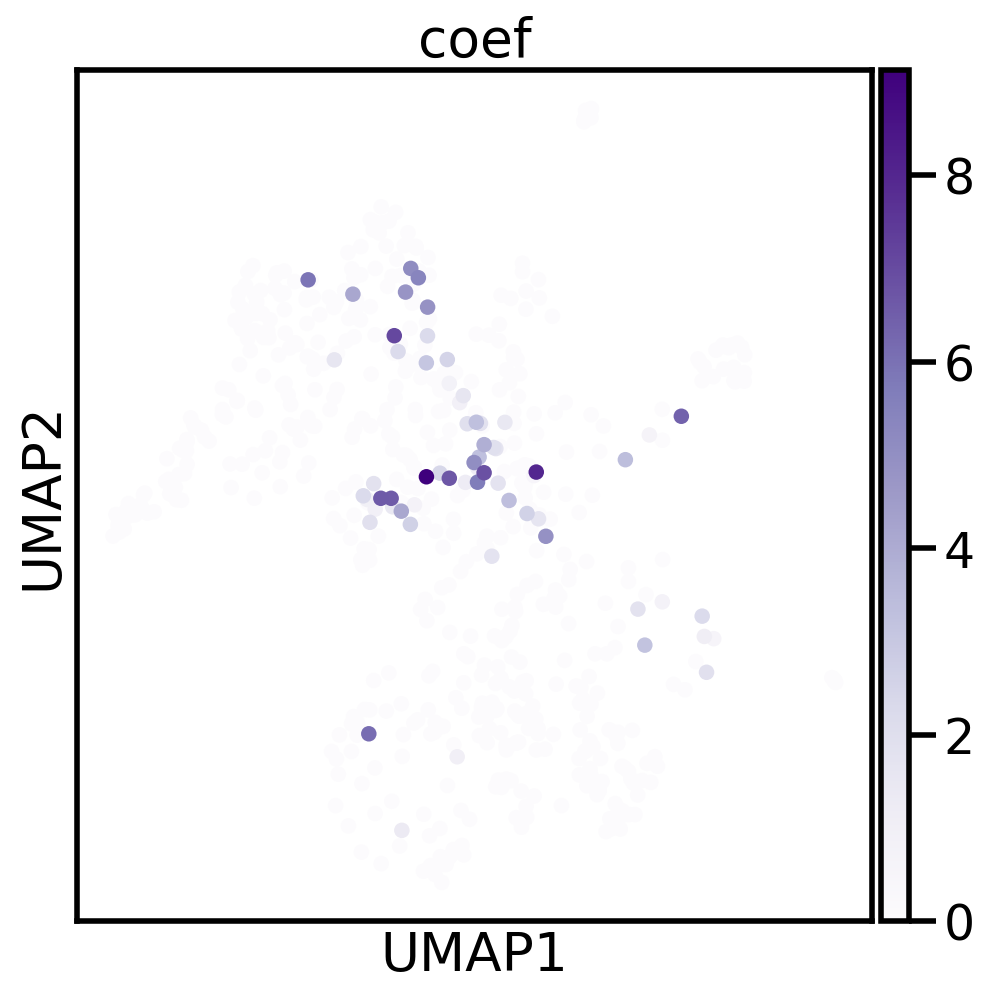

(569, 25930)


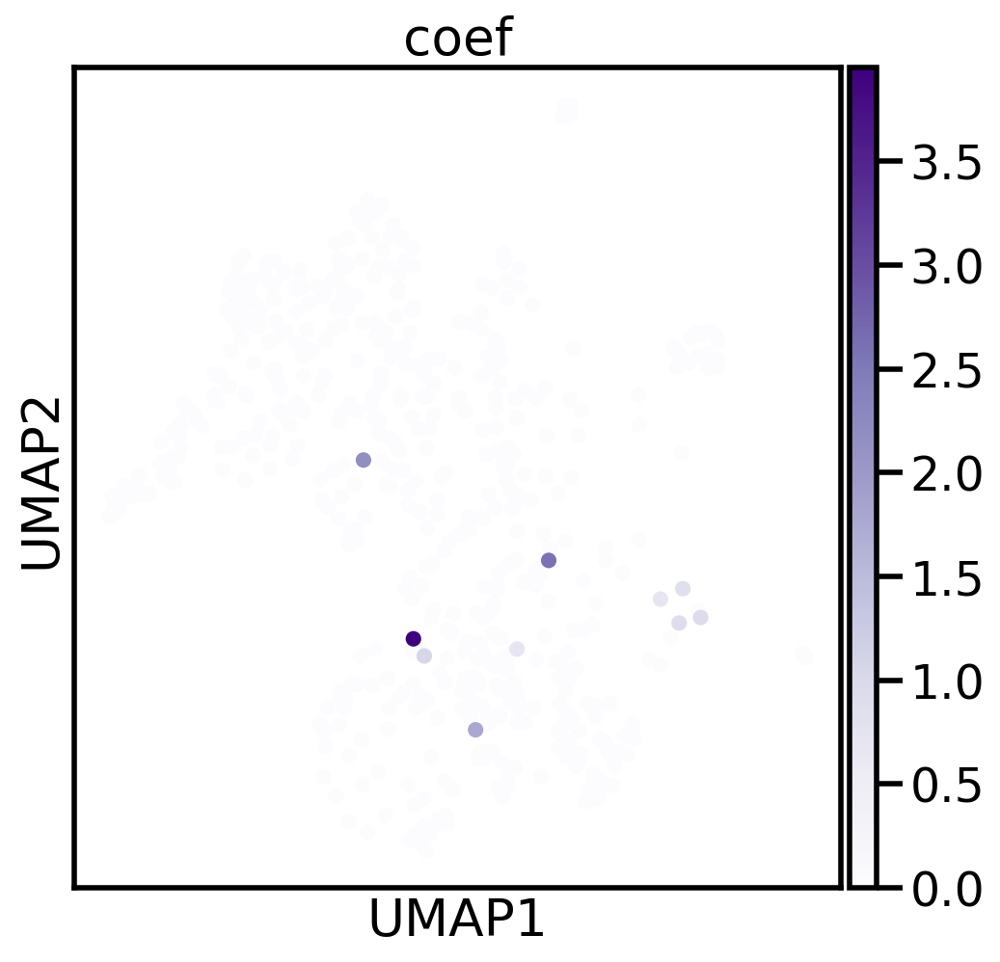

(608, 25930)


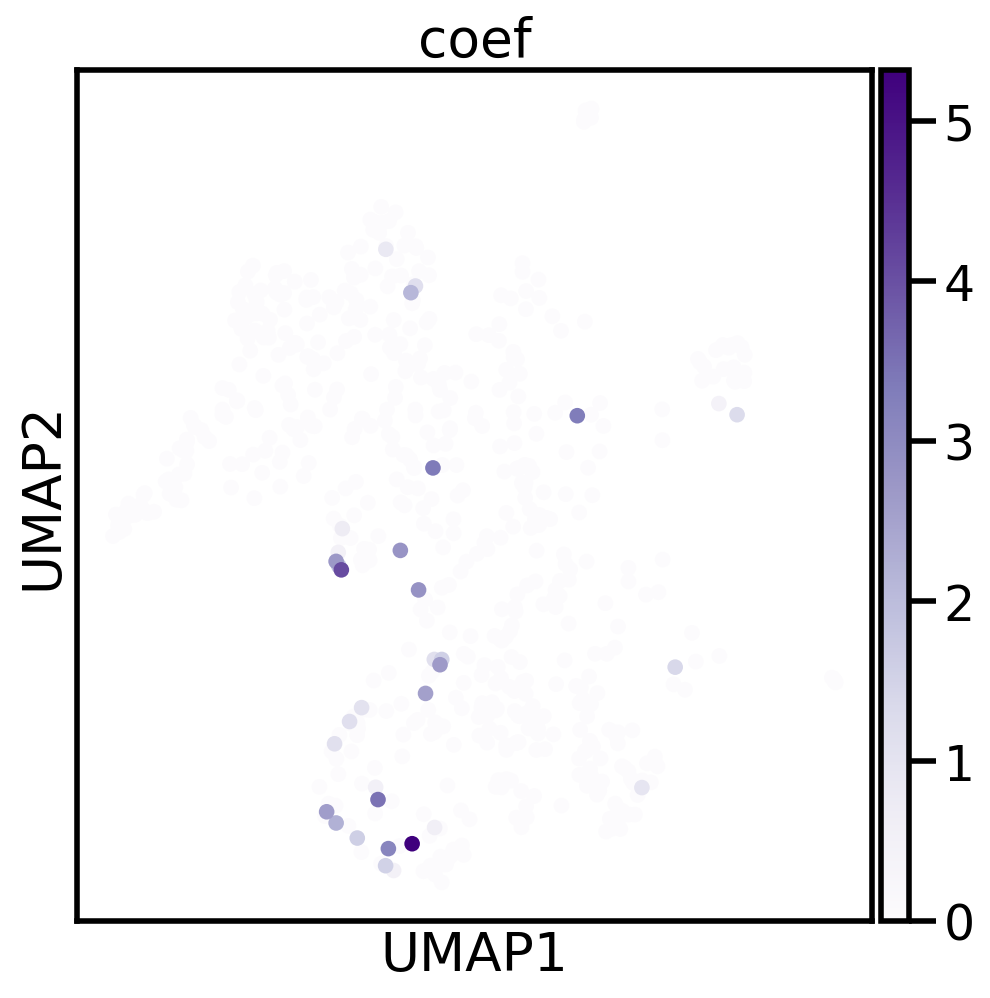

(585, 25930)


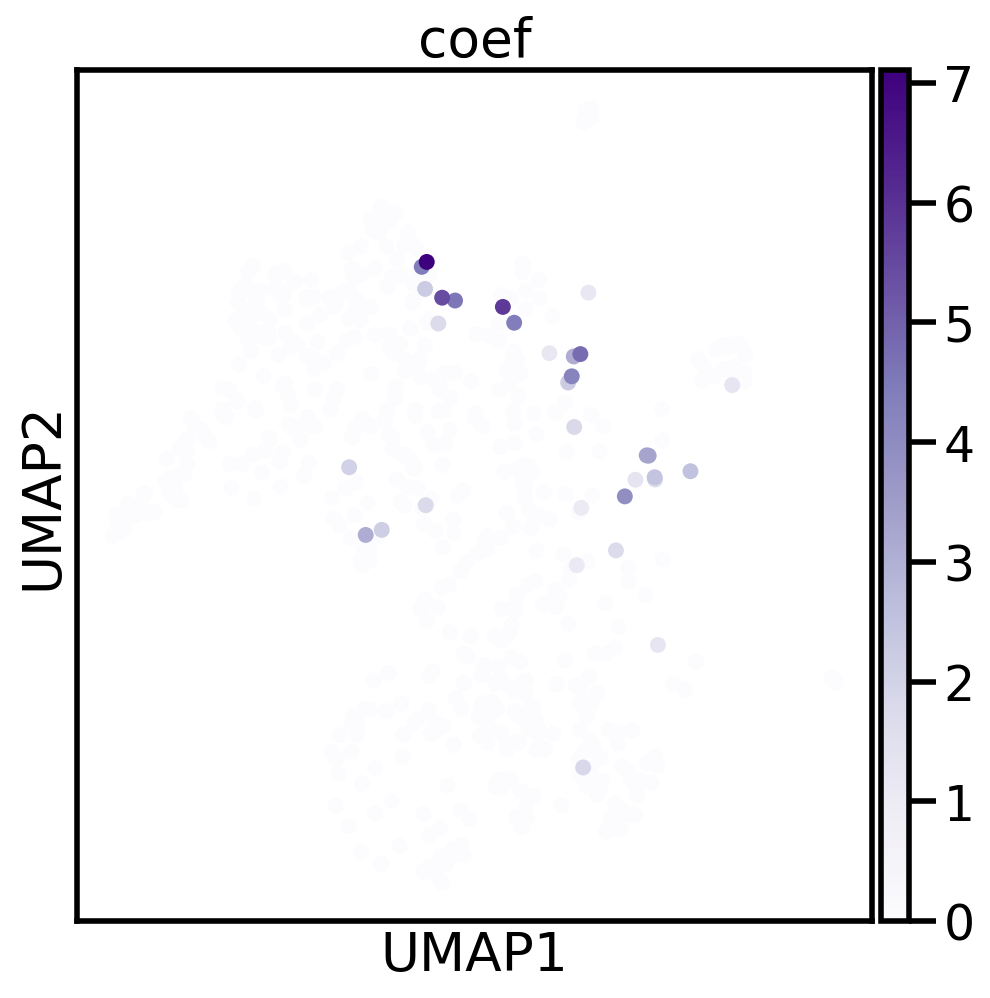

(557, 25930)


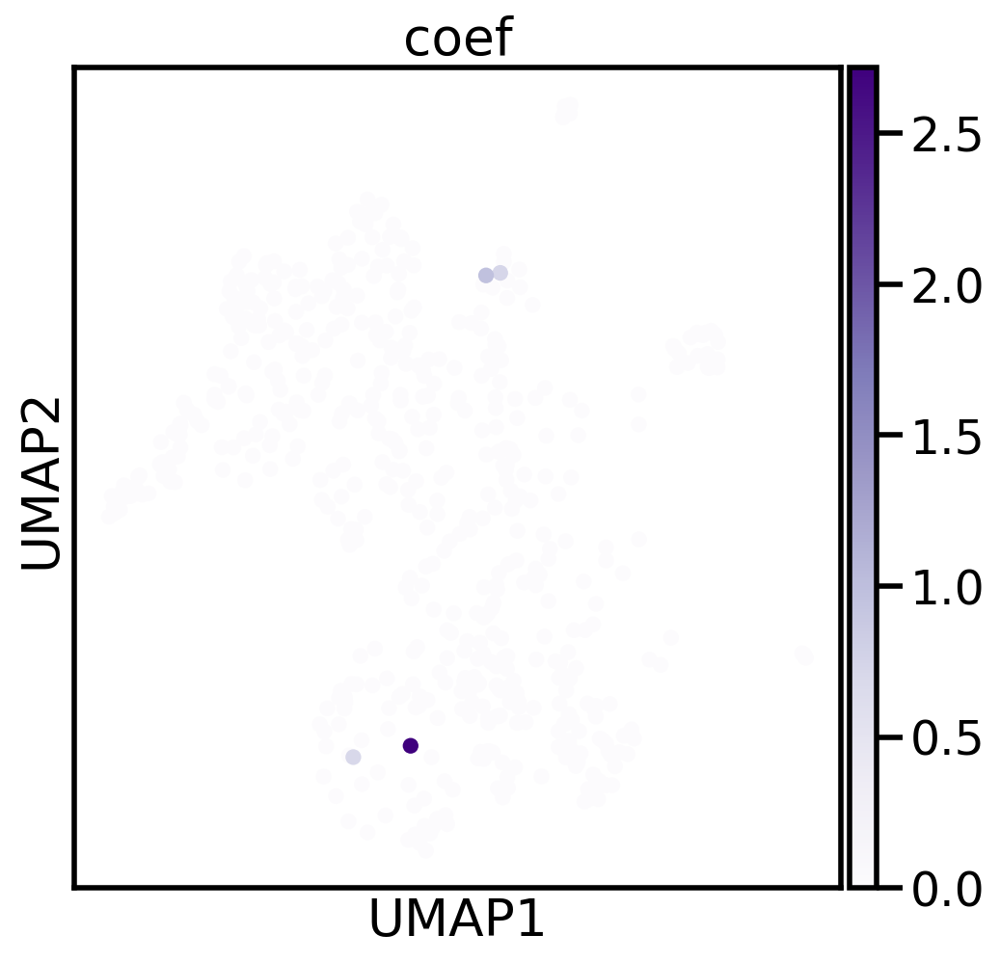

In [59]:
rcParams['figure.figsize']=(7,7)

for i in range(1,11):
    index = np.logical_or(adata.obs['stimulus'] == i,adata.obs['stimulus'] == 0)
    aux_adata = adata[index,:]
    print(aux_adata.shape)
    sc.pl.umap(aux_adata, color = 'coef', color_map = 'Purples', save = 'UMIs/fluorecence/stimulus_coef_' + labels[i]+ '.png')


In [47]:
adata

AnnData object with n_obs × n_vars = 755 × 24559
    obs: 'stimulus', 'red', 'green', 'well_id', 'batch', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'percent_mito', 'louvain_r5', 'louvain_r3', 'louvain_r2', 'louvain_r1.5', 'louvain_r0.5', 'louvain_r0.3', 'coef'
    var: 'gene_name', 'gene_id', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'pca', 'neighbors', 'tsne', 'umap', 'diffmap_evals', 'draw_graph', 'louvain', 'louvain_r5_colors', 'louvain_r3_colors', 'louvain_r2_colors', 'louvain_r1.5_colors', 'louvain_r0.5_colors', 'louvain_r0.3_colors'
    ob

In [52]:
gene_name = []
for i in range(len(adata.var['gene_name'])):
    gene_name.append(adata.var['gene_name'].iloc[i])

x = scipy.sparse.csr_matrix.toarray(adata.X)
stim = np.zeros((x.shape[0],))
red = np.zeros((x.shape[0],))
green = np.zeros((x.shape[0],))
louvain = np.zeros((x.shape[0],6))

for i in range(x.shape[0]):
    stim[i] = adata.obs['stimulus'][i]
    red[i] = adata.obs['red'][i]
    green[i] = adata.obs['green'][i]
    louvain[i,0] = adata.obs['louvain_r0.3'][i]
    louvain[i,1] = adata.obs['louvain_r0.5'][i]
    louvain[i,2] = adata.obs['louvain_r1.5'][i]
    louvain[i,3] = adata.obs['louvain_r2'][i]
    louvain[i,4] = adata.obs['louvain_r3'][i]
    louvain[i,5] = adata.obs['louvain_r5'][i]
   
    
data = {'umap': adata.obsm['X_umap'],'gene_name' : np.array(gene_name),'sparse_matrix': x,'stimuli':stim,
        'red_intesity': red, 'green_intensity': green, 'louvain' : louvain}

scipy.io.savemat(figure_path + 'plate_123.mat', data)

In [49]:
gene_name

index_array = []
for marker in marker_genes:
    index = gene_name.index(marker)
    index_array.append(index)

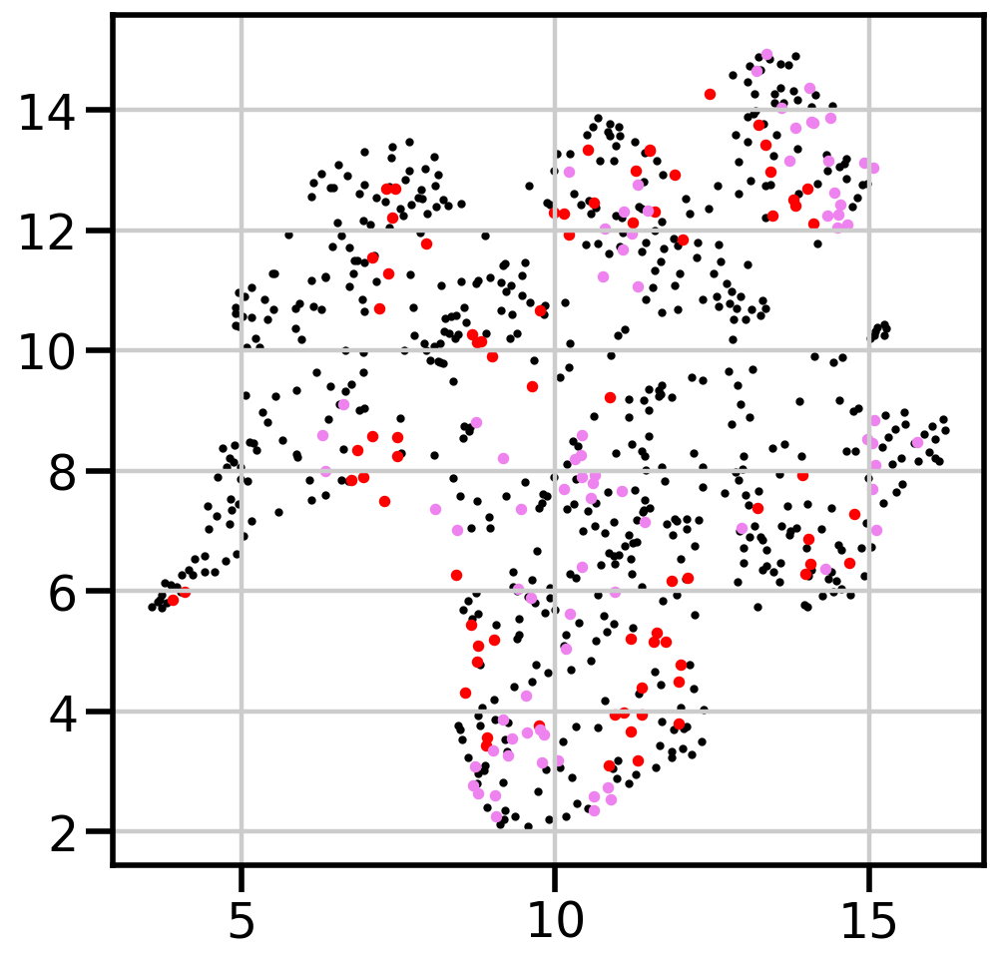

In [50]:
import matplotlib.pyplot as plt

figure, axes = plt.subplots()

#color =  x[:,index_array[0]]

ax = axes.scatter(adata.obsm['X_umap'][:,0],adata.obsm['X_umap'][:,1], s = 3, color = 'k')
index = np.where(stim == 1)[0]
ax = axes.scatter(adata.obsm['X_umap'][index,0],adata.obsm['X_umap'][index,1], s = 10, color = 'r')
index = np.where(stim == 2)[0]
ax = axes.scatter(adata.obsm['X_umap'][index,0],adata.obsm['X_umap'][index,1], s = 10, color = 'violet')

#figure.colorbar(ax=ax)

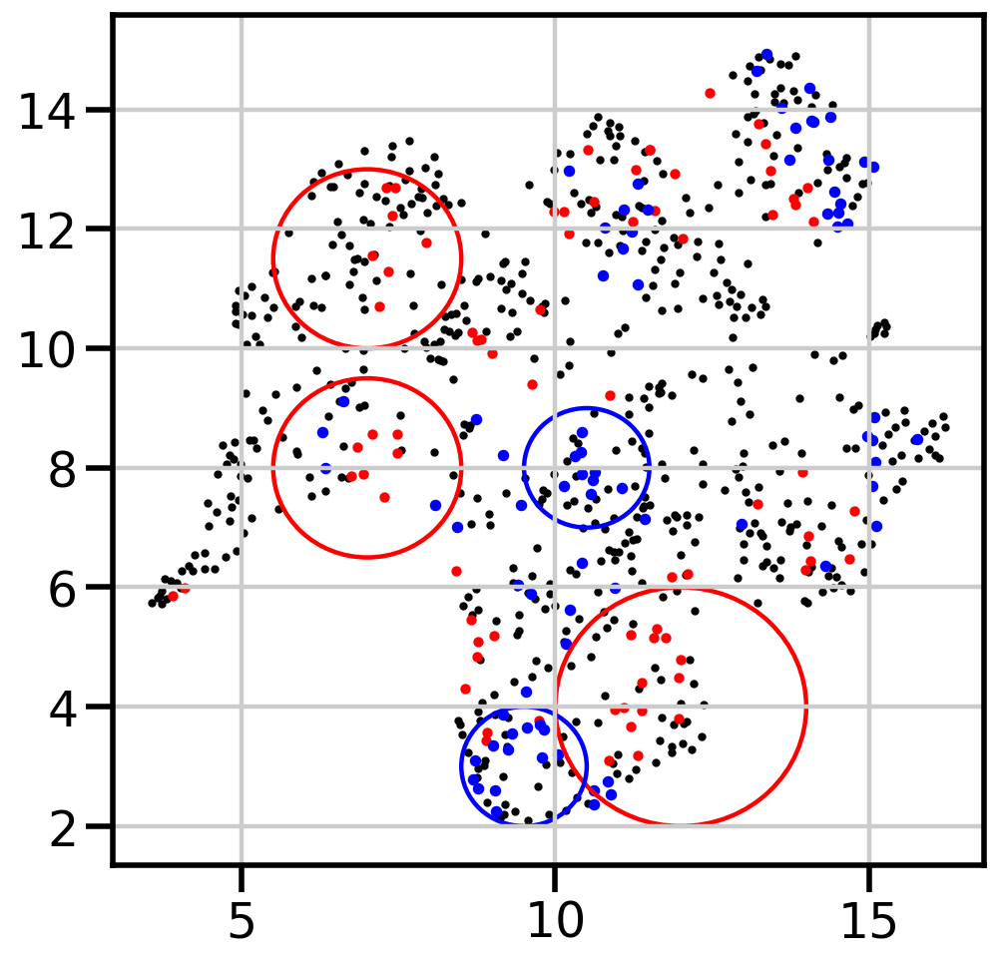

In [51]:
### Create fake stimuli cell pattens that correspond to some cells
# from pinch
center = np.zeros((5,2))
radius = np.zeros((5,))
center[0,0] = 7
center[0,1] = 11.5
radius[0] = 1.5
center[1,0] = 7
center[1,1] = 8
radius[1] = 1.5
center[2,0] = 12
center[2,1] = 4
radius[2] = 2
center[3,0] = 10.5
center[3,1] = 8
radius[3] = 1
center[4,0] = 9.5
center[4,1] = 3
radius[4] = 1.

figure, axes = plt.subplots()

#color =  x[:,index_array[0]]
circle1 = plt.Circle(center[0,:], radius[0], color='r', fill = False)
circle2 = plt.Circle(center[1,:], radius[1], color='r', fill = False)
circle3 = plt.Circle(center[2,:], radius[2], color='r', fill = False)
circle4 = plt.Circle(center[3,:], radius[3], color='b', fill = False)
circle5 = plt.Circle(center[4,:], radius[4], color='b', fill = False)

axes.scatter(adata.obsm['X_umap'][:,0],adata.obsm['X_umap'][:,1], s = 3, color = 'k')
index = np.where(stim == 1)[0]
axes.scatter(adata.obsm['X_umap'][index,0],adata.obsm['X_umap'][index,1], s = 7, color = 'r')
index = np.where(stim == 2)[0]
ax = axes.scatter(adata.obsm['X_umap'][index,0],adata.obsm['X_umap'][index,1], s = 10, color = 'b')

axes.add_patch(circle1)
axes.add_patch(circle2)
axes.add_patch(circle3)
axes.add_patch(circle4)
axes.add_patch(circle5)

figure.set_size_inches([7,7])
figure.savefig(figure_path + 'pinch_selection.png')

In [52]:
pinch_subsets = np.zeros((5,len(stim)))
for i in range(len(stim)):
    coordinate = adata.obsm['X_umap'][i,:]
    dist1 = np.linalg.norm(coordinate - center[0,:])
    dist2 = np.linalg.norm(coordinate - center[1,:])
    dist3 = np.linalg.norm(coordinate - center[2,:])
    dist4 = np.linalg.norm(coordinate - center[3,:])
    dist5 = np.linalg.norm(coordinate - center[4,:])
    if stim[i] == 1 and dist1 < radius[0]:
        pinch_subsets[0,i] = 1    
    if stim[i] == 1 and dist2 < radius[1]:
        pinch_subsets[1,i] = 1
    if stim[i] == 1 and dist3 < radius[2]:
        pinch_subsets[2,i] = 1
    if stim[i] == 2 and dist4 < radius[3]:
        pinch_subsets[3,i] = 1    
    if stim[i] == 2 and dist5 < radius[4]:
        pinch_subsets[4,i] = 1


In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import umap

scaled_data = StandardScaler().fit_transform(x)
scaled_data = (scaled_data.T - np.min(scaled_data, axis = 1))/ (np.max(scaled_data, axis = 1).reshape(-1) - np.min(scaled_data, axis = 1).reshape(-1))

scaled_data_cut = scaled_data.copy()
for i in range(scaled_data.shape[0]):
    low_expression = np.where(scaled_data_cut[i,:] < 0.1)[0]
    scaled_data_cut[i,low_expression] = 0

scaled_data_new = np.zeros((scaled_data.shape[0]+16,scaled_data.shape[1]))
scaled_data_new[0:scaled_data.shape[0],:] =scaled_data
campari_cells = np.where(stim>0)[0]
scaled_data_new[scaled_data.shape[0],campari_cells] = 1
for i in range(1,11):
    stim_cell = np.where(stim == i)[0]
    scaled_data_new[scaled_data.shape[0]+i,stim_cell] = 1
scaled_data_new[scaled_data.shape[0]+11,:] = pinch_subsets[0,:]
scaled_data_new[scaled_data.shape[0]+12,:] = pinch_subsets[1,:]
scaled_data_new[scaled_data.shape[0]+13,:] = pinch_subsets[2,:]
scaled_data_new[scaled_data.shape[0]+14,:] = pinch_subsets[3,:]
scaled_data_new[scaled_data.shape[0]+15,:] = pinch_subsets[4,:]

scaled_data_cut_new = np.zeros((scaled_data.shape[0]+16,scaled_data.shape[1]))
scaled_data_cut_new[0:scaled_data.shape[0],:] =scaled_data_cut
campari_cells = np.where(stim>0)[0]
scaled_data_cut_new[scaled_data.shape[0],campari_cells] = 1
for i in range(1,11):
    stim_cell = np.where(stim == i)[0]
    scaled_data_cut_new[scaled_data.shape[0]+i,stim_cell] = 1
scaled_data_cut_new[scaled_data.shape[0]+11,:] = pinch_subsets[0,:]
scaled_data_cut_new[scaled_data.shape[0]+12,:] = pinch_subsets[1,:]
scaled_data_cut_new[scaled_data.shape[0]+13,:] = pinch_subsets[2,:]
scaled_data_cut_new[scaled_data.shape[0]+14,:] = pinch_subsets[3,:]
scaled_data_cut_new[scaled_data.shape[0]+15,:] = pinch_subsets[4,:]

    
number_of_components = 20
pca1 = PCA(number_of_components)
pca1.fit(scaled_data)
pca_embedding = pca1.transform(scaled_data_new)

reducer = umap.UMAP(n_components = 2)
umap_embedding = reducer.fit_transform(pca_embedding)

pca1.fit(scaled_data_cut)
pca_embedding = pca1.transform(scaled_data_cut_new)

reducer = umap.UMAP(n_components = 2)
umap_embedding_cut = reducer.fit_transform(pca_embedding)

ValueError: could not broadcast input array from shape (15,) into shape (10,)

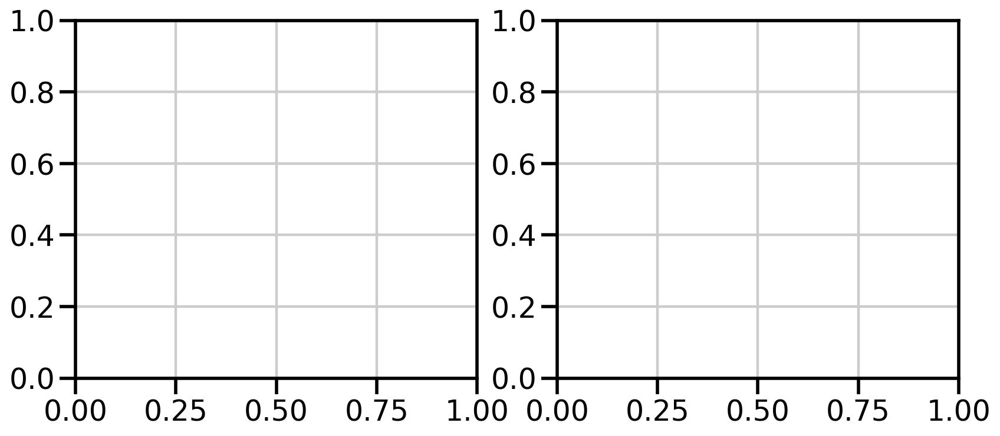

In [71]:
figure_path = '/home/melma31/Documents/single_cell_sequencing/figures/'

rcParams['figure.figsize']=(12,5)
figure, axes = plt.subplots(1,2)
expression_count = np.zeros((scaled_data.shape[0]+11,))
expression_count[:scaled_data.shape[0]] = np.sum(x.T,axis = 1)
expression_count[scaled_data.shape[0]:-1] = np.sum(scaled_data_new[scaled_data.shape[0]:-1,:],axis=1)

axes[0].scatter(umap_embedding[:,0],umap_embedding[:,1], s= 1,alpha = 0.3, c = np.log(expression_count), cmap = 'rainbow')
axes[0].grid(False)
axes[1].scatter(umap_embedding_cut[:,0],umap_embedding_cut[:,1], s= 1,alpha = 0.3, c = np.log(expression_count), cmap = 'rainbow')
axes[1].grid(False)

axes[0].set_title('Normalization')
axes[1].set_title('Normalizarion + threshold')
figure.savefig(figure_path + 'genes_umap_expression_normed_campari.png')

In [71]:
gene_name = []
for i in range(len(adata.var['gene_name'])):
    gene_name.append(adata.var['gene_name'].iloc[i])

gene_name.append('Campari')
for i in range(1,11):
    gene_name.append(labels[i])
gene_name.append('pinch1')
gene_name.append('pinch2')
gene_name.append('pinch3')
gene_name.append('stroke1')
gene_name.append('stroke2')
    

marker_genes = ['Ntrk2','Cd34','Nppb','Mrgprb4','Mrgpra3','Mrgprd','Sstr2','Adra2a','Smr2',
                'Bmpr1b','Nefh','Pvalb','Adm',
                'Trpm3','Piezo2','Trpm2','Smr2','Sstr2','Bmpr1b','Trpm8','Trpv1','Piezo2','Piezo1','Nppb',
                'Sst','Pvalb','Prokr2','Mrgprd','Mrgpra3','Cd34',
                'Th','Trpa1','Ntrk3','Ntrk2','Ntrk1','Ret','Tac1','Calca','Calcb','Nefh',
                'S100b','Scn10a','Slc17a8','Atf3','Pou4f3','Calb1','Avil','Asic3',
                'Asic2','Asic1','Pou6f2','Avpr1a','Pou4f2','Sox10','Chrna7','Chrna3',
                'P2rx3','Gfra2','Ldhb','Necab2','Spp1','Adra2a','Chrna7','Tafa4','Campari',
                'pinch','new_stroke','ballon','AG','AD','heating','mock','old_stroke','anal_pinch','mockw__poop',
               'pinch1','pinch2','pinch3','stroke1','stroke2']

marker_position = np.zeros((len(marker_genes),))
count = 0
for marker in  marker_genes:
    index = gene_name.index(marker)
    marker_position[count] = index
    count = count+1

n = 20
nearest_neighbors = np.zeros((n, len(marker_genes)))
nearest_neighbors_distance = np.zeros((n, len(marker_genes)))
auxiliar_distance = np.zeros((umap_embedding.shape[0]))

nearest_neighbors_cut = np.zeros((n, len(marker_genes)))
nearest_neighbors_distance_cut = np.zeros((n, len(marker_genes)))
auxiliar_distance_cut = np.zeros((umap_embedding.shape[0]))

for i in range(len(marker_genes)):
    a = umap_embedding[int(marker_position[i]),:]
    a_cut = umap_embedding_cut[int(marker_position[i]),:]
    #a = x.T[int(marker_position[i]),:]
    for j in range(umap_embedding.shape[0]):
        b = umap_embedding[j,:]
        b_cut = umap_embedding_cut[j,:]
        #b = x.T[j,:]
        dist = np.linalg.norm(a-b)
        dist_cut = np.linalg.norm(a_cut-b_cut)
        auxiliar_distance[j] = dist
        auxiliar_distance_cut[j] = dist_cut
    sorted_arguments = np.argsort(auxiliar_distance)
    nearest_neighbors_distance[:,i] = auxiliar_distance[sorted_arguments[0:n]]
    nearest_neighbors[:,i] = sorted_arguments[0:n].astype(int)
    
    sorted_arguments_cut = np.argsort(auxiliar_distance_cut)
    nearest_neighbors_distance_cut[:,i] = auxiliar_distance_cut[sorted_arguments[0:n]]
    nearest_neighbors_cut[:,i] = sorted_arguments_cut[0:n].astype(int)
    
    
closest_genes = []
closest_genes_cut = []
for i in range(len(marker_genes)):
    closest_genes_ = []
    closest_genes_cut_ = []
    for j in range(n):
        closest_genes_.append(gene_name[int(nearest_neighbors[j,i])])
        closest_genes_cut_.append(gene_name[int(nearest_neighbors_cut[j,i])])
    closest_genes.append(closest_genes_)
    closest_genes_cut.append(closest_genes_cut_)
 

In [ ]:
data = {'umap_embedding_norm': umap_embedding,'umap_embedding_cut' : umap_embedding,'genes': gene_name}
scipy.io.savemat(figure_path + 'genes_umap.mat', data)    
    

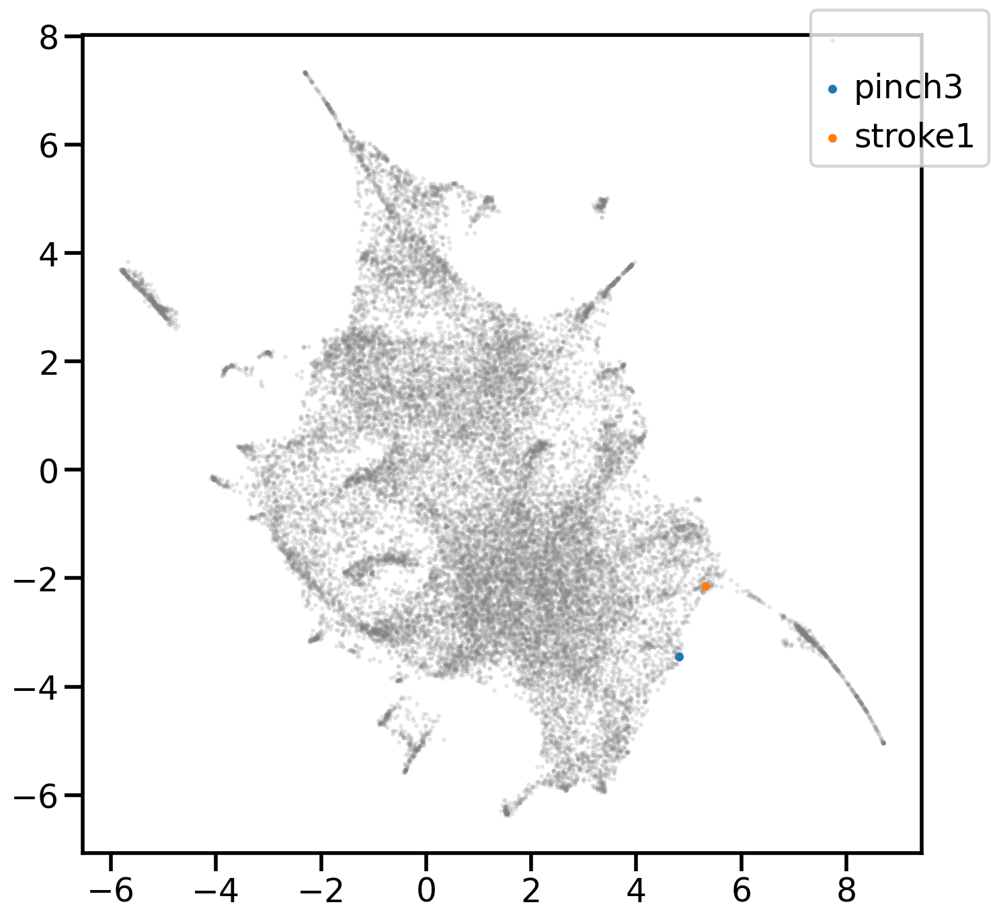

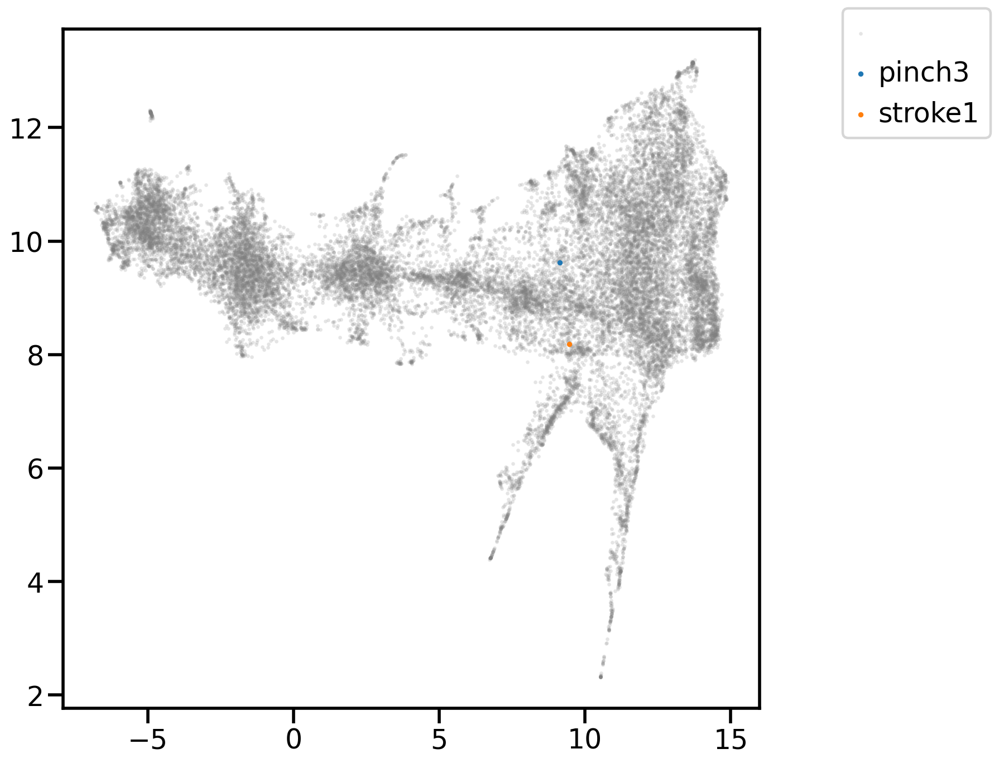

In [61]:
rcParams['figure.figsize']=(10,10)
figure, axes = plt.subplots()

axes.scatter(umap_embedding[:,0],umap_embedding[:,1], s= 1, c = 'gray', alpha = 0.2)
marker_genes_plotting = ['Campari','pinch','new_stroke','ballon','AG','AD','heating','mock',
                         'old_stroke','anal_pinch','mockw__poop',
                        'pinch1','pinch2','pinch3', 'stroke1','stroke2']

marker_genes_plotting = ['Ntrk2','Cd34','Nppb','Mrgprb4','Mrgpra3','Mrgprd','Sstr2','Adra2a','Smr2',
                'Bmpr1b','Nefh','Pvalb']


marker_genes_plotting = ['pinch3', 'stroke1']

for interesting_gene in marker_genes_plotting:
    index = marker_genes.index(interesting_gene)
    closest_genes_for_this = closest_genes[index]
    #axes.scatter(umap_embedding[nearest_neighbors[1:,index].astype(int),0],umap_embedding[nearest_neighbors[1:,index].astype(int),1], s= 1, c = 'k')
    axes.scatter(umap_embedding[nearest_neighbors[0,index].astype(int),0],umap_embedding[nearest_neighbors[0,index].astype(int),1], s= 15)
    #axes.annotate(interesting_gene, (umap_embedding[nearest_neighbors[0,index].astype(int),0], umap_embedding[nearest_neighbors[0,index].astype(int),1]),fontsize = 12, color= 'k')
axes.grid(False)
#axes.legend(['','Campari','pinch','new_stroke','ballon','AG','AD','heating','mock',
#             'old_stroke','anal_pinch','mockw__poop','pinch1','pinch2','pinch3', 'stroke1','stroke2'],bbox_to_anchor=(1.1, 1.05))

#axes.legend(['','Ntrk2','Cd34','Nppb','Mrgprb4','Mrgpra3','Mrgprd','Sstr2','Adra2a','Smr2',
#                'Bmpr1b','Nefh','Pvalb'],bbox_to_anchor=(1.1, 1.05))

axes.legend(['','pinch3','stroke1'],bbox_to_anchor=(1.1, 1.05))

    
figure.savefig(figure_path + 'genes_umap_norm_selected_stim.png')
#rcParams['figure.figsize']=(12,12)
figure, axes = plt.subplots()

axes.scatter(umap_embedding_cut[:,0],umap_embedding_cut[:,1], s= 1, c = 'gray', alpha = 0.2)

for interesting_gene in marker_genes_plotting:
    index = marker_genes.index(interesting_gene)
    closest_genes_for_this = closest_genes_cut[index]
    #axes.scatter(umap_embedding_cut[nearest_neighbors_cut[1:,index].astype(int),0],umap_embedding_cut[nearest_neighbors_cut[1:,index].astype(int),1], s= 1, c = 'k')
    axes.scatter(umap_embedding_cut[nearest_neighbors_cut[0,index].astype(int),0],umap_embedding_cut[nearest_neighbors_cut[0,index].astype(int),1], s= 5)
    #axes.annotate(interesting_gene, (umap_embedding_cut[nearest_neighbors_cut[0,index].astype(int),0], umap_embedding_cut[nearest_neighbors_cut[0,index].astype(int),1]),fontsize = 12, color= 'k')
axes.grid(False)
#axes.legend(['','Campari','pinch','new_stroke','ballon','AG','AD','heating','mock',
#             'old_stroke','anal_pinch','mockw__poop','pinch1','pinch2','pinch3', 'stroke1','stroke2'],bbox_to_anchor=(1.1, 1.05))


#axes.legend(['','Ntrk2','Cd34','Nppb','Mrgprb4','Mrgpra3','Mrgprd','Sstr2','Adra2a','Smr2',
#                'Bmpr1b','Nefh','Pvalb'],bbox_to_anchor=(1.1, 1.05))

axes.legend(['','pinch3','stroke1'],bbox_to_anchor=(1.1, 1.05))

figure.savefig(figure_path + 'genes_umap_normcut_selected_stim.png')

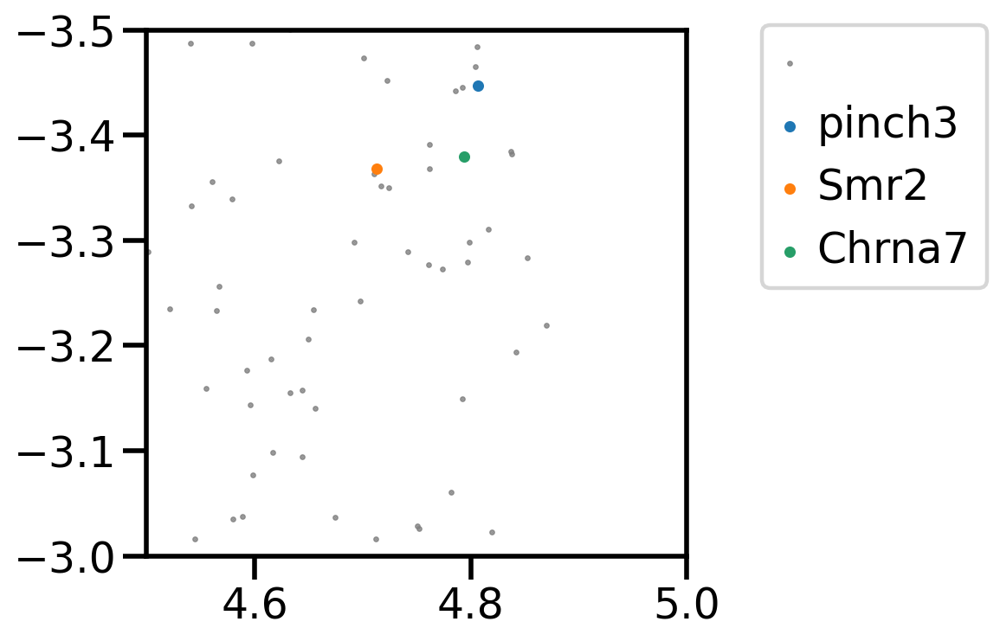

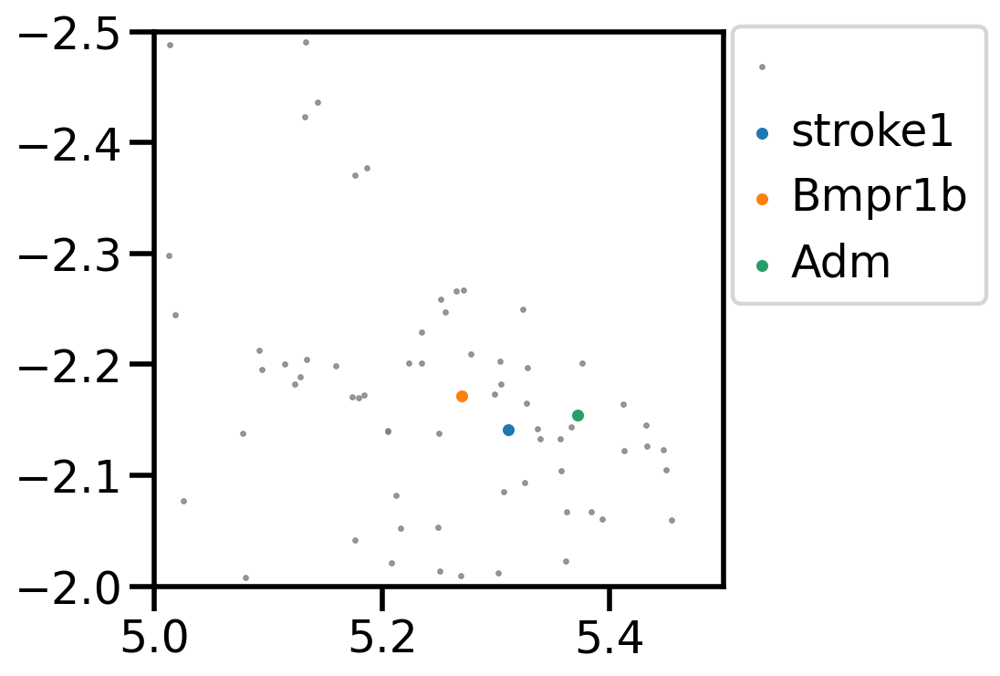

In [77]:
rcParams['figure.figsize']=(5,5)
figure, axes = plt.subplots()

axes.scatter(umap_embedding[:,0],umap_embedding[:,1], s= 1, c = 'gray', alpha = 0.9)
marker_genes_plotting = ['pinch3','Smr2','Chrna7']

for interesting_gene in marker_genes_plotting:
    index = marker_genes.index(interesting_gene)
    closest_genes_for_this = closest_genes[index]
    #axes.scatter(umap_embedding[nearest_neighbors[1:,index].astype(int),0],umap_embedding[nearest_neighbors[1:,index].astype(int),1], s= 1, c = 'k')
    axes.scatter(umap_embedding[nearest_neighbors[0,index].astype(int),0],umap_embedding[nearest_neighbors[0,index].astype(int),1], s= 15)
    #axes.annotate(interesting_gene, (umap_embedding[nearest_neighbors[0,index].astype(int),0], umap_embedding[nearest_neighbors[0,index].astype(int),1]),fontsize = 12, color= 'k')
axes.grid(False)
#axes.legend(['','Campari','pinch','new_stroke','ballon','AG','AD','heating','mock',
#             'old_stroke','anal_pinch','mockw__poop','pinch1','pinch2','pinch3', 'stroke1','stroke2'],bbox_to_anchor=(1.1, 1.05))

#axes.legend(['','Ntrk2','Cd34','Nppb','Mrgprb4','Mrgpra3','Mrgprd','Sstr2','Adra2a','Smr2',
#                'Bmpr1b','Nefh','Pvalb'],bbox_to_anchor=(1.1, 1.05))

axes.legend(['','pinch3','Smr2','Chrna7'],bbox_to_anchor=(1.1, 1.05))
axes.set_ylim([-3,-3.5])
axes.set_xlim([4.5,5])

    
figure.savefig(figure_path + 'genes_umap_norm_selected_stim_zoom_pinch3.png')

rcParams['figure.figsize']=(5,5)
figure, axes = plt.subplots()

axes.scatter(umap_embedding[:,0],umap_embedding[:,1], s= 1, c = 'gray', alpha = 0.9)
marker_genes_plotting = ['stroke1','Bmpr1b','Adm']

for interesting_gene in marker_genes_plotting:
    index = marker_genes.index(interesting_gene)
    closest_genes_for_this = closest_genes[index]
    #axes.scatter(umap_embedding[nearest_neighbors[1:,index].astype(int),0],umap_embedding[nearest_neighbors[1:,index].astype(int),1], s= 1, c = 'k')
    axes.scatter(umap_embedding[nearest_neighbors[0,index].astype(int),0],umap_embedding[nearest_neighbors[0,index].astype(int),1], s= 15)
    #axes.annotate(interesting_gene, (umap_embedding[nearest_neighbors[0,index].astype(int),0], umap_embedding[nearest_neighbors[0,index].astype(int),1]),fontsize = 12, color= 'k')
axes.grid(False)
#axes.legend(['','Campari','pinch','new_stroke','ballon','AG','AD','heating','mock',
#             'old_stroke','anal_pinch','mockw__poop','pinch1','pinch2','pinch3', 'stroke1','stroke2'],bbox_to_anchor=(1.1, 1.05))

#axes.legend(['','Ntrk2','Cd34','Nppb','Mrgprb4','Mrgpra3','Mrgprd','Sstr2','Adra2a','Smr2',
#                'Bmpr1b','Nefh','Pvalb'],bbox_to_anchor=(1.1, 1.05))

axes.legend(['','stroke1','Bmpr1b','Adm'],bbox_to_anchor=(1.5, 1.05))
axes.set_ylim([-2,-2.5])
axes.set_xlim([5,5.5])

    
figure.savefig(figure_path + 'genes_umap_norm_selected_stim_zoom_stroke1.png')

In [89]:
### compute pair of distance 
index1 = marker_genes.index('pinch3')
index2 = marker_genes.index('Smr2')
a = umap_embedding[int(index1),:]
a_= x.T[int(index1),:]

b = umap_embedding[int(index2),:]
b_= x.T[int(index2),:]

dist = np.linalg.norm(a-b)
dist_ = np.linalg.norm(a_-b_)
print('Umap dist Pinch3-Smr2:',dist)
print('Expression dist Pinch3-Smr2',dist_)

index2 = marker_genes.index('Chrna7')
a = umap_embedding[int(index1),:]
a_= x.T[int(index1),:]

b = umap_embedding[int(index2),:]
b_= x.T[int(index2),:]

dist = np.linalg.norm(a-b)
dist_ = np.linalg.norm(a_-b_)
print('Umap dist Pinch3-Chrna7:',dist)
print('Expression dist Pinch3-Chrna7',dist_)


### compute pair of distance 
index1 = marker_genes.index('stroke1')
index2 = marker_genes.index('Bmpr1b')
a = umap_embedding[int(index1),:]
a_= x.T[int(index1),:]

b = umap_embedding[int(index2),:]
b_= x.T[int(index2),:]

dist = np.linalg.norm(a-b)
dist_ = np.linalg.norm(a_-b_)

print('Umap dist Stroke1-Bmpr1b:',dist)
print('Expression dist Stroke1-Bmpr1b',dist_)

index2 = marker_genes.index('Adm')
a = umap_embedding[int(index1),:]
a_= x.T[int(index1),:]

b = umap_embedding[int(index2),:]
b_= x.T[int(index2),:]

dist = np.linalg.norm(a-b)
dist_ = np.linalg.norm(a_-b_)

print('Umap dist Stroke1-Adm:',dist)
print('Expression dist Stroke1-Adm',dist_)


Umap dist Pinch3-Smr2: 2.752631
Expression dist Pinch3-Smr2 0.45476767
Umap dist Pinch3-Chrna7: 1.8581619
Expression dist Pinch3-Chrna7 1.3500068
Umap dist Stroke1-Bmpr1b: 3.863747
Expression dist Stroke1-Bmpr1b 1.9957014
Umap dist Stroke1-Adm: 4.156914
Expression dist Stroke1-Adm 26.557589


In [75]:
#spike = np.where(umap_embedding[:,1] < -5)[0]
#spike = np.logical_and(umap_embedding[:,0] > 0,umap_embedding[:,1] < -6)
#spike = np.where(spike == True)[0]
#print(spike)
#spike_list = []
#for i in range(len(spike)):
#    spike_list.append(gene_name[spike[i]])   
#print(spike_list)

In [59]:
interesting_gene = 'pinch3'

def intersection(lst1, lst2):
    return list(set(lst1) & set(lst2))

def complement_intersection(list1,list2):
    non_intersection = list(set(list1) ^ set(list2))
    return non_intersection

index = marker_genes.index(interesting_gene)
closest_genes_for_this = closest_genes[index]
closest_genes_for_this_cut = closest_genes_cut[index]

print('Normalization:', closest_genes_for_this)
#print('Distance Normalization:', nearest_neighbors_distance[:,index])
print('Normalization + cut:' , closest_genes_for_this_cut)
#print('Distance Normalization + cut:', nearest_neighbors_distance_cut[:,index])
intersection_genes = intersection(closest_genes_for_this,closest_genes_for_this_cut)
complement_genes = complement_intersection(closest_genes_for_this,closest_genes_for_this_cut)
print('Intersection:' , intersection_genes)
print('Complement:' , complement_genes)

#print(len(complement_genes))

#ginty_list = ['Smr2', 'Oprk1', 'L3mbtl4', 'Calml4', 'Tlr4', 'Naip1', 'Kcnv1', 'Syndig1l', 'Ptk2b', 'Cldn9', 'Agpat2', 'Kif26a', 'Traf3ip3', 'AI427809', 'Abcg2', 'Grb10', 'Chrm2', 'Grm5', '2610305D13Rik', 'A230087F16Rik']
#intersection_ginty = intersection(closest_genes_for_this,ginty_list)

#print('Ginty List:', ginty_list)
#print('Ginty Intersection:' ,intersection_ginty)

#print(closest_genes_for_this)


Normalization: ['pinch3', 'pinch', 'Cplx2', 'Pcp4l1', 'Cgnl1', 'Asic3', 'Chrna7', 'Creg2', 'Rbfox3', 'Chp2', 'Olfml3', 'Brms1l', 'Kcne1l', 'Smr2', 'Calm1', 'Gm20939', 'Scn4a', 'Gng8', 'Calml4', 'Ly6h']
Normalization + cut: ['pinch3', 'Brip1', 'Scn3a', 'Kcnv1', 'Ptk2b', 'Chp2', 'Hrh3', 'Cdkn3', 'Scn4a', 'Pcp4l1', 'Creg2', 'Sgcz', 'Tiam1', 'Strip2', 'Gng8', 'Rps6ka1', 'Map3k21', 'Tspear', 'Mansc1', 'Tinagl1']
Intersection: ['Creg2', 'Gng8', 'Scn4a', 'pinch3', 'Pcp4l1', 'Chp2']
Complement: ['Tinagl1', 'Brms1l', 'pinch', 'Olfml3', 'Kcne1l', 'Calml4', 'Rbfox3', 'Map3k21', 'Mansc1', 'Ly6h', 'Smr2', 'Brip1', 'Sgcz', 'Tiam1', 'Cplx2', 'Gm20939', 'Chrna7', 'Ptk2b', 'Calm1', 'Cdkn3', 'Scn3a', 'Hrh3', 'Asic3', 'Tspear', 'Strip2', 'Cgnl1', 'Rps6ka1', 'Kcnv1']


In [60]:
interesting_gene = 'Campari'
index = marker_genes.index(interesting_gene)
closest_genes_for_this = closest_genes[index]
closest_genes_for_this_cut = closest_genes_cut[index]
print('Nearby Genes ' + 'Campari' + ':' , closest_genes_for_this)
#print('Distance Normalization:', nearest_neighbors_distance[:,index])

for i in range(0,len(marker_genes_plotting)):

    interesting_gene = marker_genes_plotting[i]

    index = marker_genes.index(interesting_gene)
    closest_genes_for_this = closest_genes[index]
    closest_genes_for_this_cut = closest_genes_cut[index]
    
    intersection_genes = intersection(closest_genes_for_this,closest_genes_for_this_cut)
    complement_genes = complement_intersection(closest_genes_for_this,closest_genes_for_this_cut)


    print('Nearby Norm ' + marker_genes_plotting[i] + ':' , closest_genes_for_this)
    print('Nearby Norm+Cut ' + marker_genes_plotting[i] + ':' , closest_genes_for_this)
    print('Intersect:', intersection_genes )
    #print('Distance Normalization:', nearest_neighbors_distance[:,index])



Nearby Genes Campari: ['Campari', 'new_stroke', 'Spon1', 'Sox2ot', 'Alpl', 'Per3', 'Gm7308', 'Ubc', 'Dhrs2', 'Egr3', 'Gm14480', 'Ccn1', 'Mitf', 'Mafk', 'Tril', 'Slc3a2', 'Heyl', 'Tcf12', 'Prdx6', 'Rab20']
Nearby Norm Ntrk2: ['Ntrk2', 'Rom1', 'Aldh1l1', 'Sema5b', 'Slc6a19', 'Pbx3', 'Baiap2l1', 'Cadps2', 'Tbx3os2', 'Ldb3', 'Prcd', 'Lhfpl2', 'Slc24a3', 'Tafa3', 'Tbx3', 'Skor2', 'Tmem184c', 'Tmem28', 'Colq', 'Twf2']
Nearby Norm+Cut Ntrk2: ['Ntrk2', 'Rom1', 'Aldh1l1', 'Sema5b', 'Slc6a19', 'Pbx3', 'Baiap2l1', 'Cadps2', 'Tbx3os2', 'Ldb3', 'Prcd', 'Lhfpl2', 'Slc24a3', 'Tafa3', 'Tbx3', 'Skor2', 'Tmem184c', 'Tmem28', 'Colq', 'Twf2']
Intersect: ['Slc24a3', 'Ntrk2', 'Lhfpl2', 'Tmem28']
Nearby Norm Cd34: ['Cd34', 'D130079A08Rik', 'Itpkb', 'Cdh9', 'Tafa4', 'Wfdc2', 'Th', 'Ighg2c', 'Gm7271', 'Slc51a', 'Tmem132e', 'Spink2', 'Cacna1i', 'Gm14317', 'Rnf112', 'Gm37515', 'Pde1b', 'Kcnd3', 'Iqcg', 'Bmp15']
Nearby Norm+Cut Cd34: ['Cd34', 'D130079A08Rik', 'Itpkb', 'Cdh9', 'Tafa4', 'Wfdc2', 'Th', 'Ighg2c', 'Gm

In [ ]:
interesting_gene = 'Campari'

rcParams['figure.figsize']=(15,8)
figure, axes = plt.subplots(1,2)

axes[0].scatter(umap_embedding[:,0],umap_embedding[:,1], s= 1, c = 'gray', alpha = 0.2)
axes[1].scatter(umap_embedding_cut[:,0],umap_embedding_cut[:,1], s= 1, c = 'gray', alpha = 0.2)

index = marker_genes.index(interesting_gene)
closest_genes_for_this = closest_genes[index]
axes[0].scatter(umap_embedding[nearest_neighbors[1:,index].astype(int),0],umap_embedding[nearest_neighbors[1:,index].astype(int),1], s= 10, c = 'k')
axes[0].scatter(umap_embedding[nearest_neighbors[0,index].astype(int),0],umap_embedding[nearest_neighbors[0,index].astype(int),1], s= 5)
axes[0].annotate(interesting_gene, (umap_embedding[nearest_neighbors[0,index].astype(int),0], umap_embedding[nearest_neighbors[0,index].astype(int),1]),fontsize = 10)
closest_genes_for_this_cut = closest_genes_cut[index]
axes[1].scatter(umap_embedding_cut[nearest_neighbors_cut[1:,index].astype(int),0],umap_embedding_cut[nearest_neighbors_cut[1:,index].astype(int),1], s= 10, c = 'k')
axes[1].scatter(umap_embedding_cut[nearest_neighbors_cut[0,index].astype(int),0],umap_embedding_cut[nearest_neighbors_cut[0,index].astype(int),1], s= 5)
axes[1].annotate(interesting_gene, (umap_embedding_cut[nearest_neighbors_cut[0,index].astype(int),0], umap_embedding_cut[nearest_neighbors_cut[0,index].astype(int),1]),fontsize = 10)

axes[0].grid(False)
axes[1].grid(False)

figure.savefig(figure_path + 'genes_umap_'+interesting_gene+'.png')

In [ ]:
#rcParams['figure.figsize']=(7,7)
#np.in1d(closest_genes_for_this, adata.var_names)
#for gene in closest_genes_for_this:
#    sc.pl.umap(adata=adata, color=gene, use_raw=False, cmap = 'rainbow',save = 'UMIs/expression_closest_genes/genes_' + gene + '.png', size = 80)